In [312]:
# importation des librairies
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [313]:
# chargement des donnees
data = pd.read_csv("Medical cost.csv")
data.head()

,age,sex,bmi,children,smoker,region,charges
0,19.0,female,27.900,0.0,yes,southwest,16884.92400
1,18.0,male,33.770,1.0,no,southeast,1725.55230
2,28.0,male,33.000,3.0,no,southeast,4449.46200
3,33.0,male,22.705,0.0,no,northwest,21984.47061
4,32.0,male,28.880,0.0,no,northwest,3866.85520


# Previsualisation des donnees

In [314]:
# control des lignes dupliquees
data[data.duplicated()]

,age,sex,bmi,children,smoker,region,charges
581,19.0,male,30.59,0.0,no,northwest,1639.5631


In [315]:
# supression des lignes dupliquees
data = data.drop_duplicates(keep="first")

In [316]:
# taille du jeu de donnees
data.shape

(1337, 7)

In [317]:
# control du type des colonnees
data.dtypes

age         float64
sex          object
bmi         float64
children    float64
smoker       object
region       object
charges     float64
dtype: object

In [318]:
# sommaire des donnees
data.describe()

,age,bmi,children,charges
count,1328.000000,1331.000000,1330.000000,1337.000000
mean,39.261295,30.654850,1.093985,13279.121487
std,14.020610,6.100534,1.204847,12110.359656
min,18.000000,15.960000,0.000000,1121.873900
25%,27.000000,26.267500,0.000000,4746.344000
50%,39.000000,30.360000,1.000000,9386.161300
75%,51.000000,34.687500,2.000000,16657.717450
max,64.000000,53.130000,5.000000,63770.428010


In [319]:
# liste des colonnees
data.columns

Index(['age', 'sex', 'bmi', 'children', 'smoker', 'region', 'charges'], dtype='object')

#

# Preprocessing

## gestion des donnees manquantes

In [320]:
# control des donnees manquantes
data.isna().sum()

age         9
sex         0
bmi         6
children    7
smoker      0
region      0
charges     0
dtype: int64

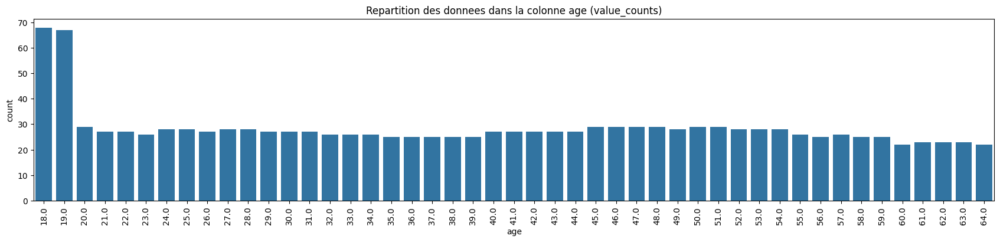

In [321]:
## gestion de la colonne : age
# control de l'etat de la colonne age
plt.figure(figsize=(21,4))
plt.title("Repartition des donnees dans la colonne age (value_counts)")
sns.countplot(data=data, x="age")
plt.xticks(rotation=90)
plt.show()

In [322]:
# control de la moyenne et de la mediane
print(f"Moyenne de la colonne age : {data.age.mean()} , Mediane de la colonne age : {data.age.median()}")

Moyenne de la colonne age : 39.26129518072289 , Mediane de la colonne age : 39.0


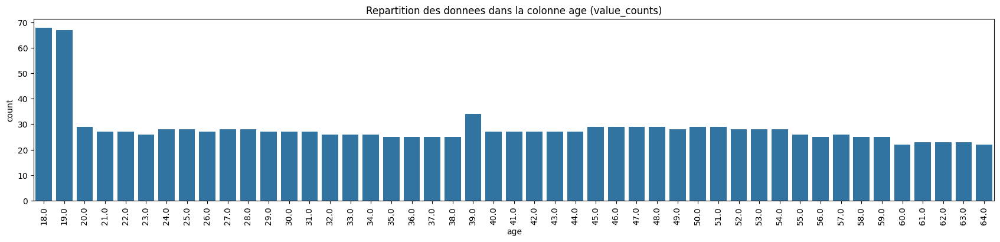

In [323]:
# ramener les valeurs manquantes a la mediane
data.age = data.age.fillna(data.age.median())

# visualisation
plt.figure(figsize=(21,4))
plt.title("Repartition des donnees dans la colonne age (value_counts)")
sns.countplot(data=data, x="age")
plt.xticks(rotation=90)
plt.show()

In [324]:
## gestion de la colonne : bmi
# control de la colonne bmi
dict(data.bmi.value_counts())

{32.3: 13,
 28.31: 9,
 34.1: 8,
 28.88: 8,
 30.8: 8,
 31.35: 8,
 30.495: 8,
 30.875: 8,
 27.36: 7,
 24.32: 7,
 27.645: 7,
 32.775: 7,
 32.11: 7,
 38.06: 7,
 33.33: 7,
 25.46: 7,
 34.8: 7,
 25.8: 7,
 35.2: 7,
 27.5: 6,
 35.53: 6,
 30.59: 6,
 26.41: 6,
 25.175: 6,
 28.595: 6,
 37.1: 6,
 27.74: 6,
 29.92: 6,
 33.63: 6,
 29.83: 6,
 30.115: 6,
 19.95: 6,
 31.73: 6,
 26.6: 6,
 33.0: 6,
 30.2: 6,
 23.655: 5,
 26.03: 5,
 26.695: 5,
 28.5: 5,
 23.21: 5,
 22.515: 5,
 33.155: 5,
 27.835: 5,
 23.18: 5,
 26.315: 5,
 29.7: 5,
 27.6: 5,
 28.785: 5,
 28.975: 5,
 30.4: 5,
 32.395: 5,
 33.345: 5,
 31.92: 5,
 36.85: 5,
 29.64: 5,
 25.3: 5,
 34.2: 5,
 28.025: 5,
 28.7: 5,
 25.08: 5,
 31.825: 5,
 33.66: 5,
 28.9: 5,
 24.7: 4,
 26.22: 4,
 32.68: 4,
 29.6: 4,
 31.065: 4,
 25.74: 4,
 33.44: 4,
 33.82: 4,
 25.84: 4,
 27.55: 4,
 31.79: 4,
 28.12: 4,
 29.735: 4,
 24.13: 4,
 27.83: 4,
 29.8: 4,
 28.215: 4,
 30.78: 4,
 22.61: 4,
 33.915: 4,
 31.13: 4,
 21.85: 4,
 27.1: 4,
 27.72: 4,
 36.3: 4,
 36.67: 4,
 35.625: 4

In [325]:
# remplacement par la moyenne
data.bmi = data.bmi.fillna(data.bmi.mean())

In [326]:
## gestion de la colonne : children
data.children.value_counts()

children
0.0    571
1.0    322
2.0    238
3.0    157
4.0     24
5.0     18
Name: count, dtype: int64

In [327]:
# remplacement des donnees manquantes par le mode
data.children = data.children.fillna(data.children.mode()[0]) # 0.0

In [328]:
# control finale
data.isna().sum()

age         0
sex         0
bmi         0
children    0
smoker      0
region      0
charges     0
dtype: int64

## Gestion des outlayers

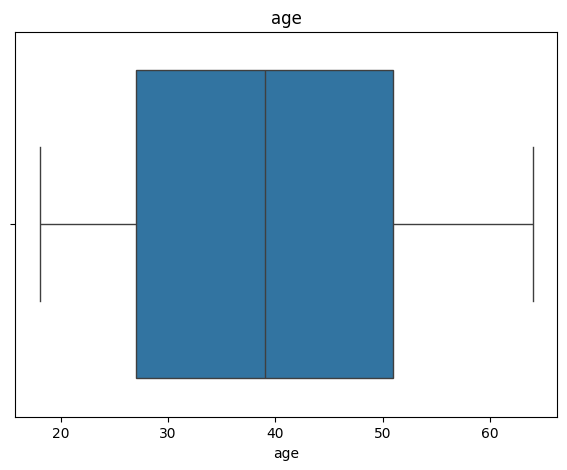

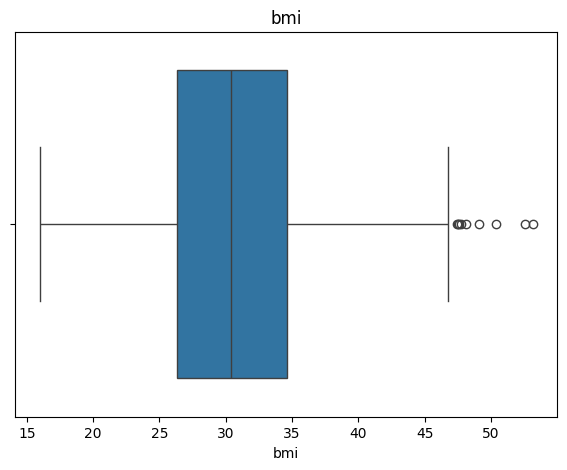

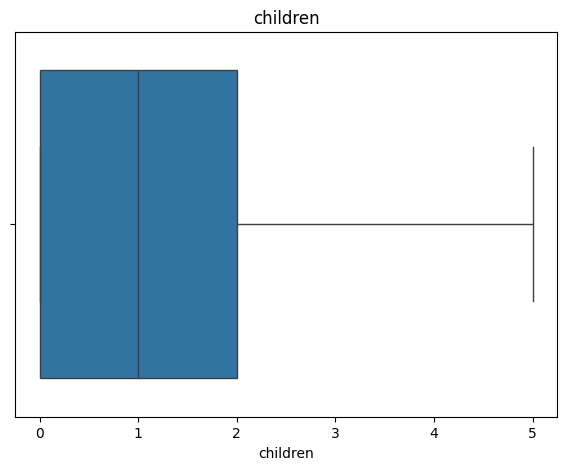

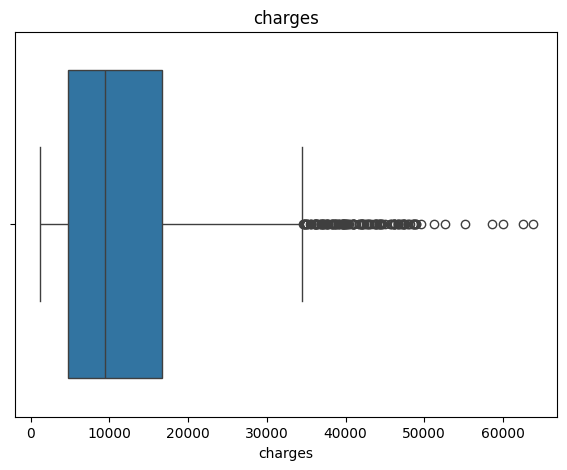

In [329]:
# control des outlayers
for i in list(data.select_dtypes(include=['int64', 'float64']).columns) : # liste des colonne numeriques
    plt.figure(figsize=(7,5))
    sns.boxplot(data=data, x=f"{i}")
    plt.title(f"{i}")
    plt.show()

In [330]:
## FONCTION DE DETERMINATION DES OUTLAYERS : METHODES "IGR" ##
def detect_outliers_iqr(column_name):
    Q1 = data[column_name].quantile(0.25)
    Q3 = data[column_name].quantile(0.75)
    IQR = Q3 - Q1
    
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    outliers = data[(data[column_name] < lower_bound) | (data[column_name] > upper_bound)]
    outlier_rate = (len(outliers) / len(data)) * 100
    
    print(f"Analysis for {column_name}:")
    print(f"Lower bound: {lower_bound:.2f}")
    print(f"Upper bound: {upper_bound:.2f}")
    print(f"Number of outliers: {len(outliers)}")
    print(f"Percentage of outliers: {outlier_rate:.2f}%")

In [331]:
# application a la colonne bmi
detect_outliers_iqr('bmi')

Analysis for bmi:
Lower bound: 13.89
Upper bound: 47.03
Number of outliers: 9
Percentage of outliers: 0.67%


In [332]:
# ramener les donnees aberantes a la borne superieur 
data.loc[data["bmi"] > 47.03 , "bmi"] = 47.03

In [333]:
# application a la colonne charges
detect_outliers_iqr('charges')

Analysis for charges:
Lower bound: -13120.72
Upper bound: 34524.78
Number of outliers: 139
Percentage of outliers: 10.40%


In [334]:
# outlayers continue et taux important : conservation jusqua un taux definie : 50.000
data.loc[data["charges"] > 50000 , "charges"] = 50000

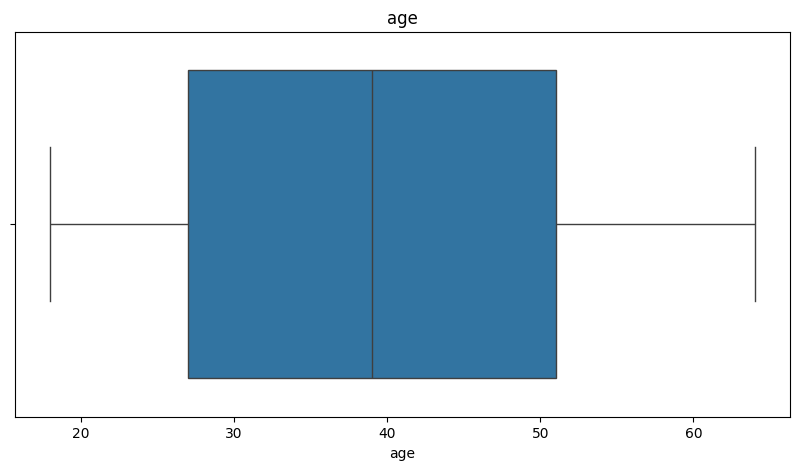

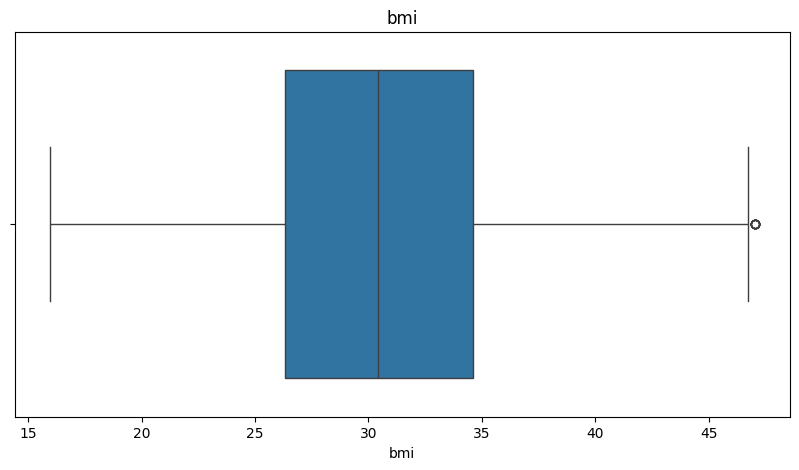

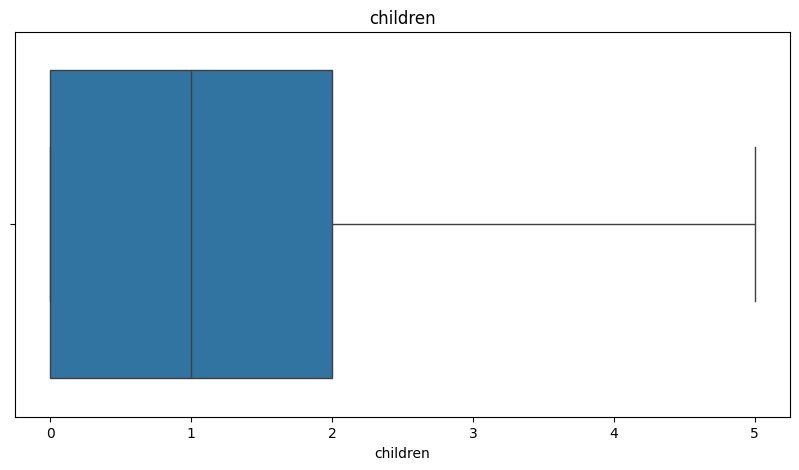

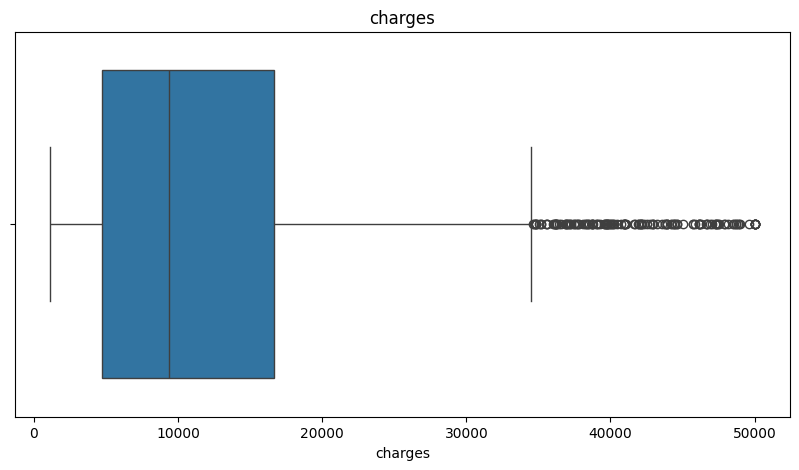

In [335]:
# control
for i in list(data.select_dtypes(include=['int64', 'float64']).columns) : # liste des colonne numeriques
    plt.figure(figsize=(10,5))
    sns.boxplot(data=data, x=f"{i}")
    plt.title(f"{i}")
    plt.show()

## Control et visualisation des colonnes

In [336]:
data.columns

Index(['age', 'sex', 'bmi', 'children', 'smoker', 'region', 'charges'], dtype='object')

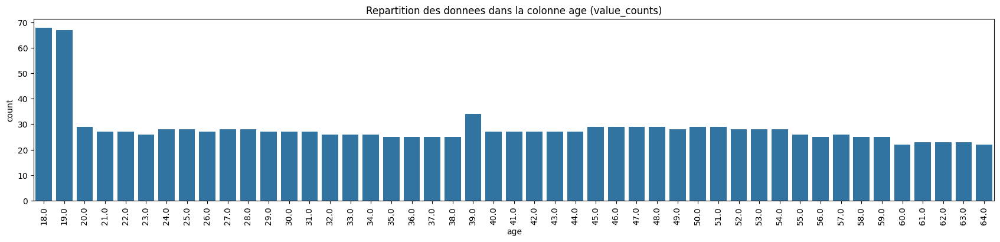

In [337]:
# control de la colonne age
plt.figure(figsize=(21,4))
plt.title("Repartition des donnees dans la colonne age (value_counts)")
sns.countplot(data=data, x="age")
plt.xticks(rotation=90)
plt.show()

In [338]:
# control de la colonne sex
data.sex.unique()

array(['female', 'male'], dtype=object)

In [339]:
data.sex.value_counts()

sex
male      675
female    662
Name: count, dtype: int64

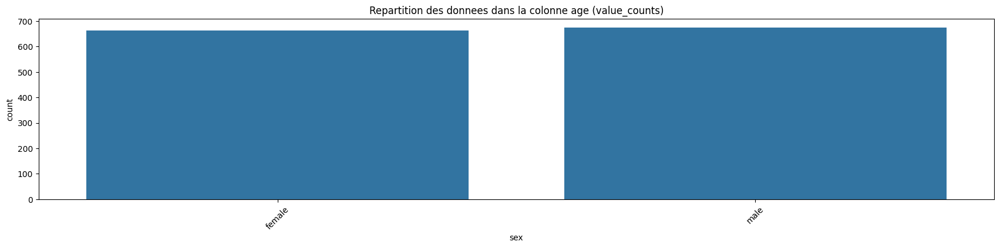

In [340]:
plt.figure(figsize=(21,4))
plt.title("Repartition des donnees dans la colonne age (value_counts)")
sns.countplot(data=data, x="sex")
plt.xticks(rotation=45)
plt.show()

In [341]:
# control de la colonne bmi
dict(data.bmi.value_counts())

{32.3: 13,
 47.03: 9,
 28.31: 9,
 30.8: 8,
 31.35: 8,
 30.875: 8,
 34.1: 8,
 28.88: 8,
 30.495: 8,
 38.06: 7,
 27.645: 7,
 34.8: 7,
 25.8: 7,
 35.2: 7,
 33.33: 7,
 24.32: 7,
 25.46: 7,
 32.775: 7,
 27.36: 7,
 32.11: 7,
 26.6: 6,
 27.5: 6,
 26.41: 6,
 28.595: 6,
 25.175: 6,
 31.73: 6,
 19.95: 6,
 29.83: 6,
 27.74: 6,
 33.63: 6,
 30.2: 6,
 37.1: 6,
 29.92: 6,
 35.53: 6,
 30.115: 6,
 30.59: 6,
 33.0: 6,
 30.65484973703982: 6,
 23.21: 5,
 22.515: 5,
 30.4: 5,
 26.315: 5,
 28.7: 5,
 26.695: 5,
 31.92: 5,
 28.025: 5,
 28.785: 5,
 33.345: 5,
 27.835: 5,
 29.64: 5,
 33.155: 5,
 27.6: 5,
 31.825: 5,
 33.66: 5,
 25.3: 5,
 36.85: 5,
 23.18: 5,
 26.03: 5,
 29.7: 5,
 34.2: 5,
 32.395: 5,
 28.5: 5,
 28.9: 5,
 28.975: 5,
 23.655: 5,
 25.08: 5,
 33.82: 4,
 32.68: 4,
 36.67: 4,
 35.86: 4,
 26.4: 4,
 35.815: 4,
 34.4: 4,
 36.3: 4,
 24.605: 4,
 30.5: 4,
 24.7: 4,
 29.735: 4,
 36.955: 4,
 30.78: 4,
 36.08: 4,
 28.215: 4,
 22.895: 4,
 24.795: 4,
 33.915: 4,
 24.13: 4,
 25.84: 4,
 29.26: 4,
 27.83: 4,
 34.4

<Axes: xlabel='bmi'>

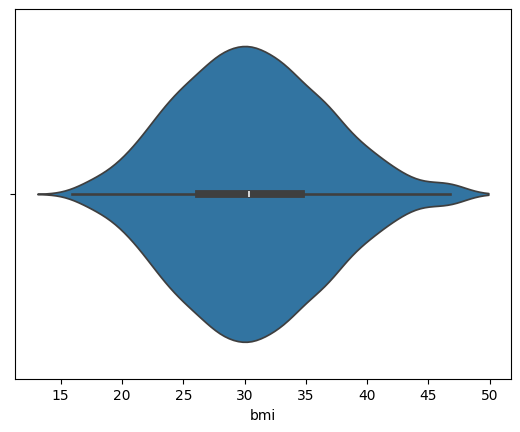

In [342]:
sns.violinplot(data=data, x="bmi")

In [343]:
# control de la colonne children
data.children.value_counts()

children
0.0    578
1.0    322
2.0    238
3.0    157
4.0     24
5.0     18
Name: count, dtype: int64

<Axes: xlabel='children', ylabel='count'>

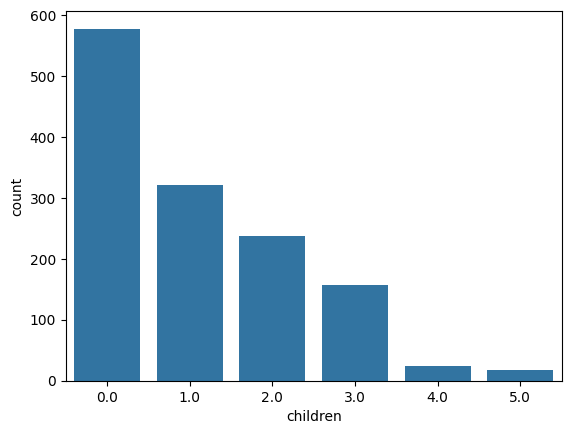

In [344]:
sns.countplot(data=data, x="children")

<Axes: xlabel='smoker', ylabel='count'>

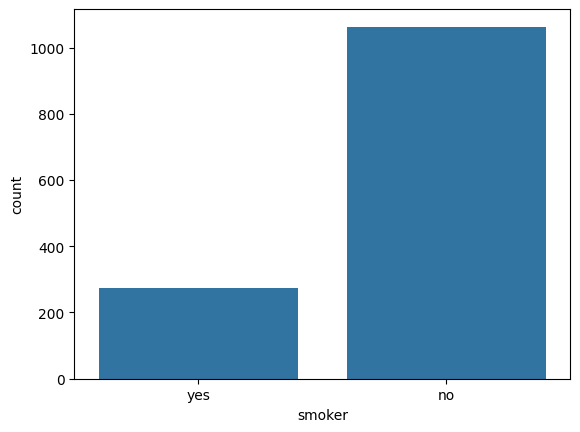

In [345]:
# control de la colonne 'smoker' 
sns.countplot(data=data, x='smoker') # tres desequilibrees

<Axes: xlabel='region', ylabel='count'>

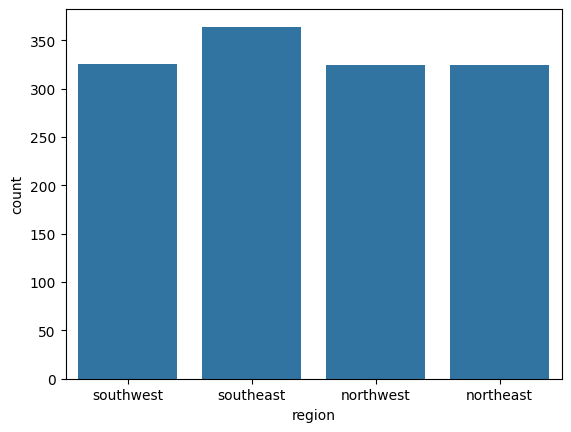

In [346]:
# control de la colonne region
sns.countplot(data=data, x="region")

In [347]:
# control de la colonne charges
data.charges.value_counts()

charges
50000.00000    7
19798.05455    1
13063.88300    1
13555.00490    1
44202.65360    1
              ..
4738.26820     1
2897.32350     1
12592.53450    1
5926.84600     1
11454.02150    1
Name: count, Length: 1331, dtype: int64

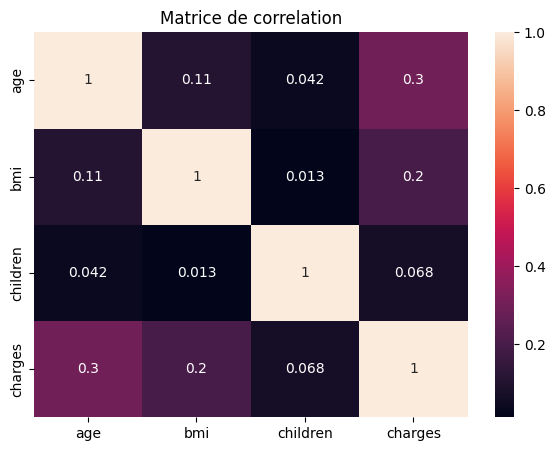

In [348]:
# gestion des correlations
_ = data.select_dtypes(["int", "float"])
plt.figure(figsize=(7,5))
plt.title("Matrice de correlation")
sns.heatmap(data=_.corr(), annot=True)
plt.show()

#

# Preparation des donnees pour le machine learning

In [349]:
data.head()

,age,sex,bmi,children,smoker,region,charges
0,19.0,female,27.900,0.0,yes,southwest,16884.92400
1,18.0,male,33.770,1.0,no,southeast,1725.55230
2,28.0,male,33.000,3.0,no,southeast,4449.46200
3,33.0,male,22.705,0.0,no,northwest,21984.47061
4,32.0,male,28.880,0.0,no,northwest,3866.85520


## gestion des colonnes categorielle

In [350]:
# gestion de la colonne sex
data["sex"] = data["sex"].map({'male': 1, 'female': 0})

In [351]:
# gestion de la colonne region

# Création du mapping basé sur la fréquence
region_frequency = data["region"].value_counts(normalize=True)

# Application du mapping pour encoder la colonne "region"
data["region"] = data["region"].map(region_frequency)

In [352]:
# gestion de la colonne smoker
data["smoker"] = data["smoker"].map({'yes': 1, 'no': 0})

In [353]:
data.head()

,age,sex,bmi,children,smoker,region,charges
0,19.0,0,27.900,0.0,1,0.243082,16884.92400
1,18.0,1,33.770,1.0,0,0.272251,1725.55230
2,28.0,1,33.000,3.0,0,0.272251,4449.46200
3,33.0,1,22.705,0.0,0,0.242334,21984.47061
4,32.0,1,28.880,0.0,0,0.242334,3866.85520


In [354]:
data.region.value_counts()

region
0.242334    648
0.272251    364
0.243082    325
Name: count, dtype: int64

## Isolation feature , target

In [355]:
X = data.drop(columns="smoker")
y = data[["smoker"]]

In [356]:
X.columns

Index(['age', 'sex', 'bmi', 'children', 'region', 'charges'], dtype='object')

## Isolation des donnees entre le train et le test

In [357]:
from sklearn.model_selection import train_test_split
X_train, X_test,y_train,y_test= train_test_split(X,y,test_size=0.25,random_state=123)

## standardisation des donnees

In [358]:
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
X_train=sc.fit_transform(X_train)
X_test=sc.transform(X_test)

#

# Creation des fonctions d'entrainements des modeles

## Random forest

In [359]:
## FONCTION D'ENTRAINEMENT ##
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score,confusion_matrix
from sklearn.metrics import RocCurveDisplay
from sklearn.metrics import classification_report

def random_Forest_Train(X_train, y_train):

    # INITIALISATION ET ENTRAINEMENT
    Random_forest = RandomForestClassifier(max_depth= 2) # reduction de la profondeur de l'abre pour empeche l'overfit (nombre trop bas de donnees)
    Random_forest.fit(X_train,y_train)
    
    # PREDICTION SUR LE TRAIN
    ypredict_train = Random_forest.predict(X_train)

    # DETERMINATION DES METRIQUES
    acc = accuracy_score(y_train,ypredict_train) # accuracy
    conf = confusion_matrix(y_train,ypredict_train) # confusion matrix
    svc_disp = RocCurveDisplay.from_estimator(Random_forest,X_train,y_train) # courbe ROC

    print("Accuracy : ", acc)

    plt.figure(figsize=(8,5))
    sns.heatmap(conf, annot=True)
    plt.title("Matrice de confusion")
    plt.show()

    print(classification_report(y_train,ypredict_train))
    return Random_forest

## Naives bayes

In [360]:
from sklearn.naive_bayes import GaussianNB

## FONCTION D'ENTRAINEMENT ##
def naives_bayes_train(X_train, y_train):
    # ENTRAINEMENT DU MODELE
    naives_bayes =GaussianNB()
    naives_bayes.fit(X_train,y_train)
    ypredict_train=naives_bayes.predict(X_train)

    # DETERMINATION DES METRIQUES
    acc=accuracy_score(y_train,ypredict_train) # accuracy
    conf=confusion_matrix(y_train,ypredict_train) # confusion matrix
    svc_disp=RocCurveDisplay.from_estimator(naives_bayes,X_train,y_train) # courbe ROC

    print("Accuracy : ", acc)

    plt.figure(figsize=(5,5))
    sns.heatmap(conf, annot=True)
    plt.title("Matrice de confusion")
    plt.show()

    print(classification_report(y_train,ypredict_train))
    return naives_bayes

## Xgboost

In [361]:
##  ENTREINEMENT DU MODELE ##

import xgboost as xgb
from sklearn.metrics import roc_curve, auc

def xgboost_train(X_train, y_train):
    D_train=xgb.DMatrix(X_train,label=y_train)
    param={'eta':0.3,'max_depth':2,'objective':'multi:softprob','num_class':2}
    steps = 20 # nombre de passage d'aprentissage
    xgboost_model = xgb.train(param,D_train,steps)
    ypredict_train=xgboost_model.predict(D_train)
    # Si les prédictions sont des probabilités, les convertir en labels de classe
    if ypredict_train.ndim > 1:
        ypredict_train = np.argmax(ypredict_train, axis=1)

    # DETERMINATION DES METRIQUES
    acc = accuracy_score(y_train,ypredict_train) # accuracy
    conf = confusion_matrix(y_train,ypredict_train) # confusion matrix
    
    print("Accuracy : ", acc)
    
    ypredict_train_proba = xgboost_model.predict(D_train)[:,1]
    fpr, tpr, _ = roc_curve(y_train, ypredict_train_proba)
    roc_auc = auc(fpr, tpr)

    plt.plot(fpr, tpr, label=f'ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Courbe ROC')
    plt.legend(loc='lower right')
    plt.show()

    plt.figure(figsize=(8,5))
    sns.heatmap(conf, annot=True)
    plt.title("Matrice de confusion")
    plt.show()

    print(classification_report(y_train,ypredict_train))
    return xgboost_model

#

# Re-equilibrage des donnees

## Methodes de re-equilibrage des donnees

### Over-sampling

In [362]:
from imblearn.over_sampling import (
    RandomOverSampler,
    SMOTE,
    ADASYN,
    BorderlineSMOTE,
    SVMSMOTE,
)
from sklearn.svm import SVC

oversampler_dict = {
    'random': RandomOverSampler(
        sampling_strategy='auto',
        random_state=0),

    'smote': SMOTE(
        sampling_strategy='auto',
        random_state=0,
        k_neighbors=5),

    'adasyn': ADASYN(
        sampling_strategy='auto',
        random_state=0,
        n_neighbors=5),

    'border1': BorderlineSMOTE(
        sampling_strategy='auto',
        random_state=0,
        k_neighbors=5,
        m_neighbors=10,
        kind='borderline-1'),

    'border2': BorderlineSMOTE(
        sampling_strategy='auto',
        random_state=0,
        k_neighbors=5,
        m_neighbors=10,
        kind='borderline-2'),

    'svm': SVMSMOTE(
        sampling_strategy='auto',
        random_state=0,
        k_neighbors=5,
        m_neighbors=10,
        svm_estimator=SVC(kernel='linear')),
}


#### Application
Application de toute les methodes , visualisation et control de l'impact sur les modeles 

In [363]:
def compare_smoker_distribution(original_data, resampled_data, p = 0 , title_suffix=''):
    """
    Compare la répartition des classes fumeurs avant/après sur-échantillonnage.
    Affiche 2 lignes de sous-graphiques pour chaque variable : original (haut), resampled (bas).
    """
    import matplotlib.pyplot as plt
    import seaborn as sns

    cols_to_plot = ['charges', 'age', 'bmi', 'children', 'sex', 'region']
    n_plots = len(cols_to_plot) + 1  # +1 pour la variable cible "smoker"

    fig, axes = plt.subplots(2, n_plots, figsize=(4 * n_plots, 10))
    
    for ax_row, dataset, label in zip(axes, [original_data, resampled_data], ['Avant', 'Après']):
        # Plot countplot pour 'smoker'
        sns.countplot(data=dataset, x='smoker', ax=ax_row[0])
        ax_row[0].set_title(f"{label} - Fumeur")
        ax_row[0].set_xlabel('Fumeur')
        ax_row[0].set_ylabel('Nombre')

        # Plot les autres colonnes
        for i, col in enumerate(cols_to_plot):
            if dataset[col].dtype == 'object':
                sns.countplot(data=dataset, x=col, hue='smoker', ax=ax_row[i+1])
                ax_row[i+1].set_ylabel('Nombre')
            else:
                sns.kdeplot(data=dataset, x=col, hue='smoker', fill=True, ax=ax_row[i+1])
                ax_row[i+1].set_ylabel('Densité')

            ax_row[i+1].set_title(f"{label} - {col.capitalize()}")
            ax_row[i+1].set_xlabel(col.capitalize())

    if p == 0:
        plt.suptitle(f'Comparaison Avant/Après OverSampling {title_suffix}', fontsize=16)
    else :
        plt.suptitle(f'Comparaison Avant/Après UnderSampling {title_suffix}', fontsize=16) 
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()


In [364]:
def compare_pca_oversampling(original_data, resampled_datasets_dict, p=0):
    """
    Affiche la projection PCA du jeu original et de chaque jeu suréchantillonné sur une même ligne.
    """
    import matplotlib.pyplot as plt
    import seaborn as sns
    from sklearn.decomposition import PCA
    from sklearn.preprocessing import StandardScaler

    methods = ['Original'] + list(resampled_datasets_dict.keys())
    datasets = [original_data] + list(resampled_datasets_dict.values())

    n_cols = len(datasets)
    fig, axes = plt.subplots(1, n_cols, figsize=(6 * n_cols, 5))  # 1 ligne

    if n_cols == 1:
        axes = [axes]  # S'assurer que axes est itérable

    for i, (method_name, data) in enumerate(zip(methods, datasets)):
        features = ['age', 'sex', 'bmi', 'children', 'region', 'charges']
        X = data[features]
        y = data['smoker']

        # Encodage et standardisation
        X_encoded = pd.get_dummies(X, drop_first=True)
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(X_encoded)

        # PCA
        pca = PCA(n_components=2)
        X_pca = pca.fit_transform(X_scaled)
        pca_df = pd.DataFrame(X_pca, columns=['PC1', 'PC2'])
        pca_df['smoker'] = y.values

        # Scatterplot
        sns.scatterplot(
            data=pca_df,
            x='PC1',
            y='PC2',
            hue='smoker',
            palette='Dark2',
            s=50,
            alpha=0.6,
            edgecolor='black',
            ax=axes[i]
        )
        axes[i].set_title(f"PCA - {method_name}")
        axes[i].set_xlabel("PC1")
        axes[i].set_ylabel("PC2")
        axes[i].legend(title="Smoker")

    plt.tight_layout()
    if p == 0 :
        plt.suptitle("Comparaison PCA - Données Originales vs Suréchantillonnées", fontsize=18, y=1.05)
    else : 
        plt.suptitle("Comparaison PCA - Données Originales vs Sous-échantillonnées", fontsize=18, y=1.05)
    plt.show()


##### Random forest

In [365]:
def compare_random_forest_performance(X_train_orig, y_train_orig,
                                      X_train_res, y_train_res,
                                      X_test, y_test, p=0):
    import matplotlib.pyplot as plt
    import seaborn as sns
    from sklearn.metrics import (
        accuracy_score, confusion_matrix,
        classification_report, roc_curve, auc
    )

    # Entraînement des deux modèles
    if p == 0 :
        print("=== Entraînement sur données suréchantillonnées ===")
    else : 
        print("=== Entraînement sur données sous-échantillonnées ===")

    model_resampled = random_Forest_Train(X_train_res, y_train_res)

    print("\n=== Entraînement sur données originales ===")
    model_original = random_Forest_Train(X_train_orig, y_train_orig)

    # Test des deux modèles
    ypred_res = model_resampled.predict(X_test)
    ypred_orig = model_original.predict(X_test)

    # ROC probas
    yproba_res = model_resampled.predict_proba(X_test)[:, 1]
    yproba_orig = model_original.predict_proba(X_test)[:, 1]

    # Confusion matrices
    conf_res = confusion_matrix(y_test, ypred_res)
    conf_orig = confusion_matrix(y_test, ypred_orig)

    # Metrics
    report_res = classification_report(y_test, ypred_res, output_dict=True)
    report_orig = classification_report(y_test, ypred_orig, output_dict=True)

    acc_res = accuracy_score(y_test, ypred_res)
    acc_orig = accuracy_score(y_test, ypred_orig)

    # Courbes ROC
    fpr_res, tpr_res, _ = roc_curve(y_test, yproba_res)
    fpr_orig, tpr_orig, _ = roc_curve(y_test, yproba_orig)
    auc_res = auc(fpr_res, tpr_res)
    auc_orig = auc(fpr_orig, tpr_orig)

    # ==== VISUALISATION ====
    fig, axes = plt.subplots(3, 2, figsize=(14, 14))

    # Matrices de confusion
    sns.heatmap(conf_res, annot=True, fmt='d', ax=axes[0, 0])
    if p ==0 :
        axes[0, 0].set_title("Confusion Matrix - Oversampled")
    else :
        axes[0, 0].set_title("Confusion Matrix - Undersampled") 
    sns.heatmap(conf_orig, annot=True, fmt='d', ax=axes[0, 1])
    axes[0, 1].set_title("Confusion Matrix - Original")

    # Accuracy + Rapport Classification
    axes[1, 0].axis('off')
    axes[1, 1].axis('off')
    axes[1, 0].text(0, 0.5, f"Accuracy: {acc_res:.2f}\n\n" + classification_report(y_test, ypred_res),
                   fontsize=10, va='center')
    axes[1, 1].text(0, 0.5, f"Accuracy: {acc_orig:.2f}\n\n" + classification_report(y_test, ypred_orig),
                   fontsize=10, va='center')
    if p==0:
        axes[1, 0].set_title("Rapport - Oversampled")
    else:
        axes[1, 0].set_title("Rapport - Undersampled")
    
    axes[1, 1].set_title("Rapport - Original")

    # Courbe ROC
    axes[2, 0].plot(fpr_res, tpr_res, label=f'AUC = {auc_res:.2f}')
    axes[2, 1].plot(fpr_orig, tpr_orig, label=f'AUC = {auc_orig:.2f}')
    for ax in axes[2]:
        ax.plot([0, 1], [0, 1], 'k--')
        ax.set_xlabel("Taux de faux positifs")
        ax.set_ylabel("Taux de vrais positifs")
        ax.legend()
    
    if p ==0 :
        axes[2, 0].set_title("ROC - Oversampled")
    else:
        axes[2, 0].set_title("ROC - Undersampled")
    axes[2, 1].set_title("ROC - Original")

    plt.tight_layout()
    plt.suptitle("Comparaison des performances Random Forest", fontsize=16, y=1.02)
    plt.show()


Méthode d'over-sampling :  random


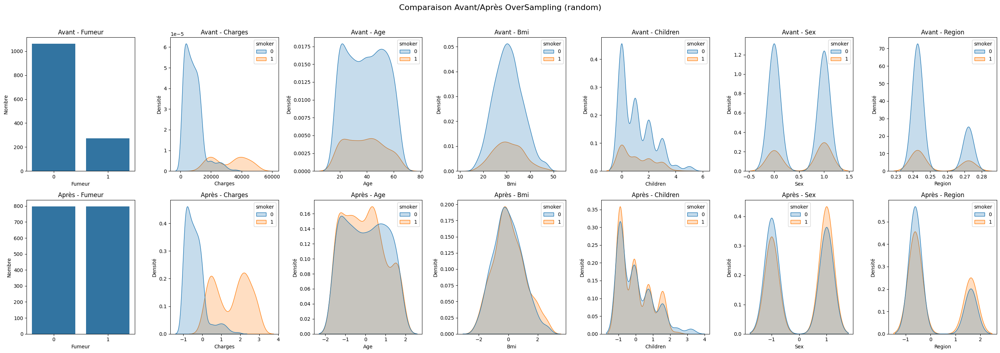

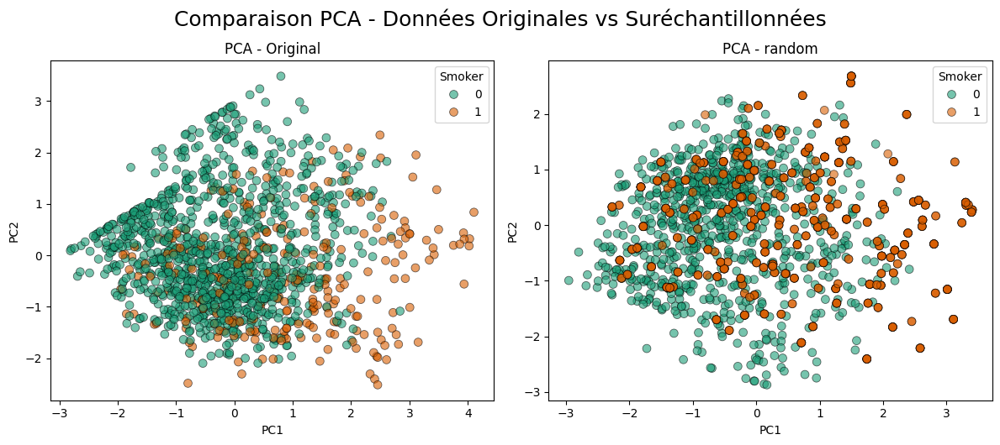


####### COMPARAISON PERFORMANCE - MÉTHODE : RANDOM #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.944792973651192


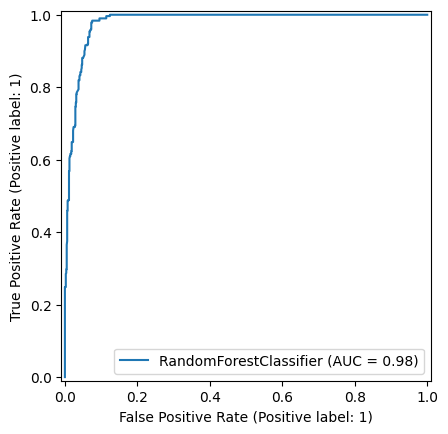

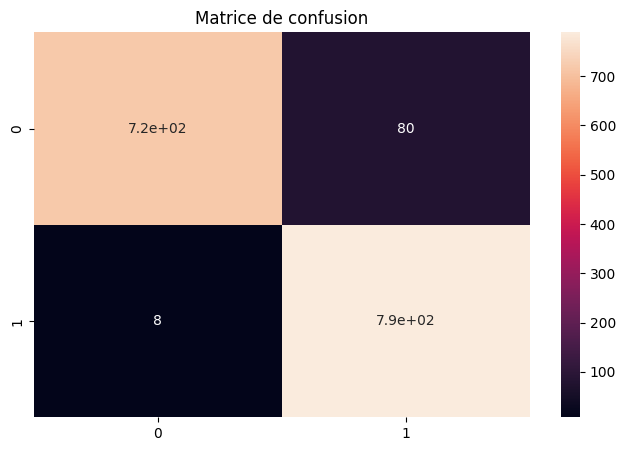

              precision    recall  f1-score   support

           0       0.99      0.90      0.94       797
           1       0.91      0.99      0.95       797

    accuracy                           0.94      1594
   macro avg       0.95      0.94      0.94      1594
weighted avg       0.95      0.94      0.94      1594


=== Entraînement sur données originales ===
Accuracy :  0.9411177644710579


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


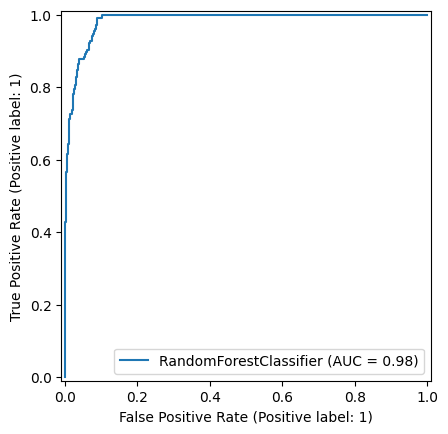

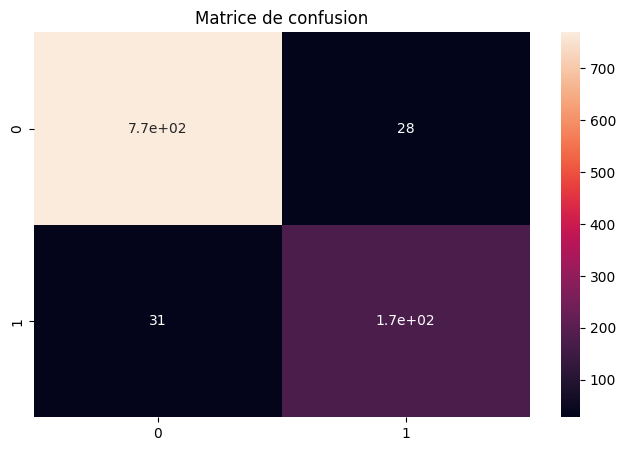

              precision    recall  f1-score   support

           0       0.96      0.96      0.96       797
           1       0.86      0.85      0.86       205

    accuracy                           0.94      1002
   macro avg       0.91      0.91      0.91      1002
weighted avg       0.94      0.94      0.94      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


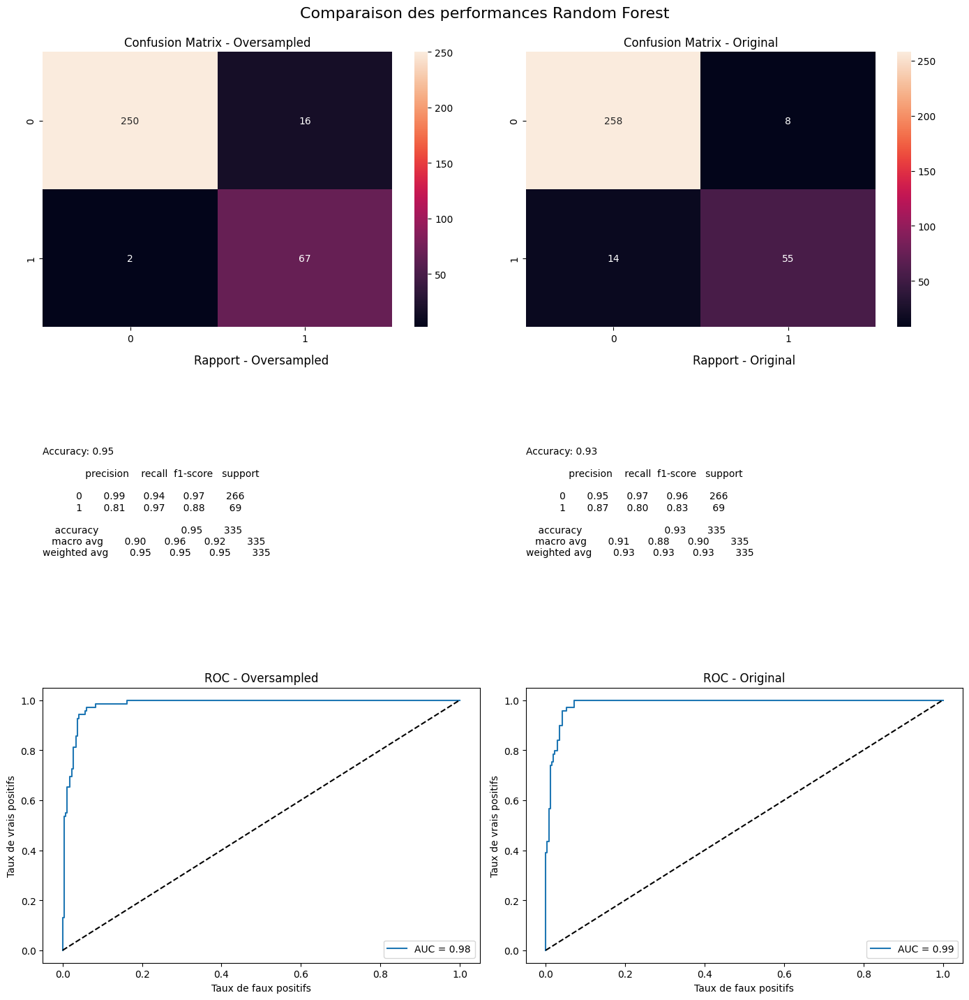

Méthode d'over-sampling :  smote


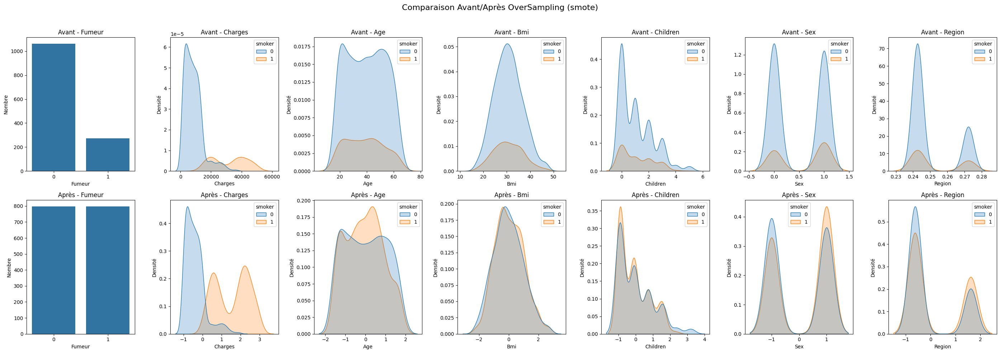

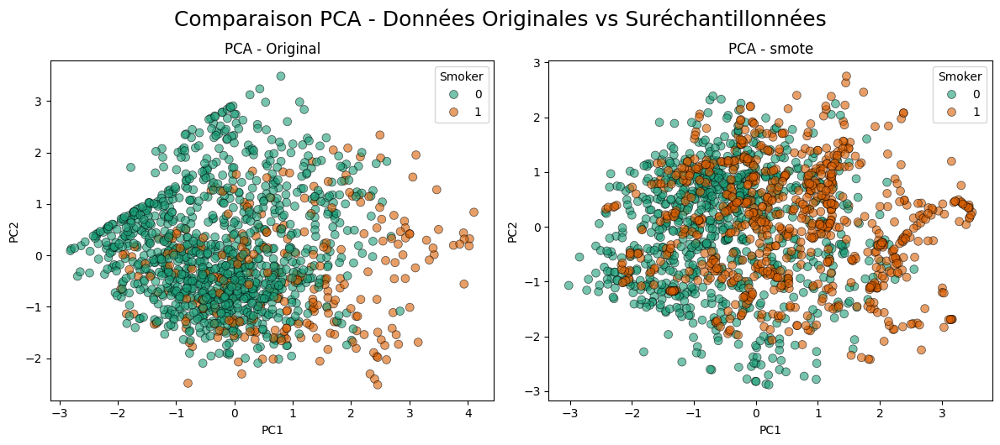


####### COMPARAISON PERFORMANCE - MÉTHODE : SMOTE #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9454203262233375


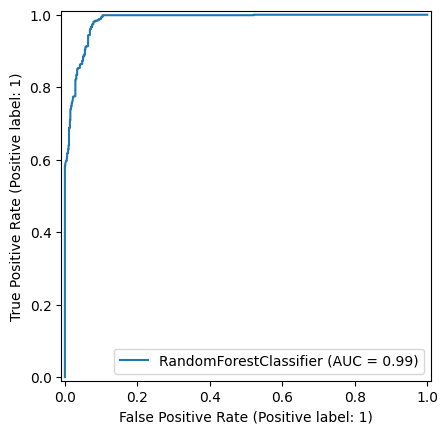

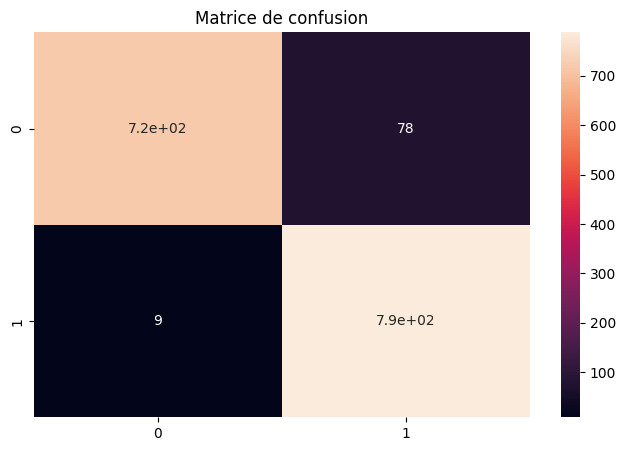

              precision    recall  f1-score   support

           0       0.99      0.90      0.94       797
           1       0.91      0.99      0.95       797

    accuracy                           0.95      1594
   macro avg       0.95      0.95      0.95      1594
weighted avg       0.95      0.95      0.95      1594


=== Entraînement sur données originales ===
Accuracy :  0.9271457085828343


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


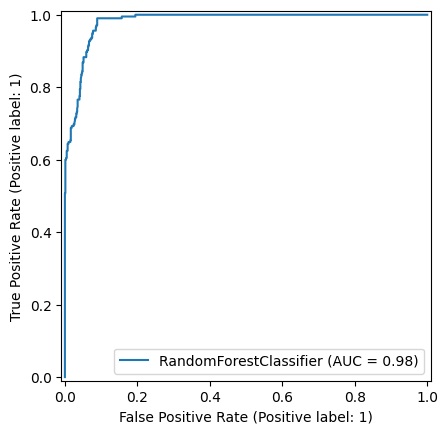

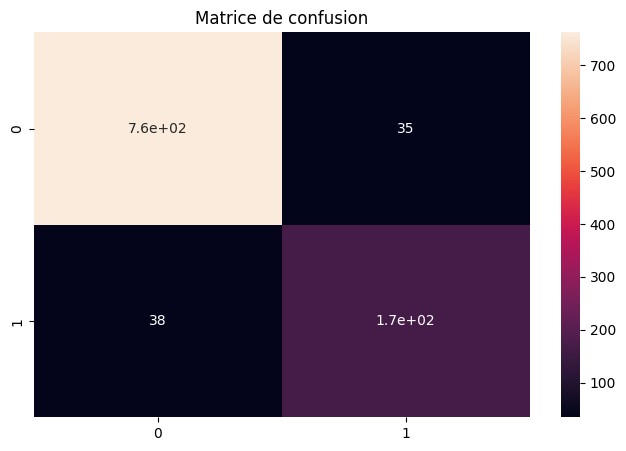

              precision    recall  f1-score   support

           0       0.95      0.96      0.95       797
           1       0.83      0.81      0.82       205

    accuracy                           0.93      1002
   macro avg       0.89      0.89      0.89      1002
weighted avg       0.93      0.93      0.93      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


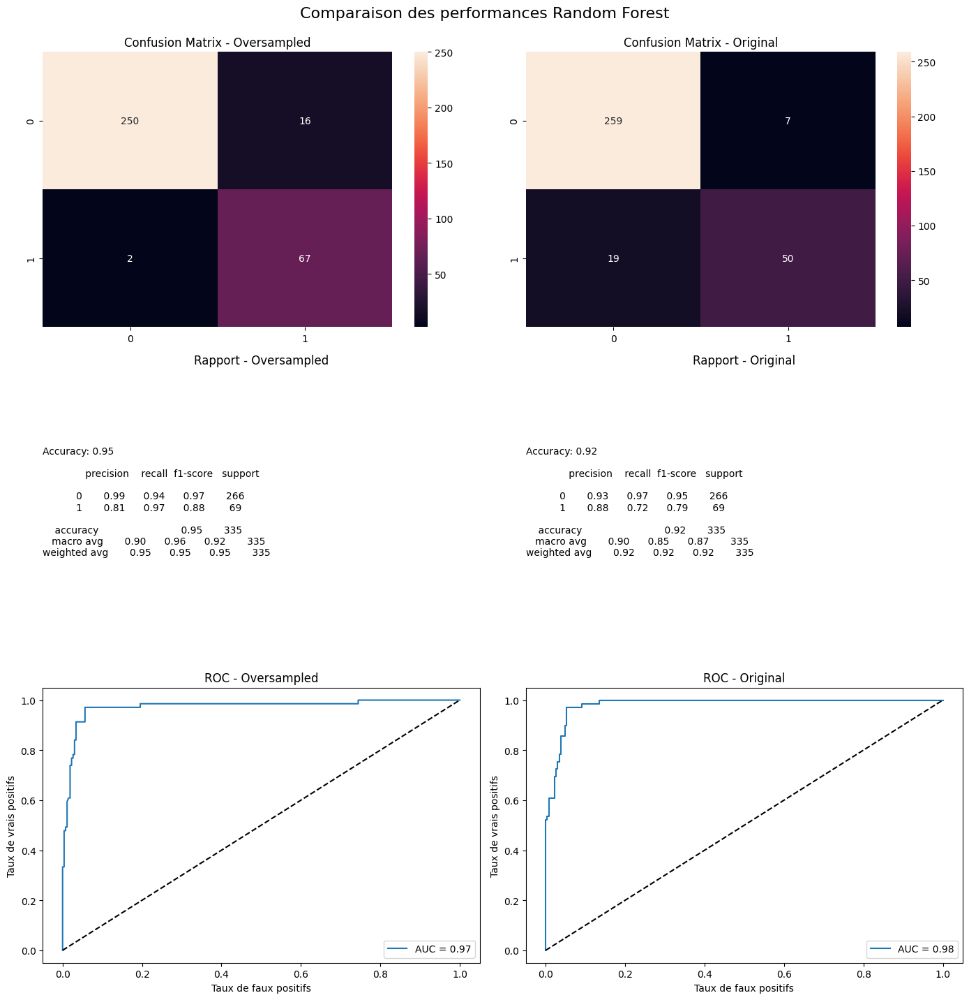

Méthode d'over-sampling :  adasyn


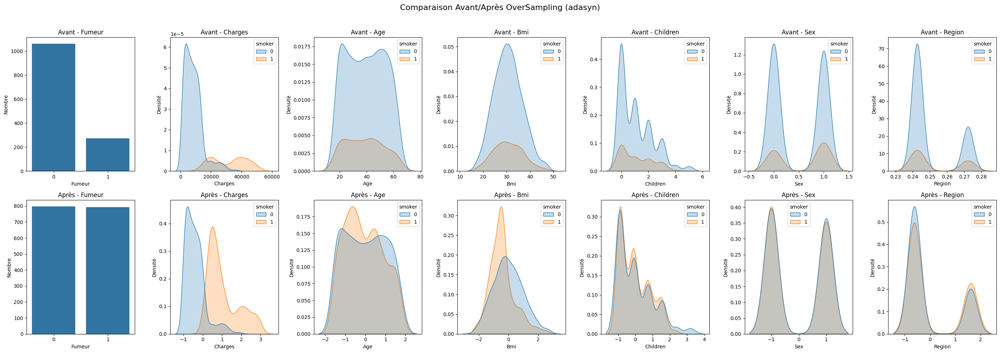

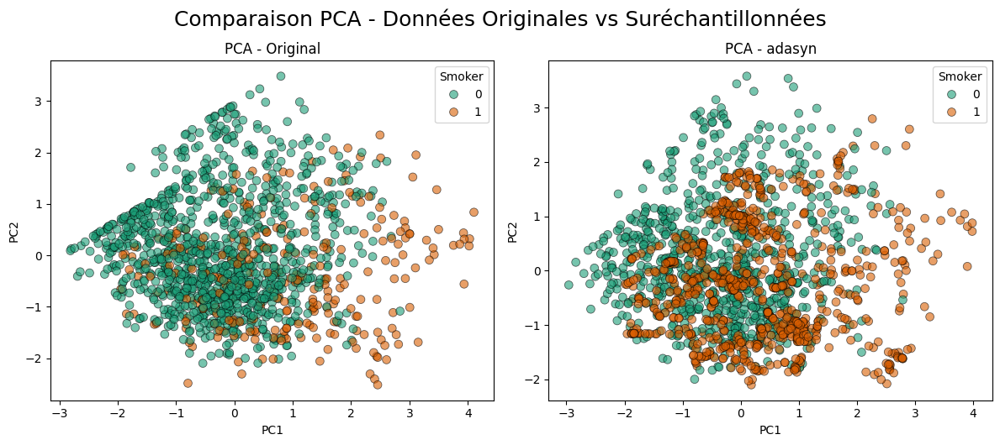


####### COMPARAISON PERFORMANCE - MÉTHODE : ADASYN #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9477987421383648


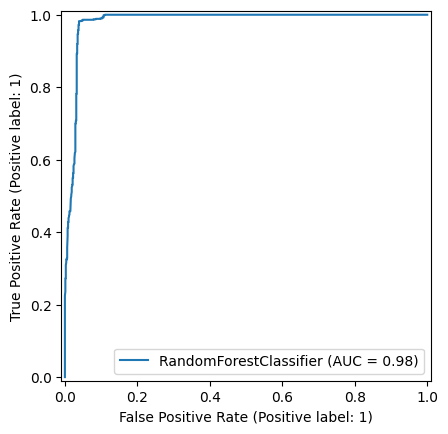

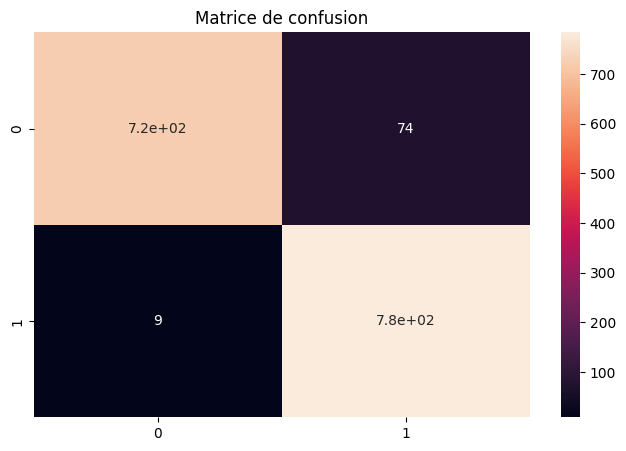

              precision    recall  f1-score   support

           0       0.99      0.91      0.95       797
           1       0.91      0.99      0.95       793

    accuracy                           0.95      1590
   macro avg       0.95      0.95      0.95      1590
weighted avg       0.95      0.95      0.95      1590


=== Entraînement sur données originales ===
Accuracy :  0.9191616766467066


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


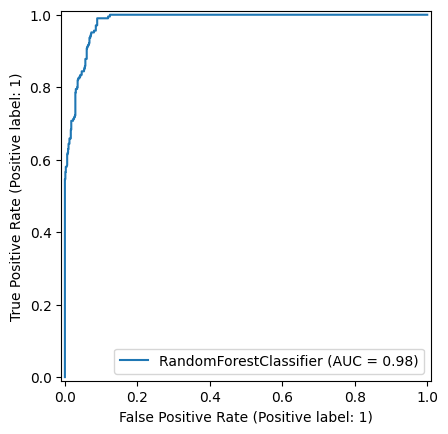

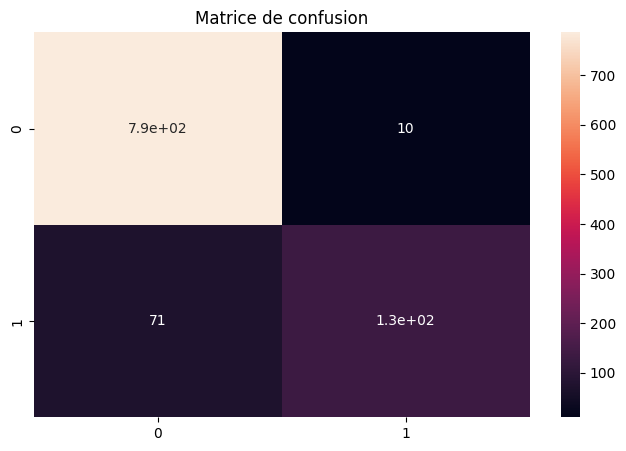

              precision    recall  f1-score   support

           0       0.92      0.99      0.95       797
           1       0.93      0.65      0.77       205

    accuracy                           0.92      1002
   macro avg       0.92      0.82      0.86      1002
weighted avg       0.92      0.92      0.91      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


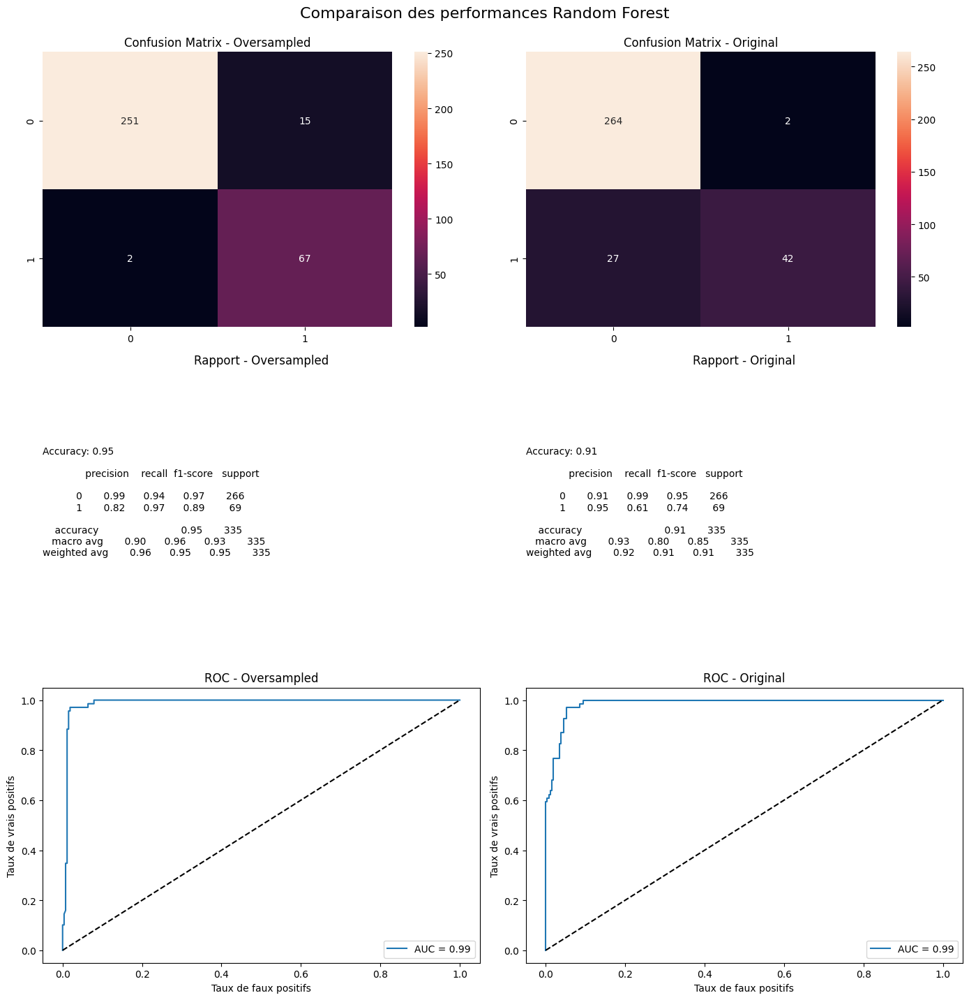

Méthode d'over-sampling :  border1


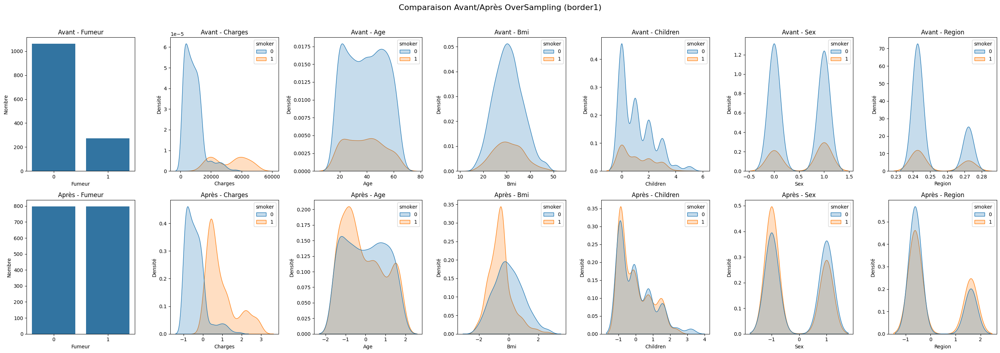

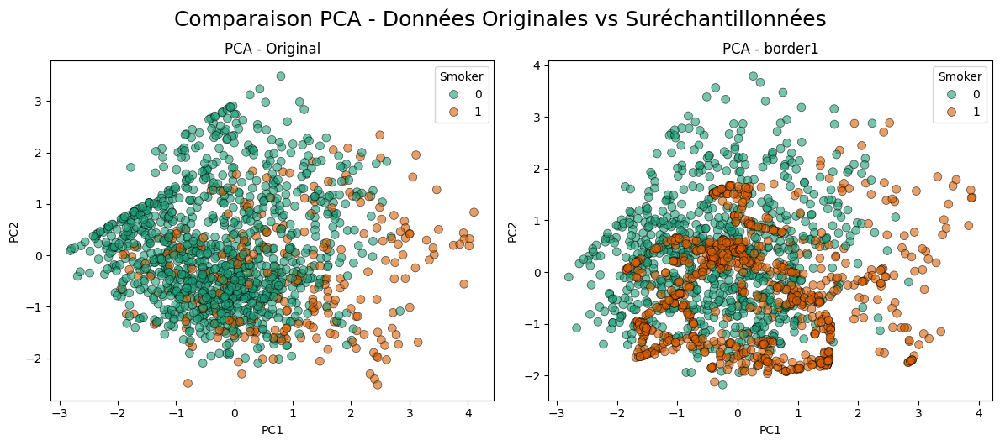


####### COMPARAISON PERFORMANCE - MÉTHODE : BORDER1 #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9435382685069009


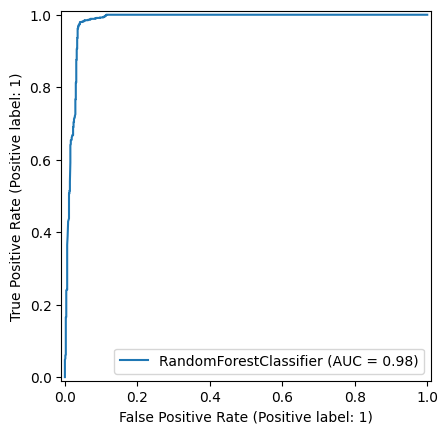

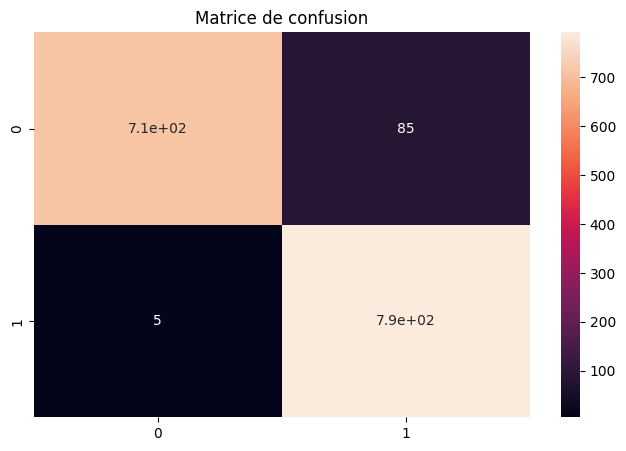

              precision    recall  f1-score   support

           0       0.99      0.89      0.94       797
           1       0.90      0.99      0.95       797

    accuracy                           0.94      1594
   macro avg       0.95      0.94      0.94      1594
weighted avg       0.95      0.94      0.94      1594


=== Entraînement sur données originales ===
Accuracy :  0.9101796407185628


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


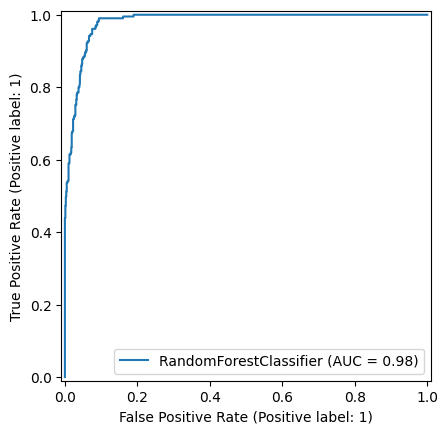

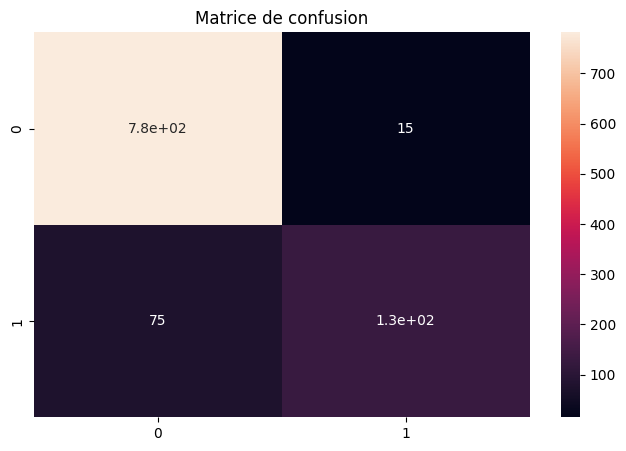

              precision    recall  f1-score   support

           0       0.91      0.98      0.95       797
           1       0.90      0.63      0.74       205

    accuracy                           0.91      1002
   macro avg       0.90      0.81      0.84      1002
weighted avg       0.91      0.91      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


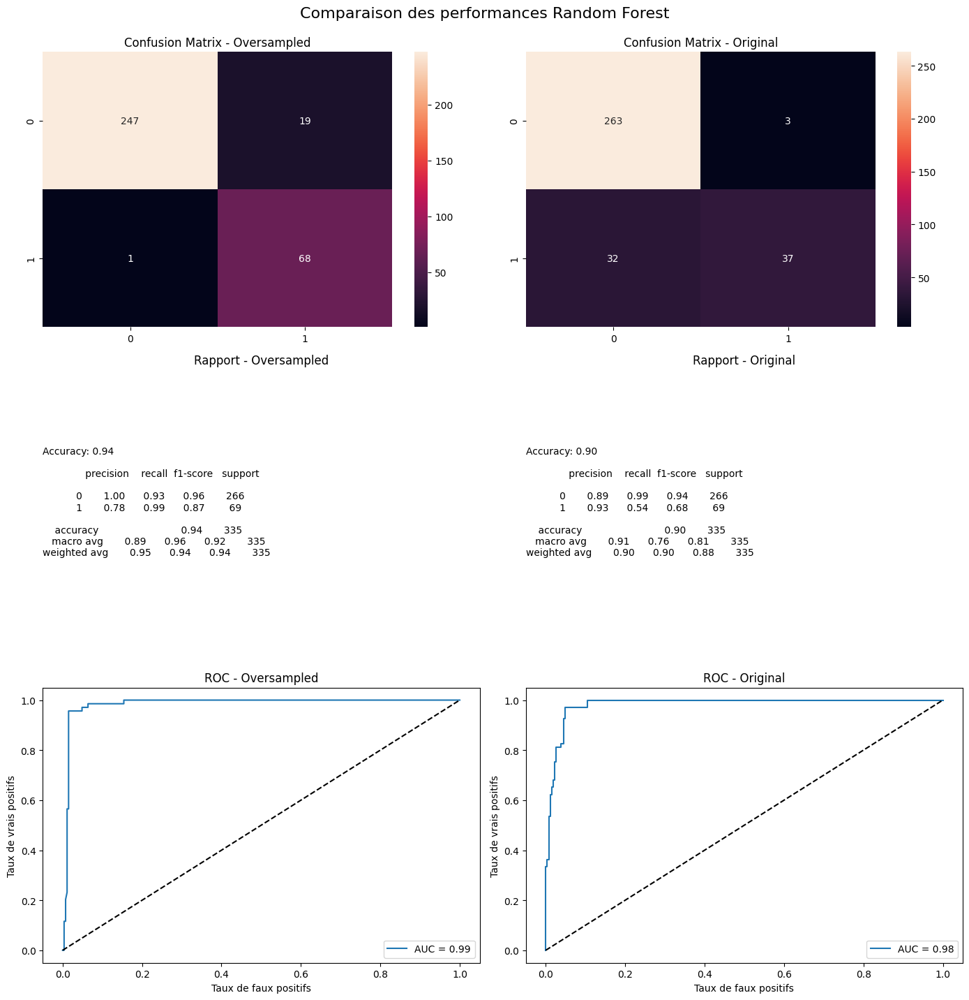

Méthode d'over-sampling :  border2


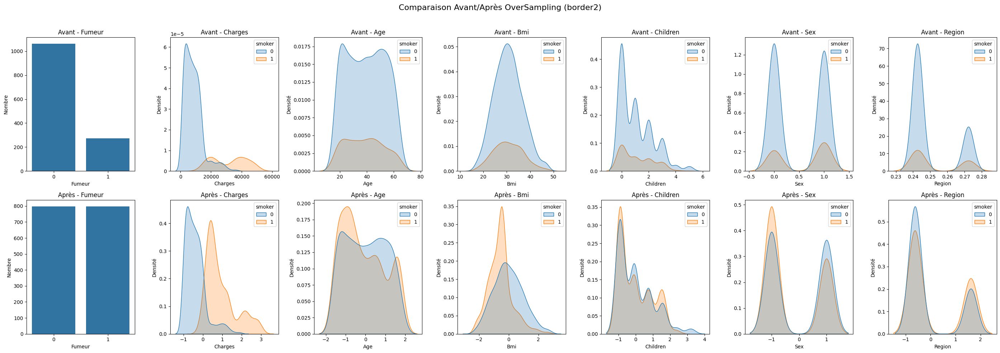

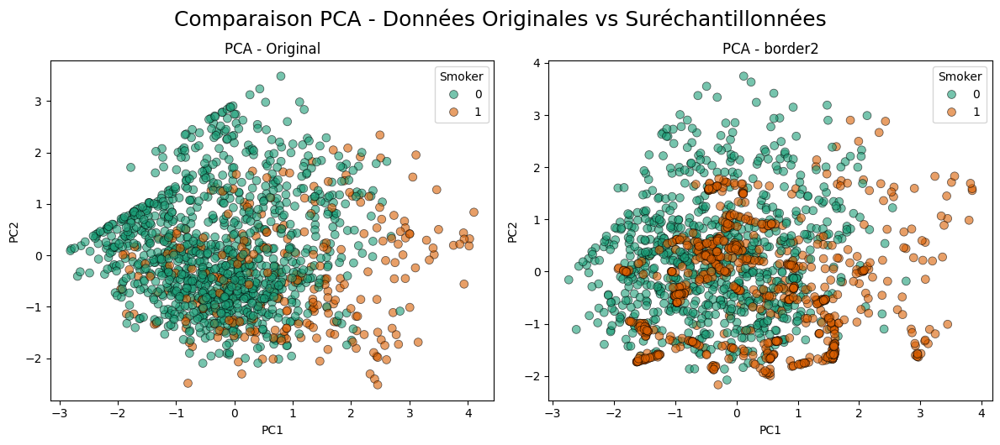


####### COMPARAISON PERFORMANCE - MÉTHODE : BORDER2 #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9328732747804266


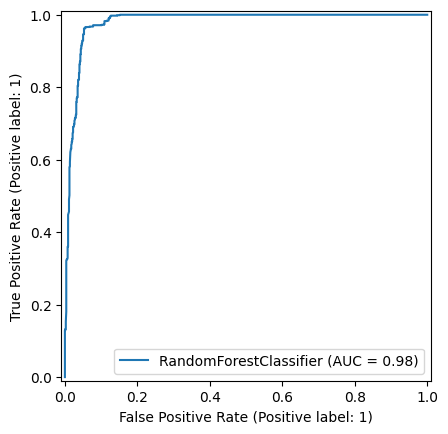

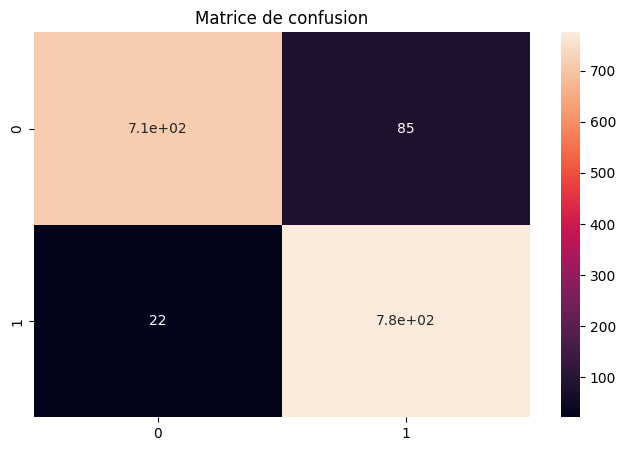

              precision    recall  f1-score   support

           0       0.97      0.89      0.93       797
           1       0.90      0.97      0.94       797

    accuracy                           0.93      1594
   macro avg       0.94      0.93      0.93      1594
weighted avg       0.94      0.93      0.93      1594


=== Entraînement sur données originales ===
Accuracy :  0.8832335329341318


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


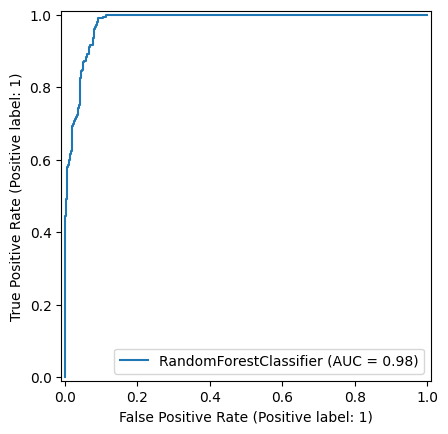

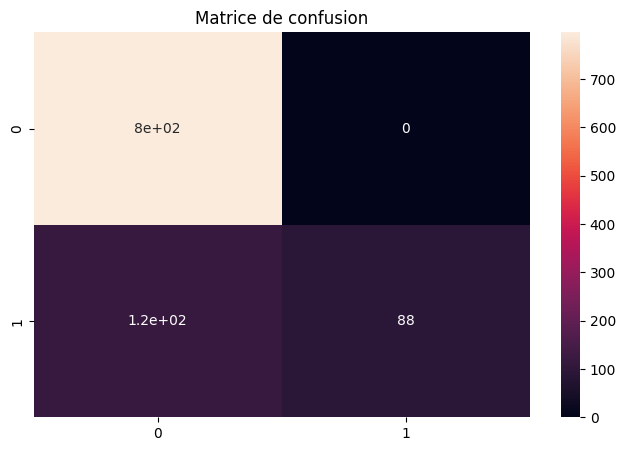

              precision    recall  f1-score   support

           0       0.87      1.00      0.93       797
           1       1.00      0.43      0.60       205

    accuracy                           0.88      1002
   macro avg       0.94      0.71      0.77      1002
weighted avg       0.90      0.88      0.86      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


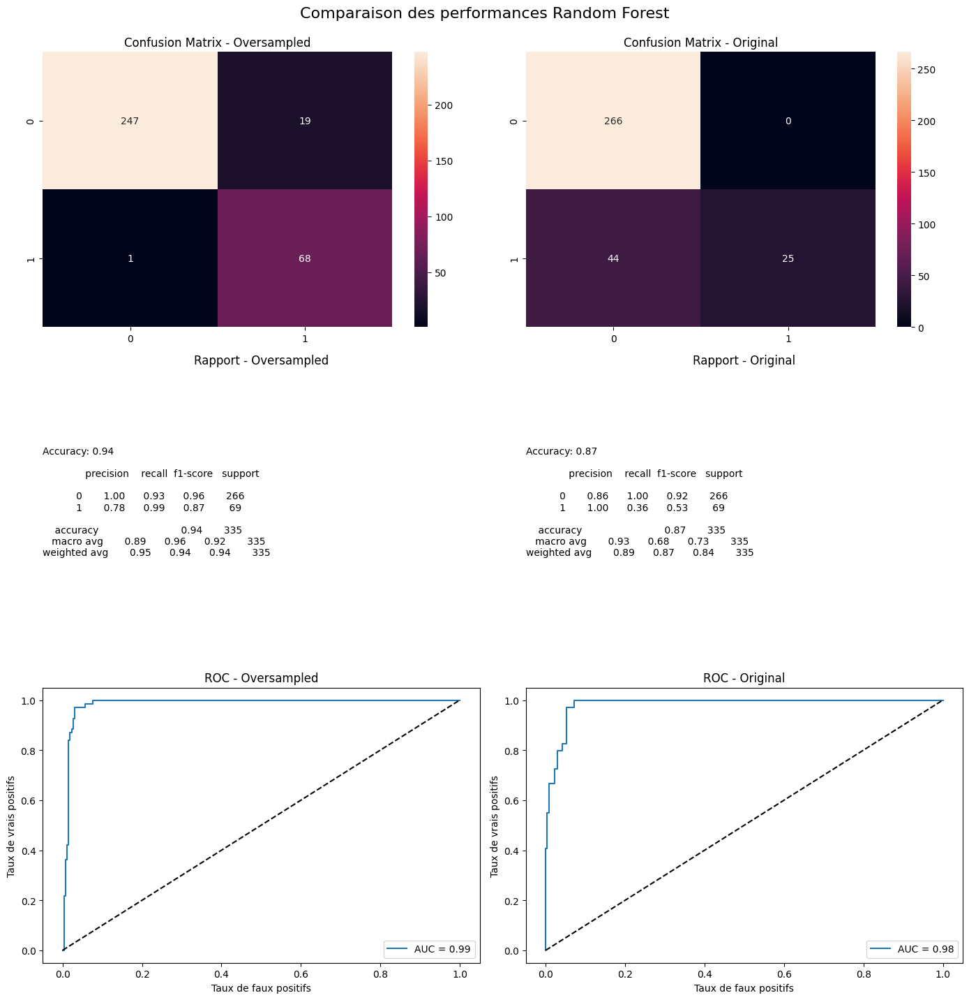

Méthode d'over-sampling :  svm


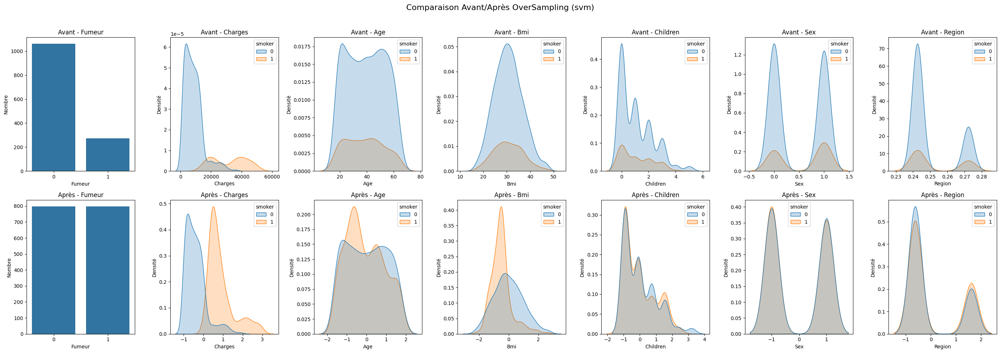

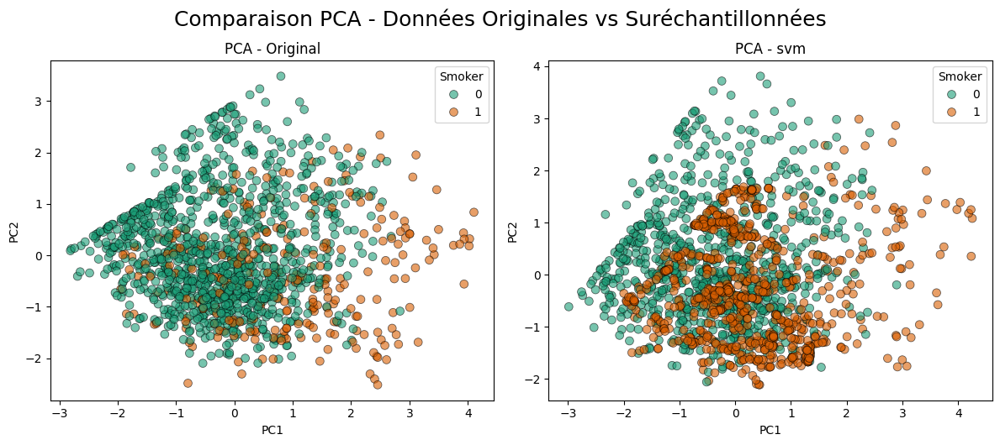


####### COMPARAISON PERFORMANCE - MÉTHODE : SVM #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9504391468005019


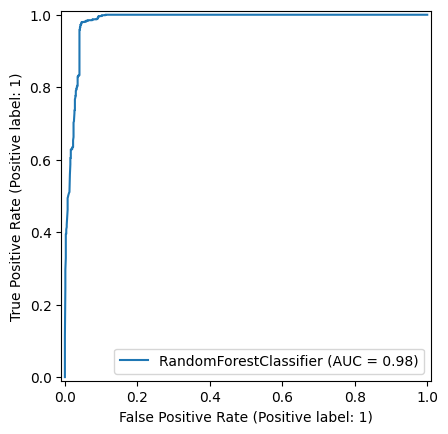

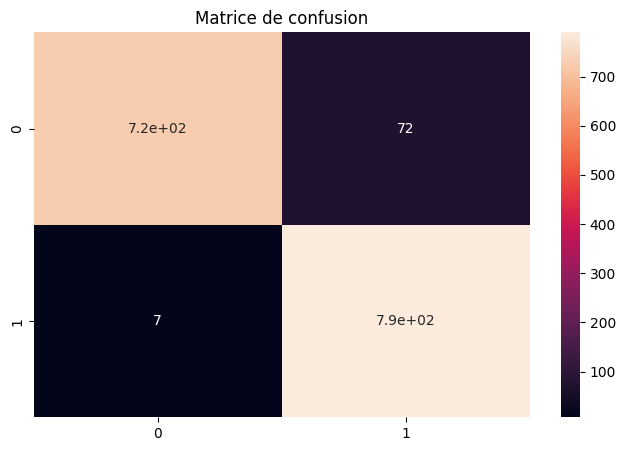

              precision    recall  f1-score   support

           0       0.99      0.91      0.95       797
           1       0.92      0.99      0.95       797

    accuracy                           0.95      1594
   macro avg       0.95      0.95      0.95      1594
weighted avg       0.95      0.95      0.95      1594


=== Entraînement sur données originales ===
Accuracy :  0.9341317365269461


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


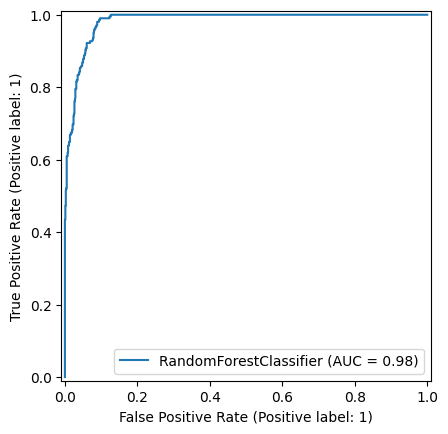

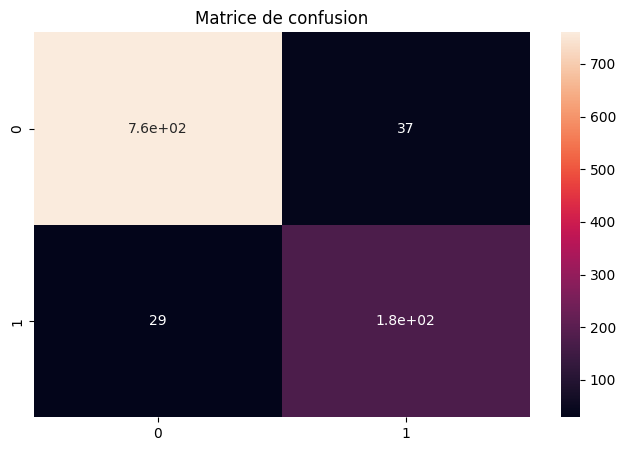

              precision    recall  f1-score   support

           0       0.96      0.95      0.96       797
           1       0.83      0.86      0.84       205

    accuracy                           0.93      1002
   macro avg       0.89      0.91      0.90      1002
weighted avg       0.94      0.93      0.93      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


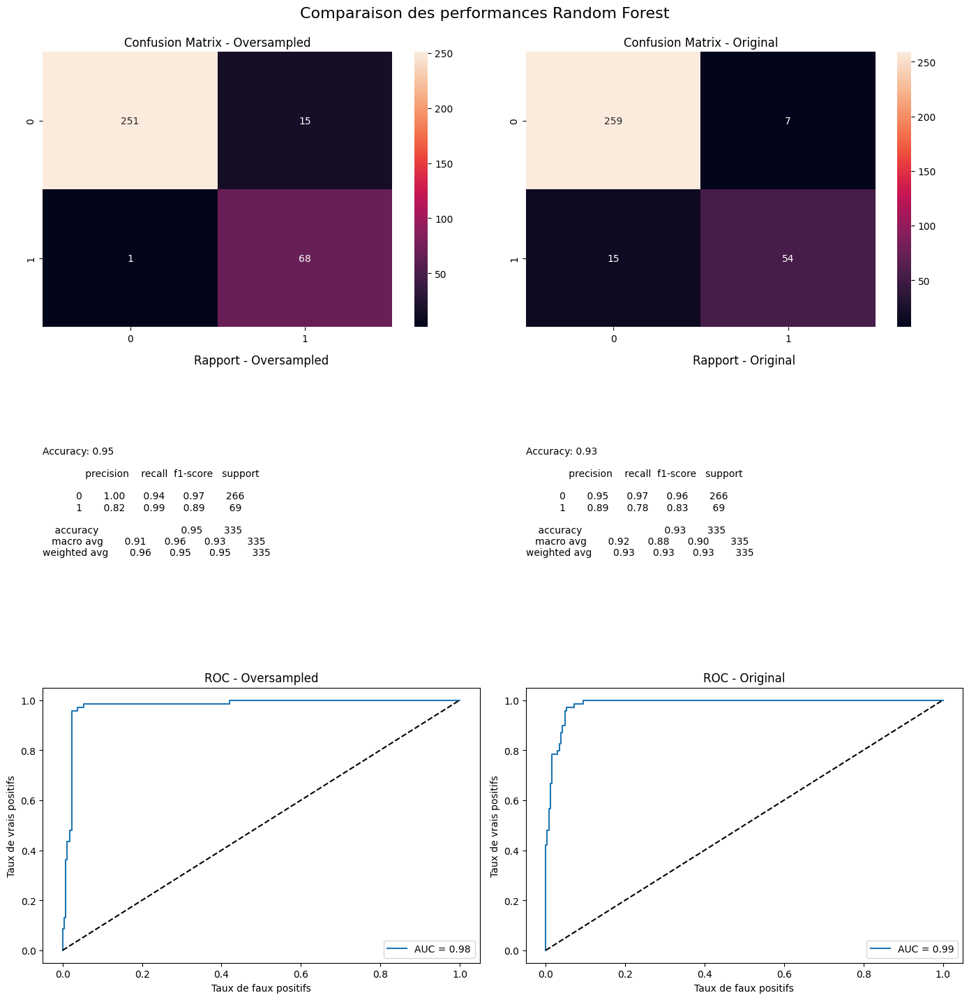

In [366]:
resampled_data_dict = {}

for oversampler in oversampler_dict.keys():
    print("Méthode d'over-sampling : ", oversampler)
    
    # Resampling des données
    X_resampled, y_resampled = oversampler_dict[oversampler].fit_resample(X_train, y_train)

    # Conversion en DataFrame si nécessaire
    if not isinstance(X_resampled, pd.DataFrame):
        X_resampled = pd.DataFrame(X_resampled, columns=X.columns)

    if isinstance(y_resampled, pd.DataFrame):
        y_resampled = y_resampled.iloc[:, 0]
    else:
        y_resampled = pd.Series(y_resampled, name='smoker')
    
    data_resampled = pd.concat([X_resampled, y_resampled], axis=1)

    # Sauvegarde pour éventuelle réutilisation
    resampled_data_dict[oversampler] = data_resampled
    
    # Visualisation comparative
    compare_smoker_distribution(data, data_resampled, title_suffix=f"({oversampler})")
    compare_pca_oversampling(data, {oversampler: data_resampled})

    # Comparaison de performance tout de suite après la visualisation
    print(f"\n####### COMPARAISON PERFORMANCE - MÉTHODE : {oversampler.upper()} #######")
    X_train_resampled = data_resampled.drop(columns='smoker')
    y_train_resampled = data_resampled['smoker']

    compare_random_forest_performance(
        X_train_orig=X_train, y_train_orig=y_train,
        X_train_res=X_train_resampled, y_train_res=y_train_resampled,
        X_test=X_test, y_test=y_test
    )


##### Naives bayes

In [367]:
def compare_Naives_bayes_performance(X_train_orig, y_train_orig,
                                      X_train_res, y_train_res,
                                      X_test, y_test, p=0):
    import matplotlib.pyplot as plt
    import seaborn as sns
    from sklearn.metrics import (
        accuracy_score, confusion_matrix,
        classification_report, roc_curve, auc
    )

    # Entraînement des deux modèles
    if p == 0 :
        print("=== Entraînement sur données suréchantillonnées ===")
    else : 
        print("=== Entraînement sur données sous-échantillonnées ===")

    model_resampled = naives_bayes_train(X_train_res, y_train_res)

    print("\n=== Entraînement sur données originales ===")
    model_original = naives_bayes_train(X_train_orig, y_train_orig)

    # Test des deux modèles
    ypred_res = model_resampled.predict(X_test)
    ypred_orig = model_original.predict(X_test)

    # ROC probas
    yproba_res = model_resampled.predict_proba(X_test)[:, 1]
    yproba_orig = model_original.predict_proba(X_test)[:, 1]

    # Confusion matrices
    conf_res = confusion_matrix(y_test, ypred_res)
    conf_orig = confusion_matrix(y_test, ypred_orig)

    # Metrics
    report_res = classification_report(y_test, ypred_res, output_dict=True)
    report_orig = classification_report(y_test, ypred_orig, output_dict=True)

    acc_res = accuracy_score(y_test, ypred_res)
    acc_orig = accuracy_score(y_test, ypred_orig)

    # Courbes ROC
    fpr_res, tpr_res, _ = roc_curve(y_test, yproba_res)
    fpr_orig, tpr_orig, _ = roc_curve(y_test, yproba_orig)
    auc_res = auc(fpr_res, tpr_res)
    auc_orig = auc(fpr_orig, tpr_orig)

    # ==== VISUALISATION ====
    fig, axes = plt.subplots(3, 2, figsize=(14, 14))

    # Matrices de confusion
    sns.heatmap(conf_res, annot=True, fmt='d', ax=axes[0, 0])
    if p ==0 :
        axes[0, 0].set_title("Confusion Matrix - Oversampled")
    else :
        axes[0, 0].set_title("Confusion Matrix - Undersampled") 
    sns.heatmap(conf_orig, annot=True, fmt='d', ax=axes[0, 1])
    axes[0, 1].set_title("Confusion Matrix - Original")

    # Accuracy + Rapport Classification
    axes[1, 0].axis('off')
    axes[1, 1].axis('off')
    axes[1, 0].text(0, 0.5, f"Accuracy: {acc_res:.2f}\n\n" + classification_report(y_test, ypred_res),
                   fontsize=10, va='center')
    axes[1, 1].text(0, 0.5, f"Accuracy: {acc_orig:.2f}\n\n" + classification_report(y_test, ypred_orig),
                   fontsize=10, va='center')
    if p==0:
        axes[1, 0].set_title("Rapport - Oversampled")
    else:
        axes[1, 0].set_title("Rapport - Undersampled")
        
    axes[1, 1].set_title("Rapport - Original")

    # Courbe ROC
    axes[2, 0].plot(fpr_res, tpr_res, label=f'AUC = {auc_res:.2f}')
    axes[2, 1].plot(fpr_orig, tpr_orig, label=f'AUC = {auc_orig:.2f}')
    for ax in axes[2]:
        ax.plot([0, 1], [0, 1], 'k--')
        ax.set_xlabel("Taux de faux positifs")
        ax.set_ylabel("Taux de vrais positifs")
        ax.legend()
    if p ==0 :
        axes[2, 0].set_title("ROC - Oversampled")
    else:
        axes[2, 0].set_title("ROC - Undersampled")
    axes[2, 1].set_title("ROC - Original")

    plt.tight_layout()
    plt.suptitle("Comparaison des performances Naives bayes", fontsize=16, y=1.02)
    plt.show()

Méthode d'over-sampling :  random


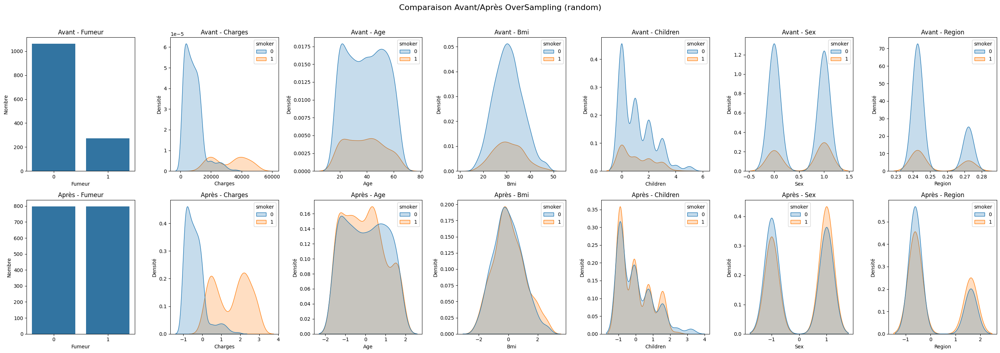

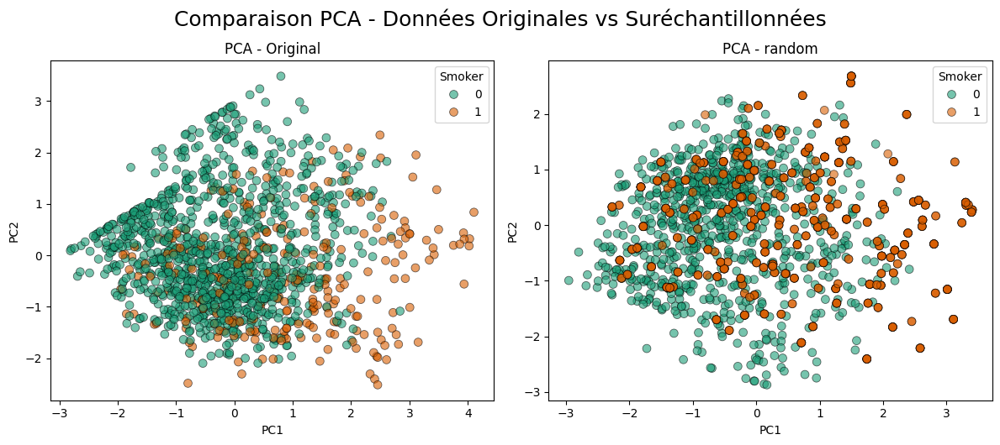


####### COMPARAISON PERFORMANCE - MÉTHODE : RANDOM #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.8920953575909661


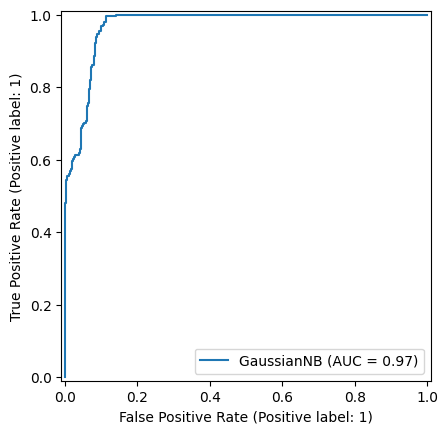

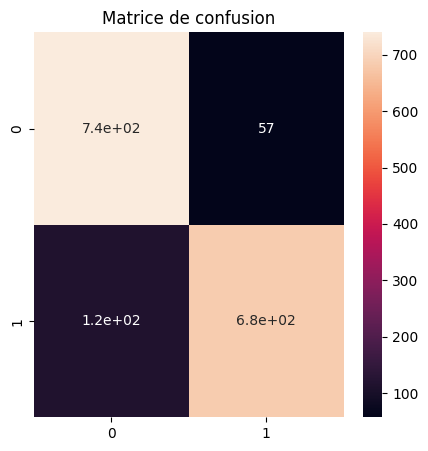

              precision    recall  f1-score   support

           0       0.87      0.93      0.90       797
           1       0.92      0.86      0.89       797

    accuracy                           0.89      1594
   macro avg       0.89      0.89      0.89      1594
weighted avg       0.89      0.89      0.89      1594


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


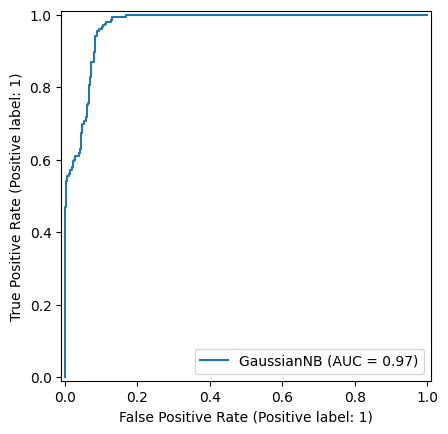

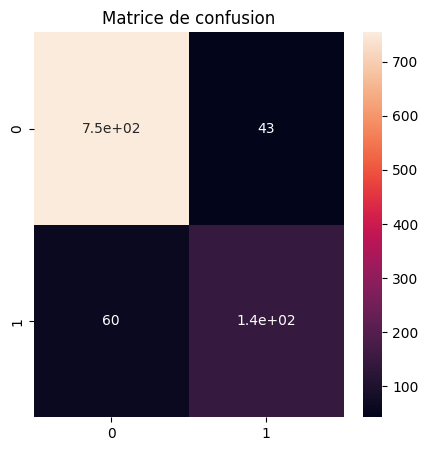

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


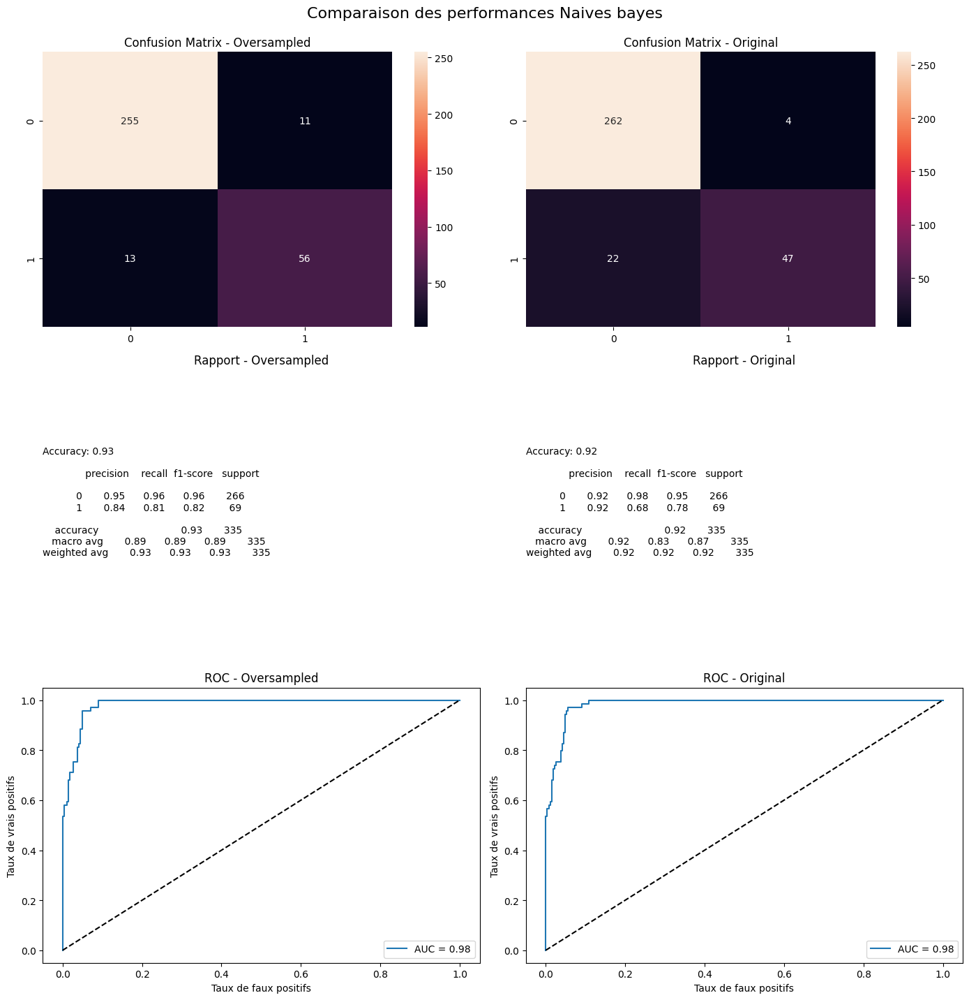

Méthode d'over-sampling :  smote


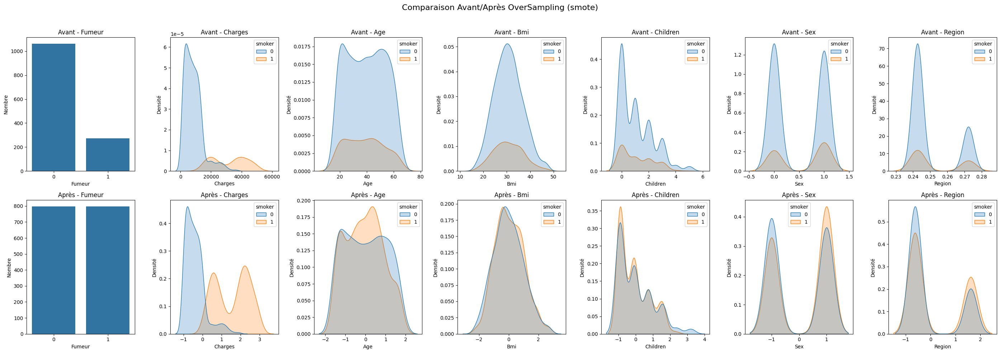

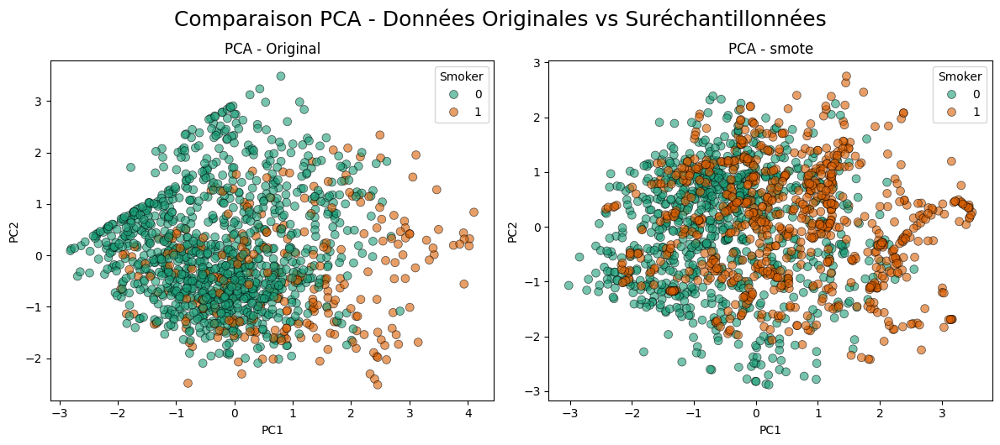


####### COMPARAISON PERFORMANCE - MÉTHODE : SMOTE #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.8983688833124216


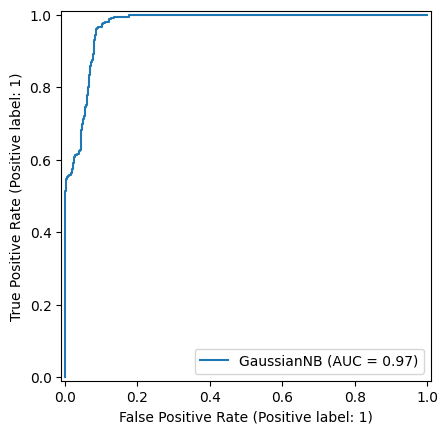

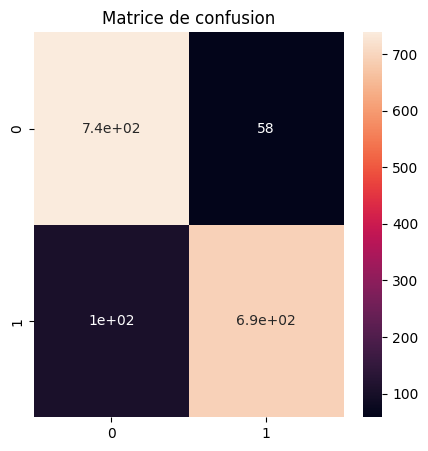

              precision    recall  f1-score   support

           0       0.88      0.93      0.90       797
           1       0.92      0.87      0.90       797

    accuracy                           0.90      1594
   macro avg       0.90      0.90      0.90      1594
weighted avg       0.90      0.90      0.90      1594


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


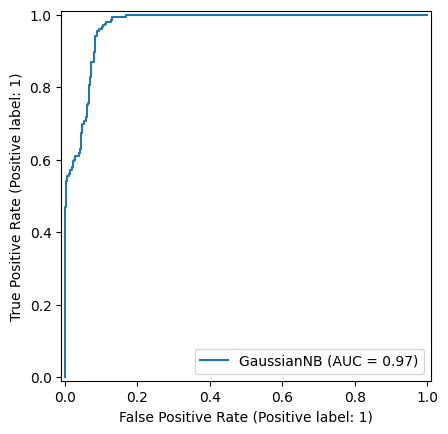

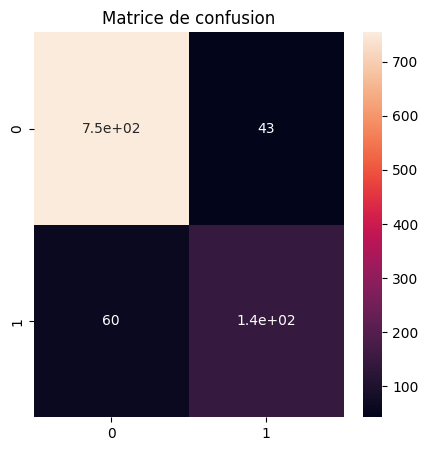

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


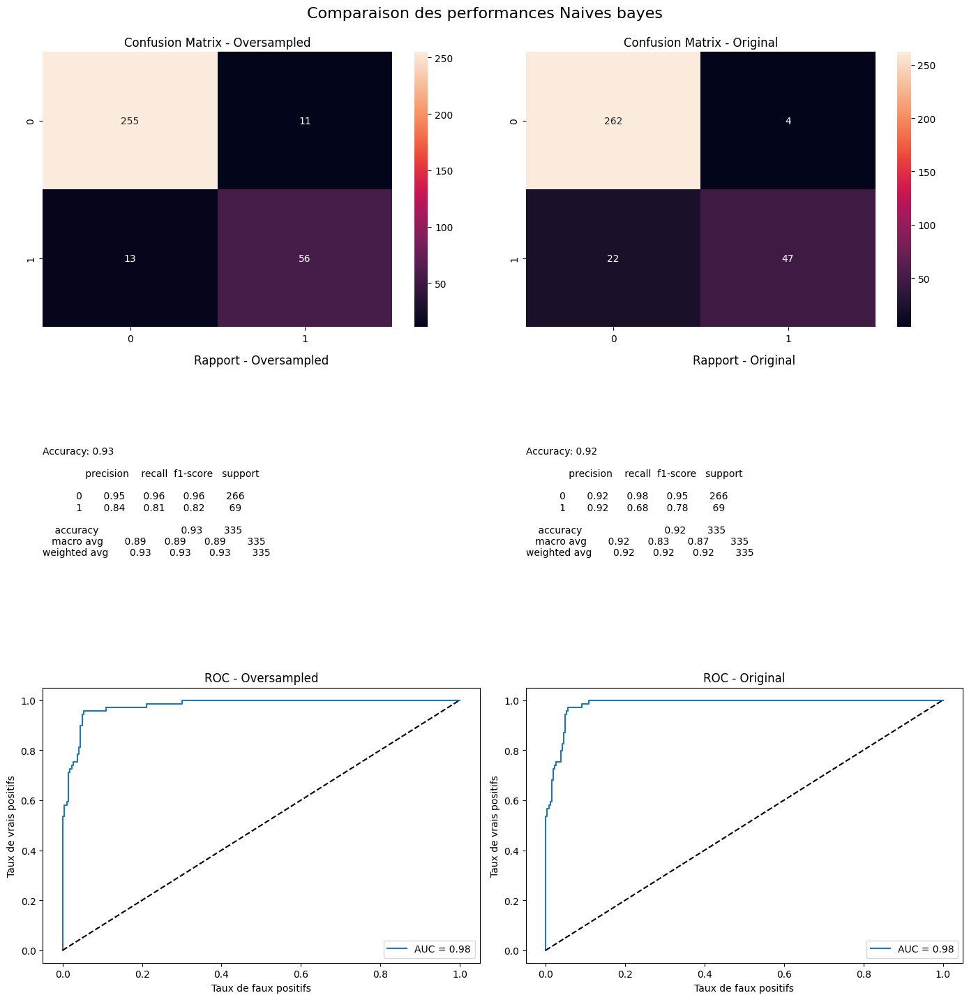

Méthode d'over-sampling :  adasyn


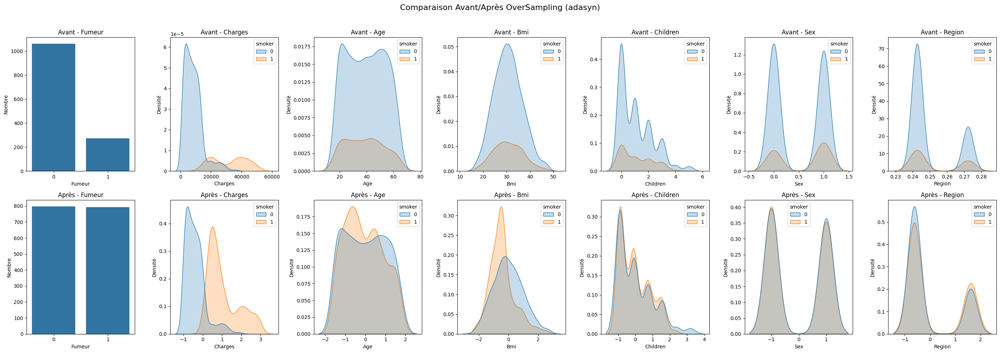

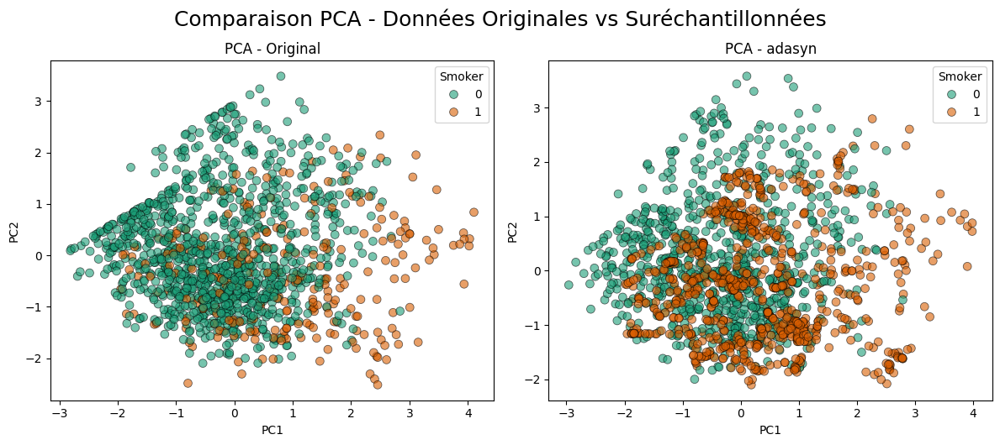


####### COMPARAISON PERFORMANCE - MÉTHODE : ADASYN #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9327044025157233


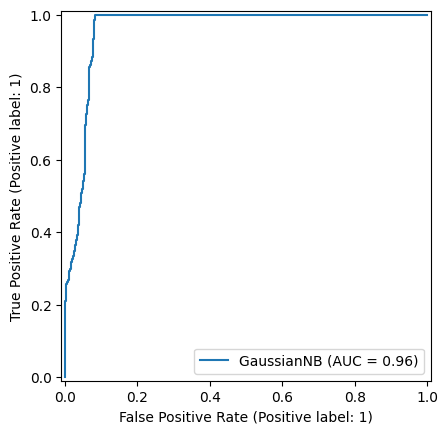

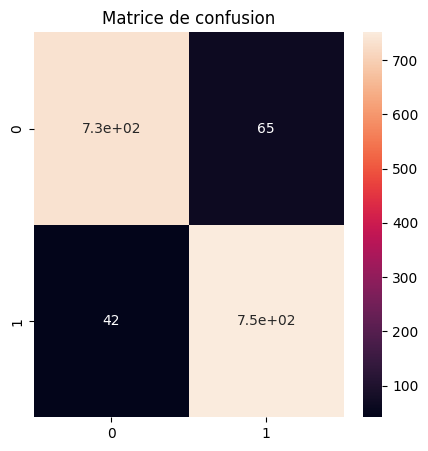

              precision    recall  f1-score   support

           0       0.95      0.92      0.93       797
           1       0.92      0.95      0.93       793

    accuracy                           0.93      1590
   macro avg       0.93      0.93      0.93      1590
weighted avg       0.93      0.93      0.93      1590


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


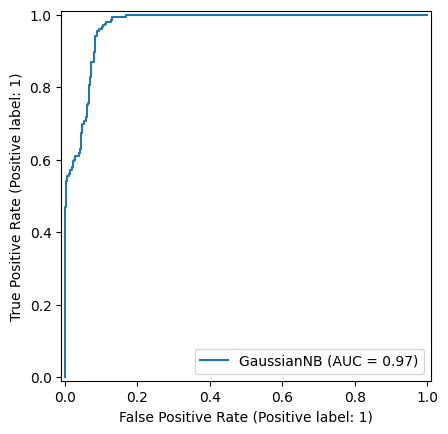

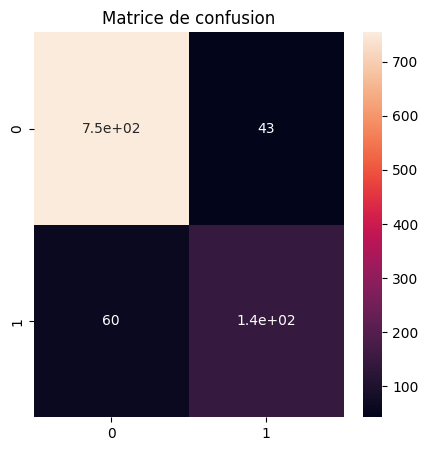

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


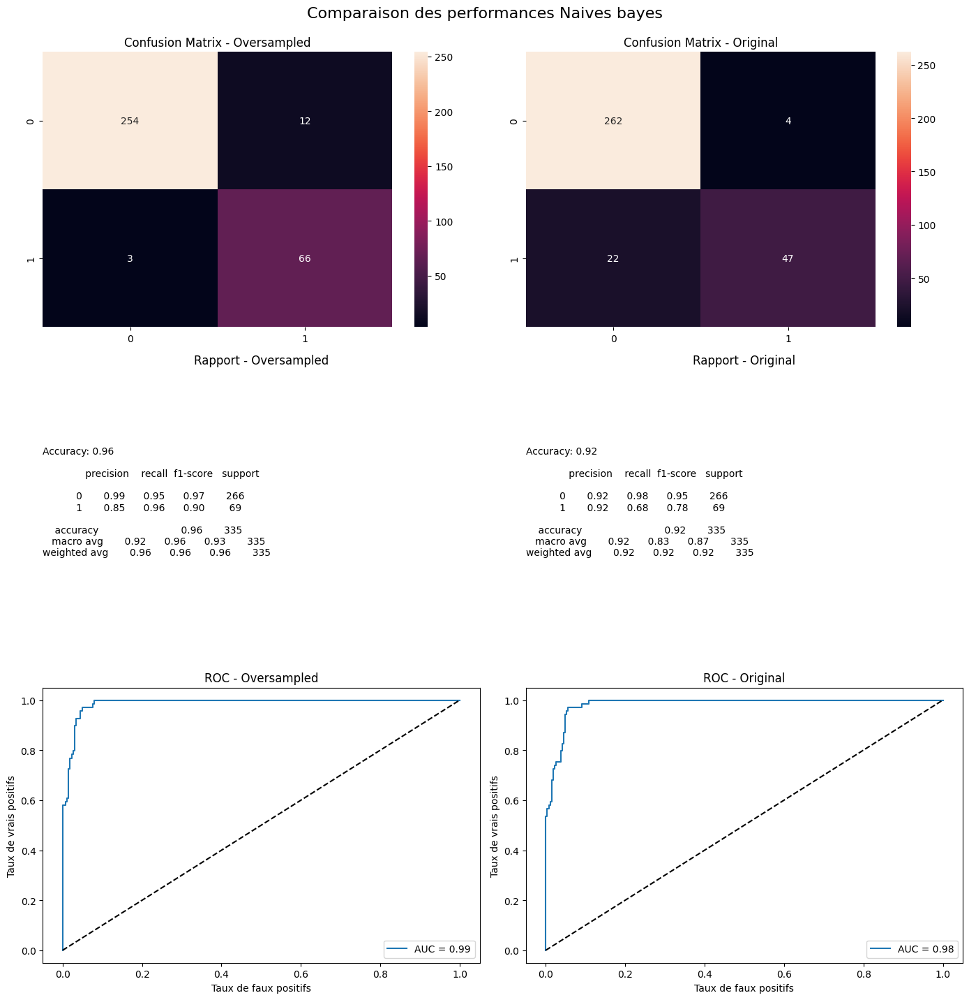

Méthode d'over-sampling :  border1


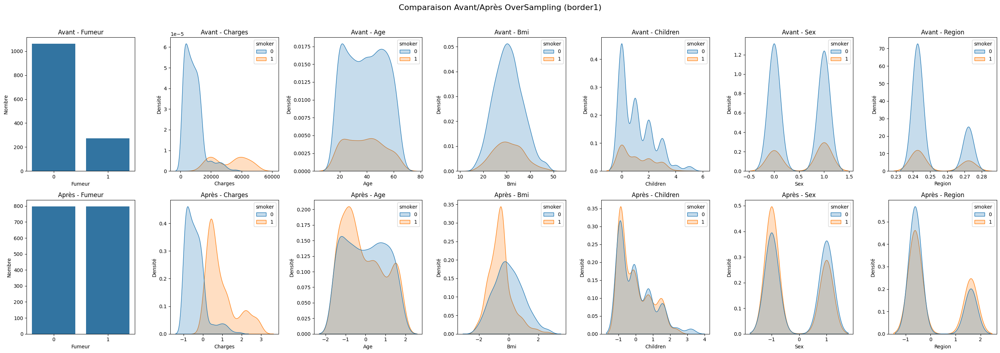

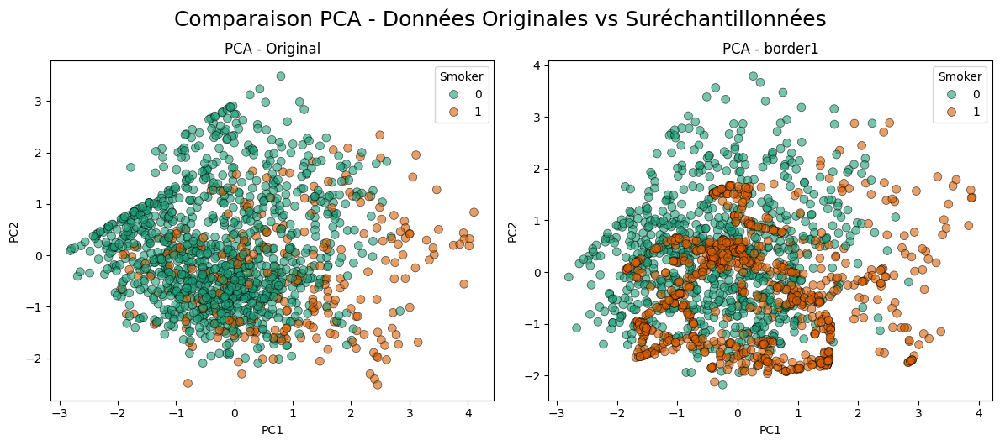


####### COMPARAISON PERFORMANCE - MÉTHODE : BORDER1 #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9466750313676286


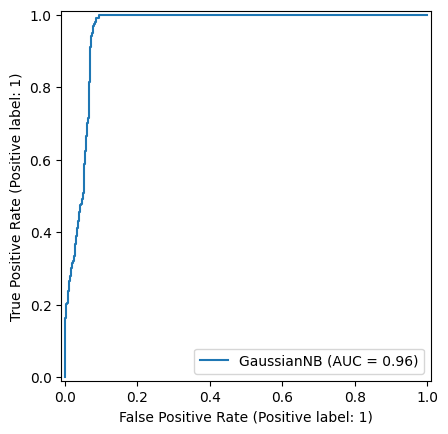

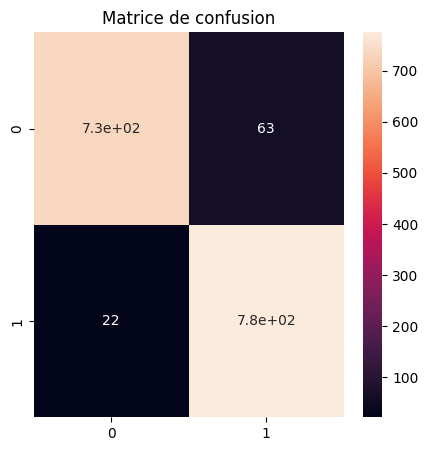

              precision    recall  f1-score   support

           0       0.97      0.92      0.95       797
           1       0.92      0.97      0.95       797

    accuracy                           0.95      1594
   macro avg       0.95      0.95      0.95      1594
weighted avg       0.95      0.95      0.95      1594


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


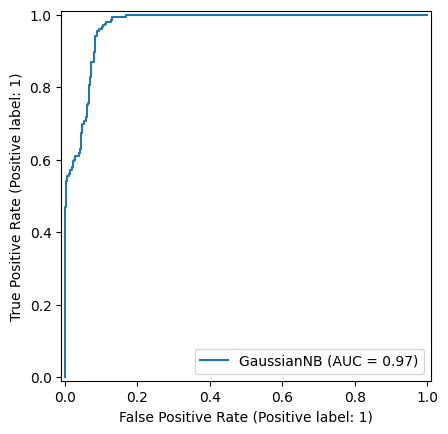

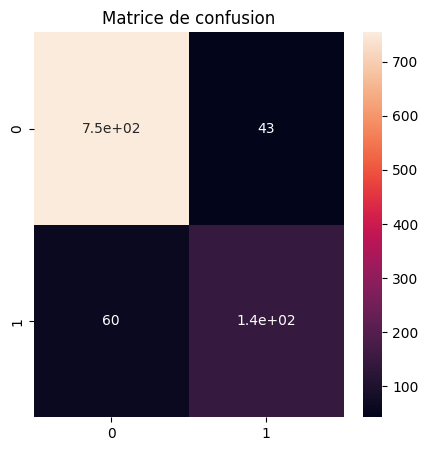

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


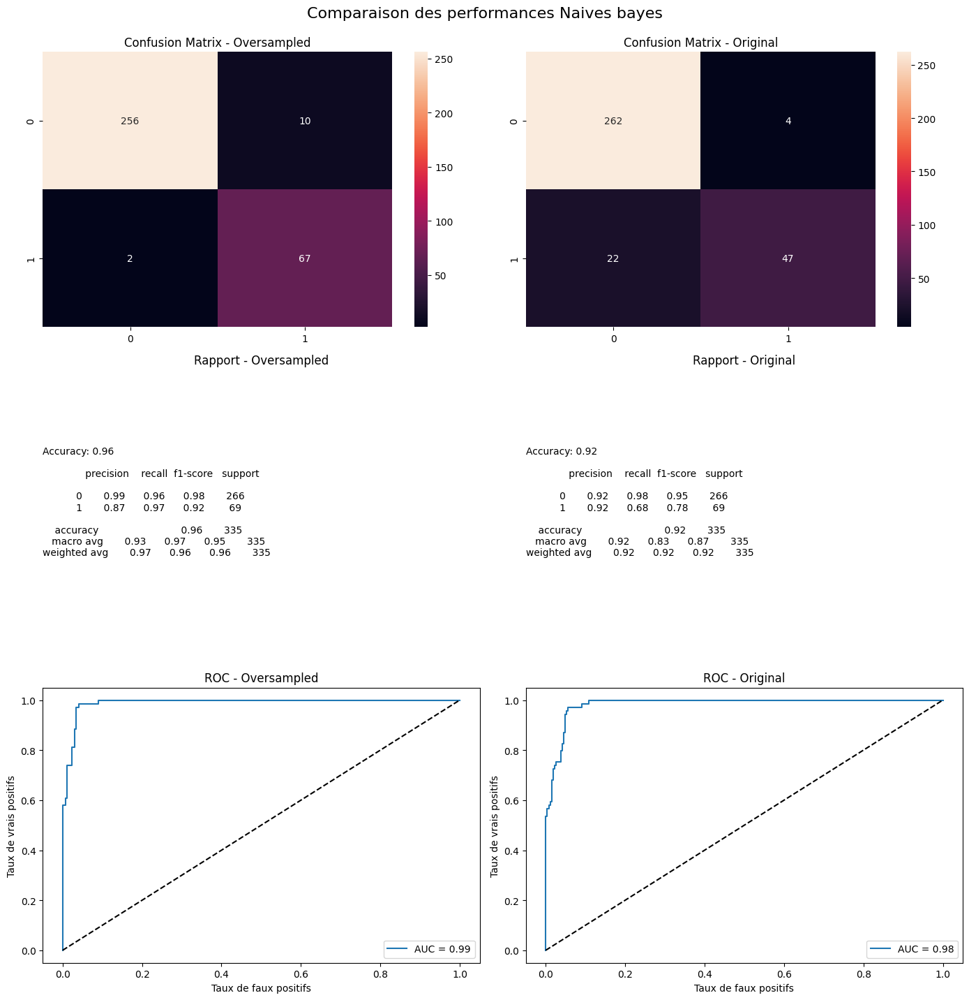

Méthode d'over-sampling :  border2


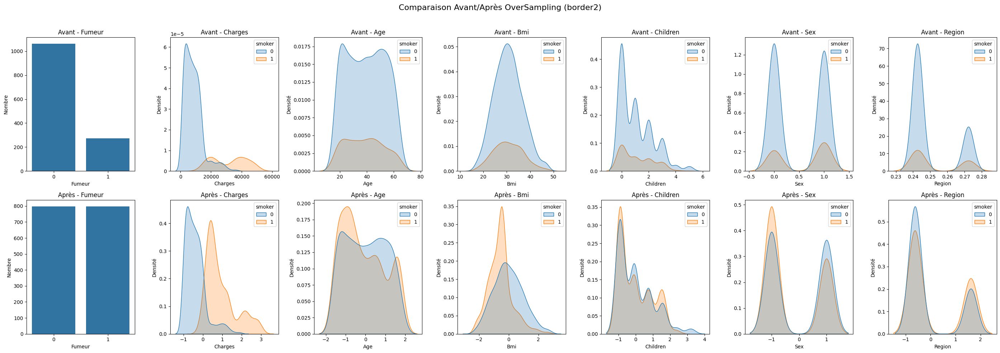

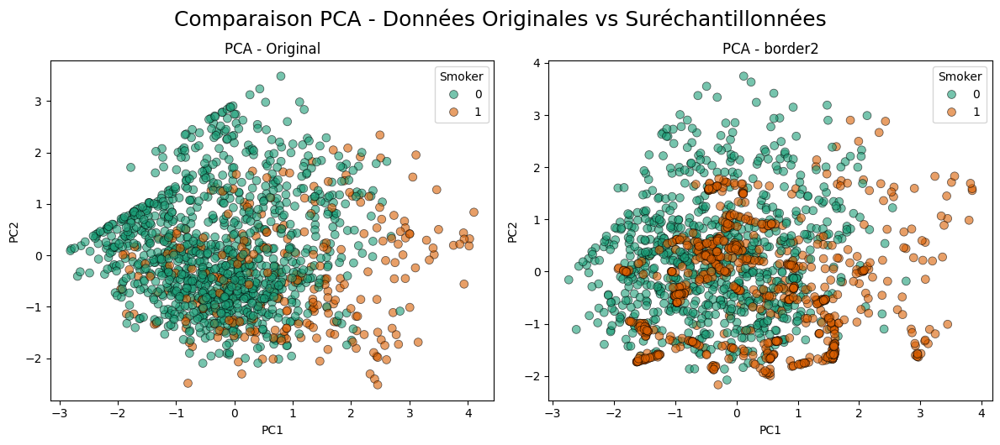


####### COMPARAISON PERFORMANCE - MÉTHODE : BORDER2 #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.939146800501882


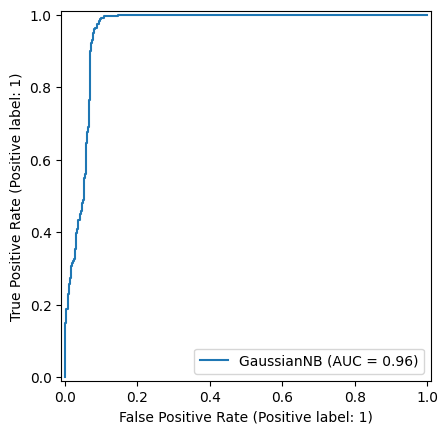

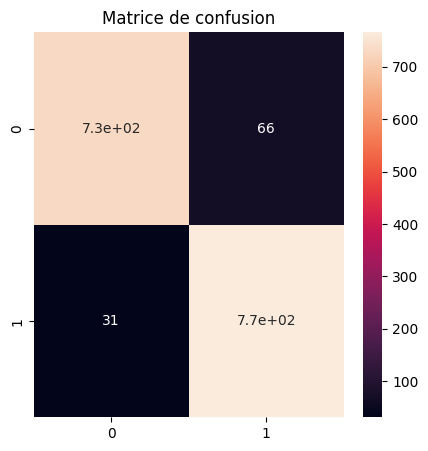

              precision    recall  f1-score   support

           0       0.96      0.92      0.94       797
           1       0.92      0.96      0.94       797

    accuracy                           0.94      1594
   macro avg       0.94      0.94      0.94      1594
weighted avg       0.94      0.94      0.94      1594


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


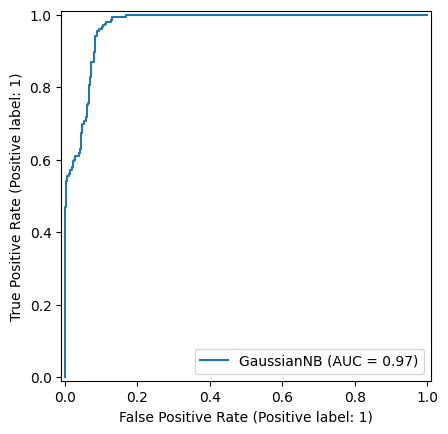

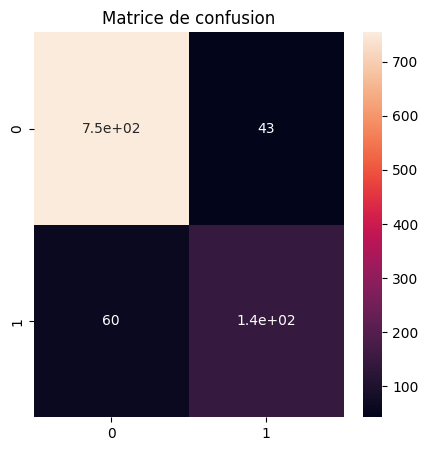

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


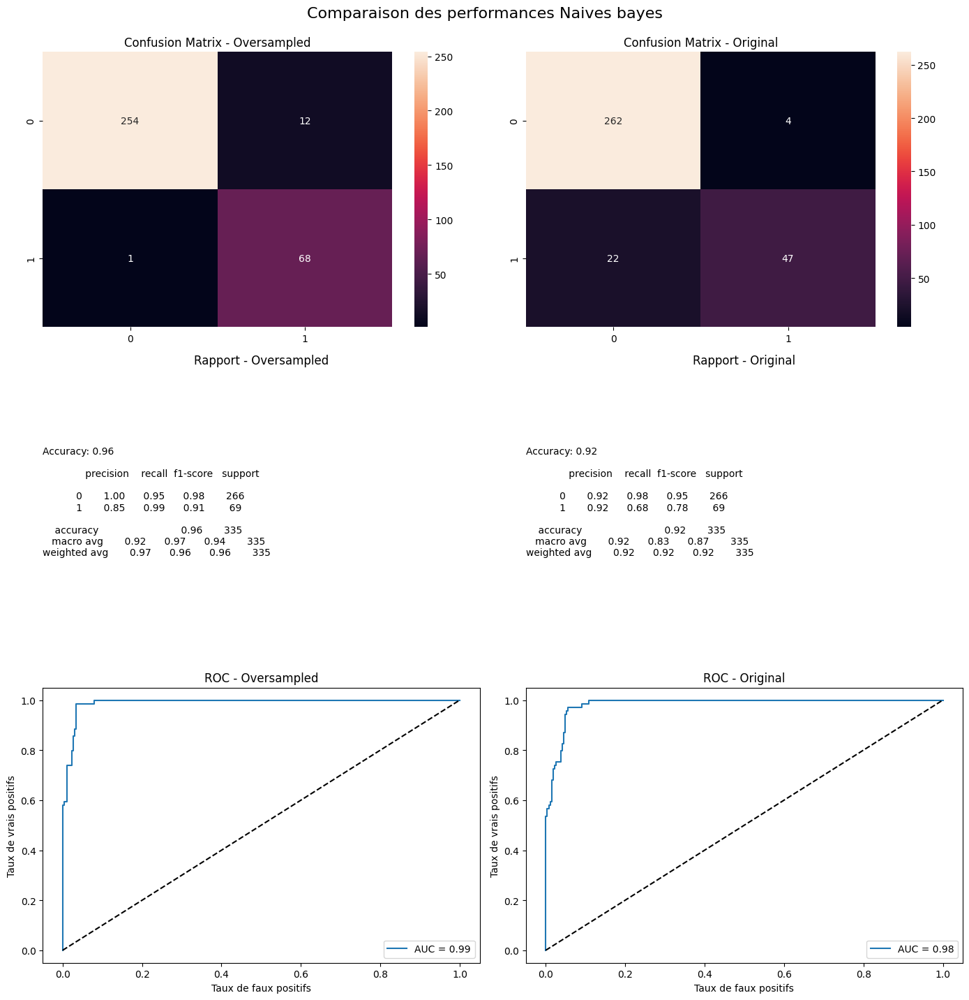

Méthode d'over-sampling :  svm


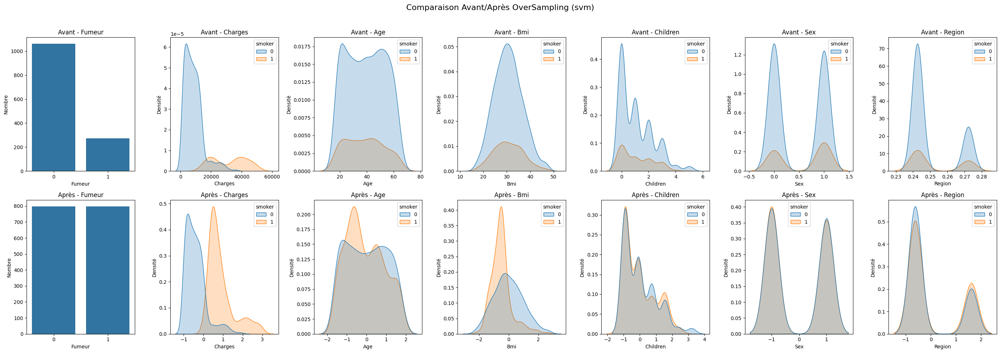

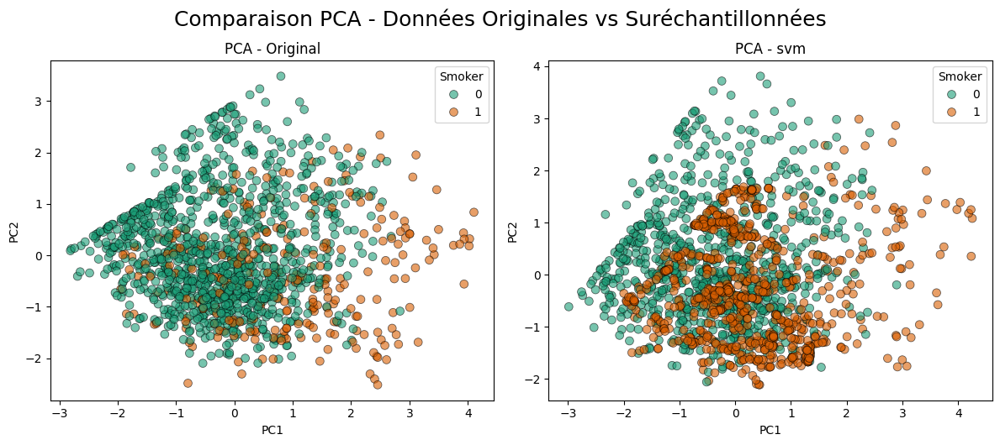


####### COMPARAISON PERFORMANCE - MÉTHODE : SVM #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9498117942283564


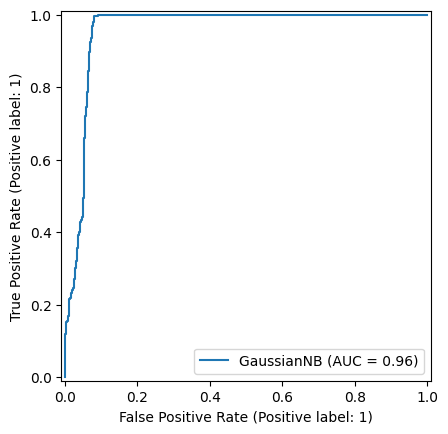

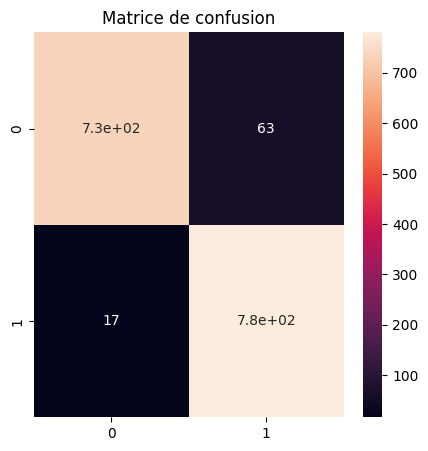

              precision    recall  f1-score   support

           0       0.98      0.92      0.95       797
           1       0.93      0.98      0.95       797

    accuracy                           0.95      1594
   macro avg       0.95      0.95      0.95      1594
weighted avg       0.95      0.95      0.95      1594


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


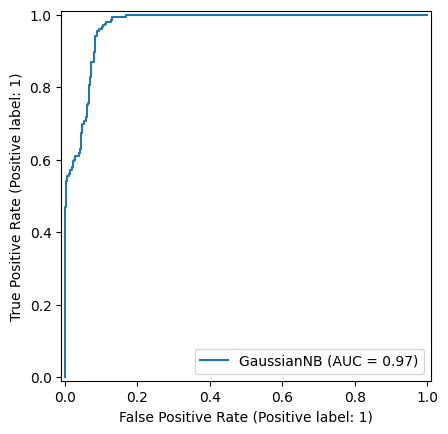

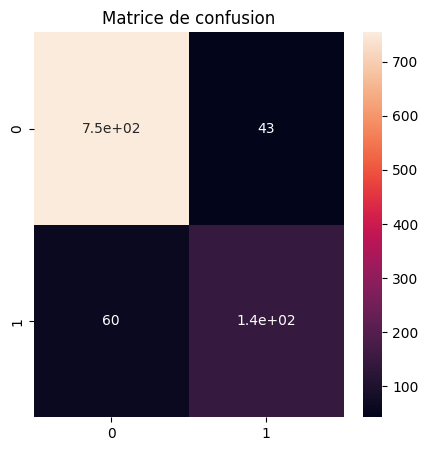

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


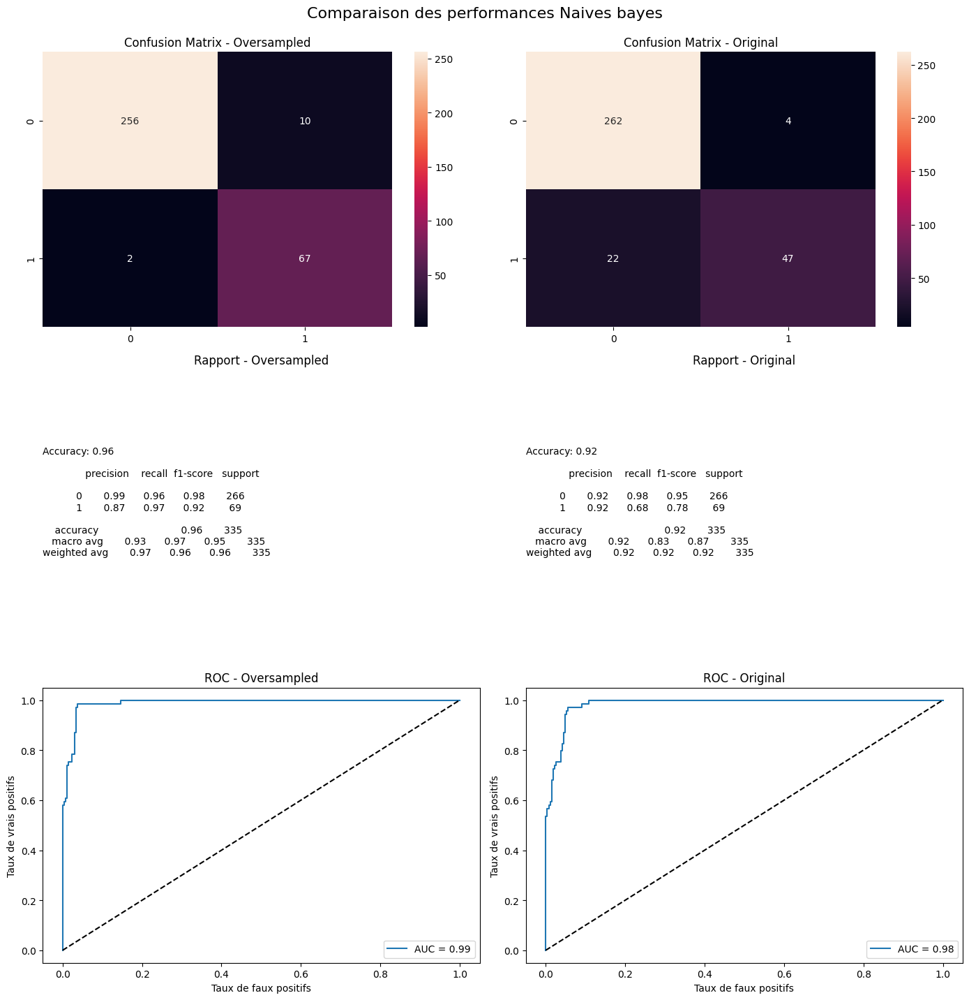

In [368]:
resampled_data_dict = {}

for oversampler in oversampler_dict.keys():
    print("Méthode d'over-sampling : ", oversampler)
    
    # Resampling des données
    X_resampled, y_resampled = oversampler_dict[oversampler].fit_resample(X_train, y_train)

    # Conversion en DataFrame si nécessaire
    if not isinstance(X_resampled, pd.DataFrame):
        X_resampled = pd.DataFrame(X_resampled, columns=X.columns)

    if isinstance(y_resampled, pd.DataFrame):
        y_resampled = y_resampled.iloc[:, 0]
    else:
        y_resampled = pd.Series(y_resampled, name='smoker')
    
    data_resampled = pd.concat([X_resampled, y_resampled], axis=1)

    # Sauvegarde pour éventuelle réutilisation
    resampled_data_dict[oversampler] = data_resampled
    
    # Visualisation comparative
    compare_smoker_distribution(data, data_resampled, title_suffix=f"({oversampler})")
    compare_pca_oversampling(data, {oversampler: data_resampled})

    # Comparaison de performance tout de suite après la visualisation
    print(f"\n####### COMPARAISON PERFORMANCE - MÉTHODE : {oversampler.upper()} #######")
    X_train_resampled = data_resampled.drop(columns='smoker')
    y_train_resampled = data_resampled['smoker']

    compare_Naives_bayes_performance(
        X_train_orig=X_train, y_train_orig=y_train,
        X_train_res=X_train_resampled, y_train_res=y_train_resampled,
        X_test=X_test, y_test=y_test
    )


##### Xgboost

In [369]:
def compare_xgboost_performance(X_train_orig, y_train_orig,
                                 X_train_res, y_train_res,
                                 X_test, y_test, p=0):
    import matplotlib.pyplot as plt
    import seaborn as sns
    from sklearn.metrics import (
        accuracy_score, confusion_matrix,
        classification_report, roc_curve, auc
    )

    # Entraînement des deux modèles
    if p == 0 :
        print("=== Entraînement sur données suréchantillonnées ===")
    else : 
        print("=== Entraînement sur données sous-échantillonnées ===")
    model_resampled = xgboost_train(X_train_res, y_train_res)

    print("\n=== Entraînement sur données originales ===")
    model_original = xgboost_train(X_train_orig, y_train_orig)

    # Conversion de X_test en DMatrix pour la prédiction, avec les noms de colonnes
    D_test = xgb.DMatrix(X_test, feature_names=list(X.columns))

    # Prédictions
    yproba_res = model_resampled.predict(D_test)
    yproba_orig = model_original.predict(D_test)

    ypred_res = np.argmax(yproba_res, axis=1)
    ypred_orig = np.argmax(yproba_orig, axis=1)

    # Confusion matrices
    conf_res = confusion_matrix(y_test, ypred_res)
    conf_orig = confusion_matrix(y_test, ypred_orig)

    # Metrics
    acc_res = accuracy_score(y_test, ypred_res)
    acc_orig = accuracy_score(y_test, ypred_orig)

    # Courbes ROC (avec les probabilités de la classe 1)
    fpr_res, tpr_res, _ = roc_curve(y_test, yproba_res[:, 1])
    fpr_orig, tpr_orig, _ = roc_curve(y_test, yproba_orig[:, 1])
    auc_res = auc(fpr_res, tpr_res)
    auc_orig = auc(fpr_orig, tpr_orig)

    # ==== VISUALISATION ====
    fig, axes = plt.subplots(3, 2, figsize=(14, 14))

    # Matrices de confusion
    sns.heatmap(conf_res, annot=True, fmt='d', ax=axes[0, 0])
    if p ==0 :
        axes[0, 0].set_title("Confusion Matrix - Oversampled")
    else :
        axes[0, 0].set_title("Confusion Matrix - Undersampled") 
    sns.heatmap(conf_orig, annot=True, fmt='d', ax=axes[0, 1])
    axes[0, 1].set_title("Confusion Matrix - Original")

    # Accuracy + Rapport Classification
    axes[1, 0].axis('off')
    axes[1, 1].axis('off')
    axes[1, 0].text(0, 0.5, f"Accuracy: {acc_res:.2f}\n\n" + classification_report(y_test, ypred_res),
                   fontsize=10, va='center')
    axes[1, 1].text(0, 0.5, f"Accuracy: {acc_orig:.2f}\n\n" + classification_report(y_test, ypred_orig),
                   fontsize=10, va='center')
    if p==0:
        axes[1, 0].set_title("Rapport - Oversampled")
    else:
        axes[1, 0].set_title("Rapport - Undersampled")
    axes[1, 1].set_title("Rapport - Original")

    # Courbe ROC
    axes[2, 0].plot(fpr_res, tpr_res, label=f'AUC = {auc_res:.2f}')
    axes[2, 1].plot(fpr_orig, tpr_orig, label=f'AUC = {auc_orig:.2f}')
    for ax in axes[2]:
        ax.plot([0, 1], [0, 1], 'k--')
        ax.set_xlabel("Taux de faux positifs")
        ax.set_ylabel("Taux de vrais positifs")
        ax.legend()
    if p ==0 :
        axes[2, 0].set_title("ROC - Oversampled")
    else:
        axes[2, 0].set_title("ROC - Undersampled")
    axes[2, 1].set_title("ROC - Original")

    plt.tight_layout()
    plt.suptitle("Comparaison des performances XGBoost", fontsize=16, y=1.02)
    plt.show()


Méthode d'over-sampling :  random


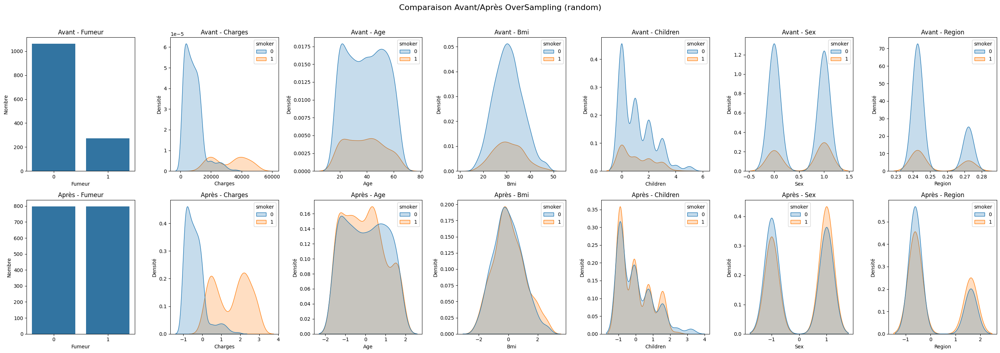

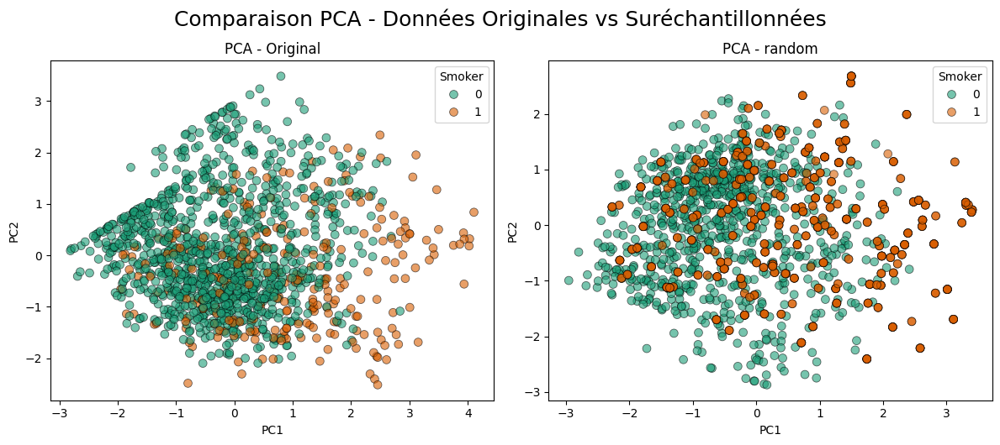


####### COMPARAISON PERFORMANCE - MÉTHODE : RANDOM #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9755332496863237


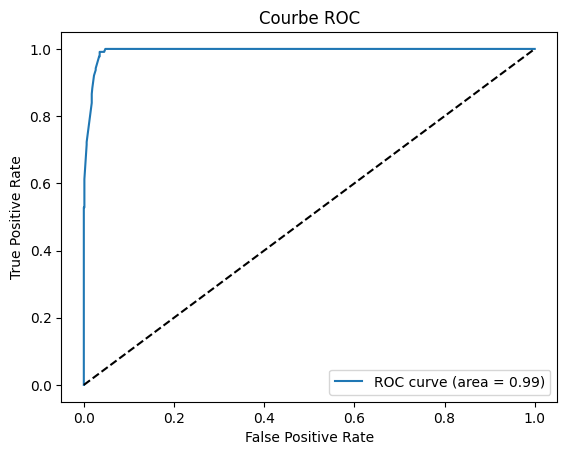

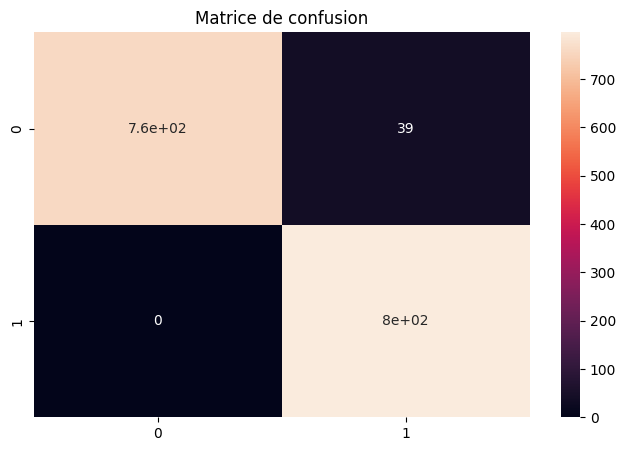

              precision    recall  f1-score   support

           0       1.00      0.95      0.97       797
           1       0.95      1.00      0.98       797

    accuracy                           0.98      1594
   macro avg       0.98      0.98      0.98      1594
weighted avg       0.98      0.98      0.98      1594


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


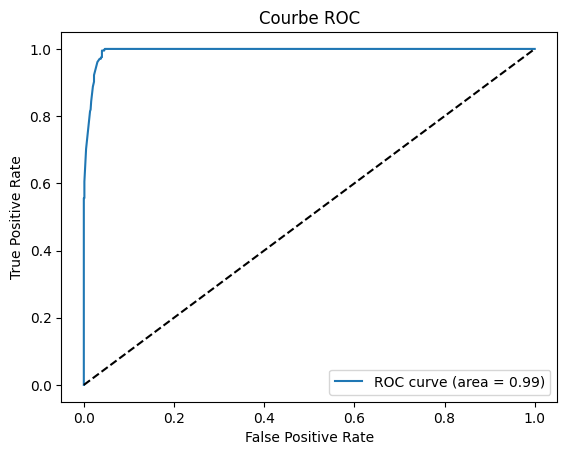

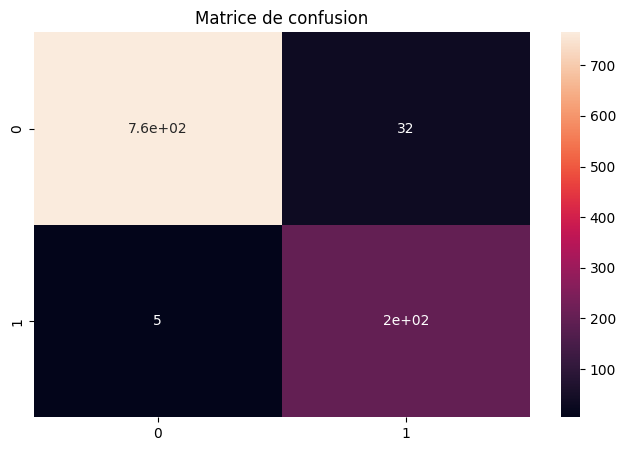

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



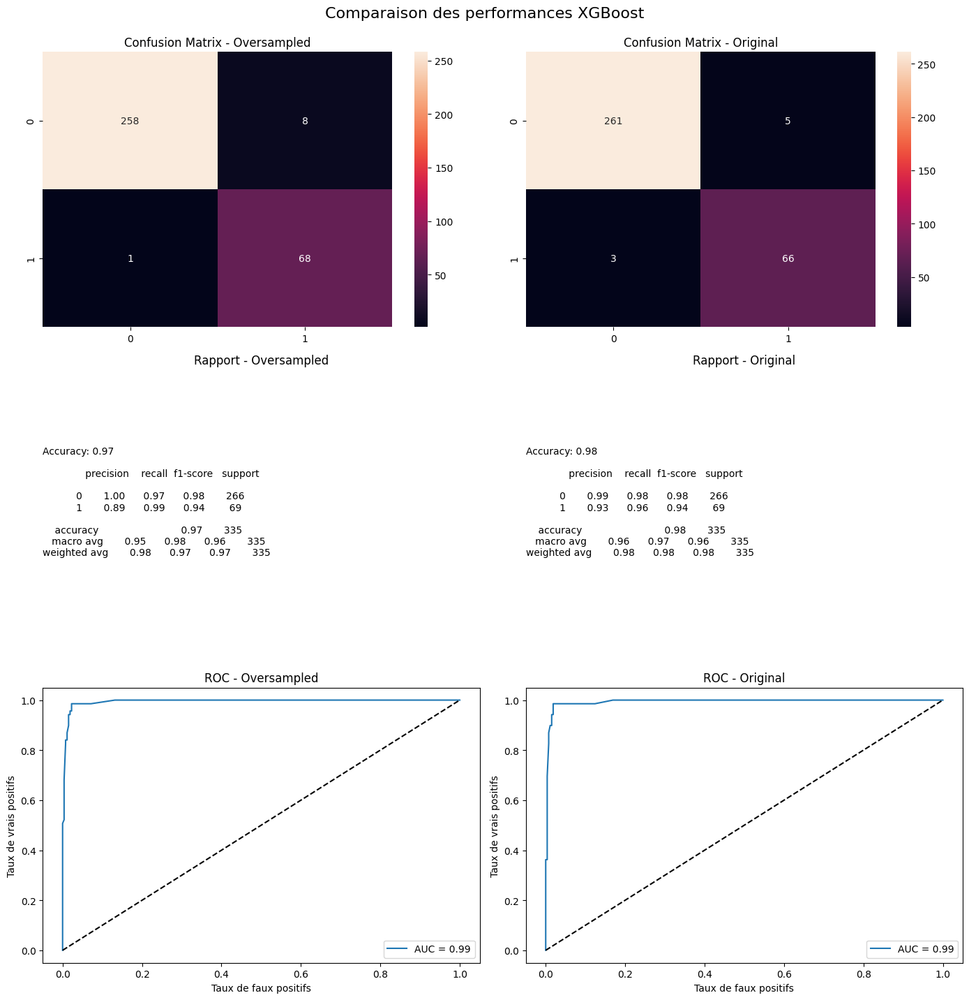

Méthode d'over-sampling :  smote


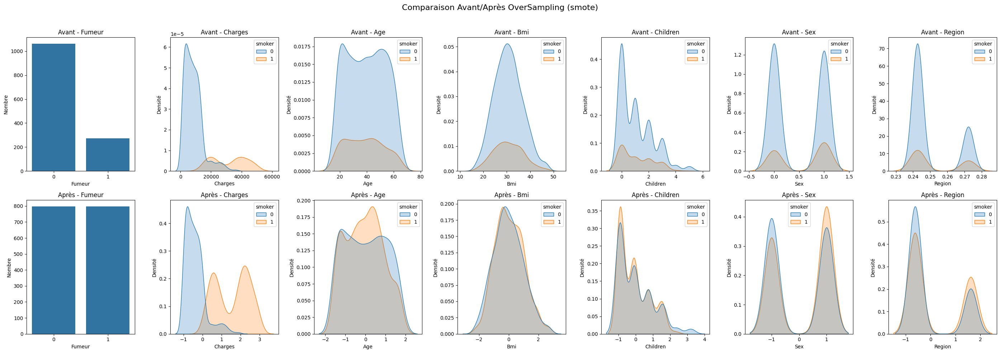

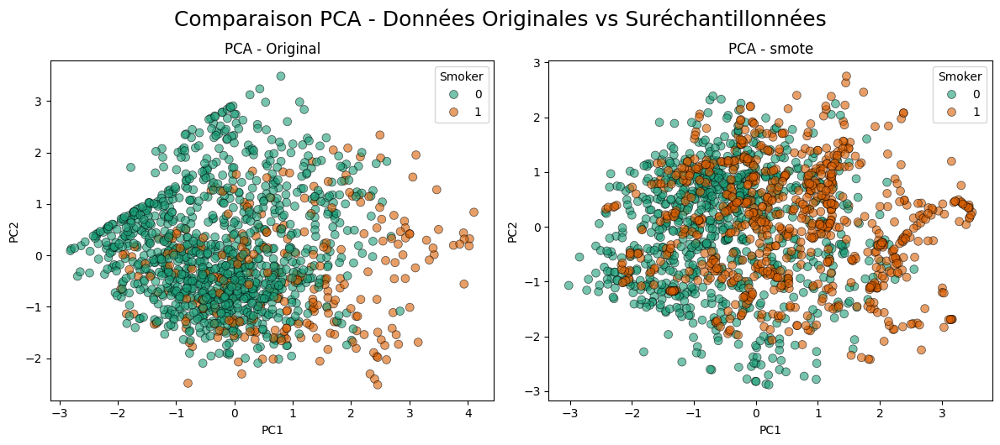


####### COMPARAISON PERFORMANCE - MÉTHODE : SMOTE #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.973651191969887


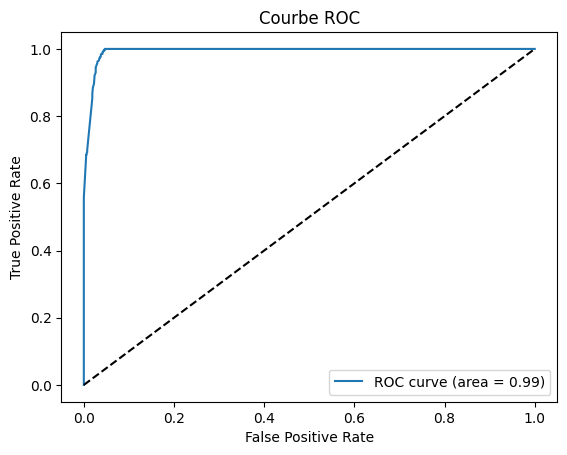

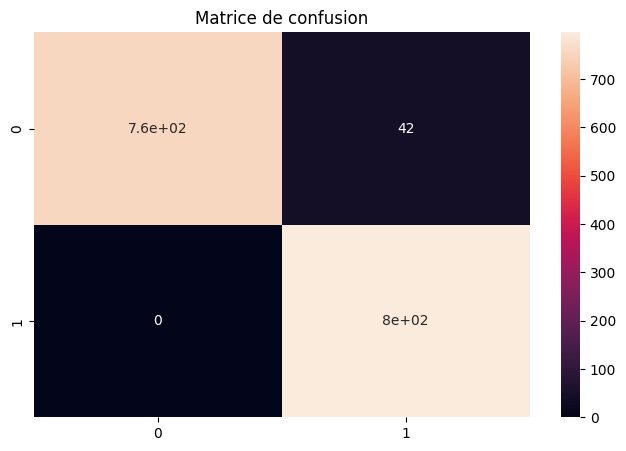

              precision    recall  f1-score   support

           0       1.00      0.95      0.97       797
           1       0.95      1.00      0.97       797

    accuracy                           0.97      1594
   macro avg       0.97      0.97      0.97      1594
weighted avg       0.97      0.97      0.97      1594


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


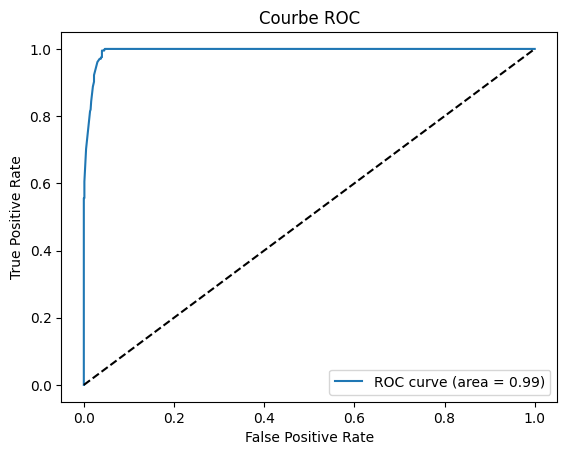

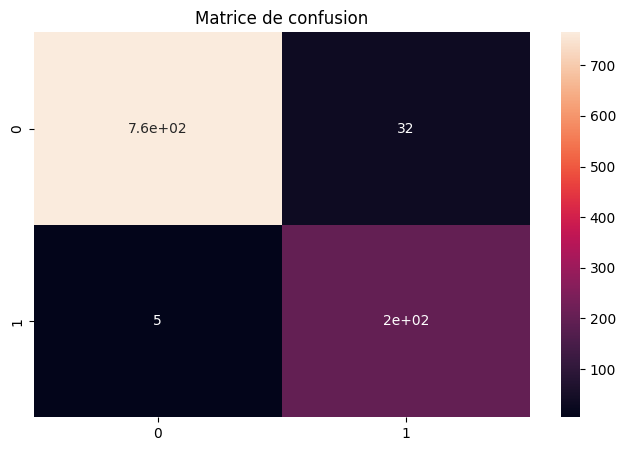

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



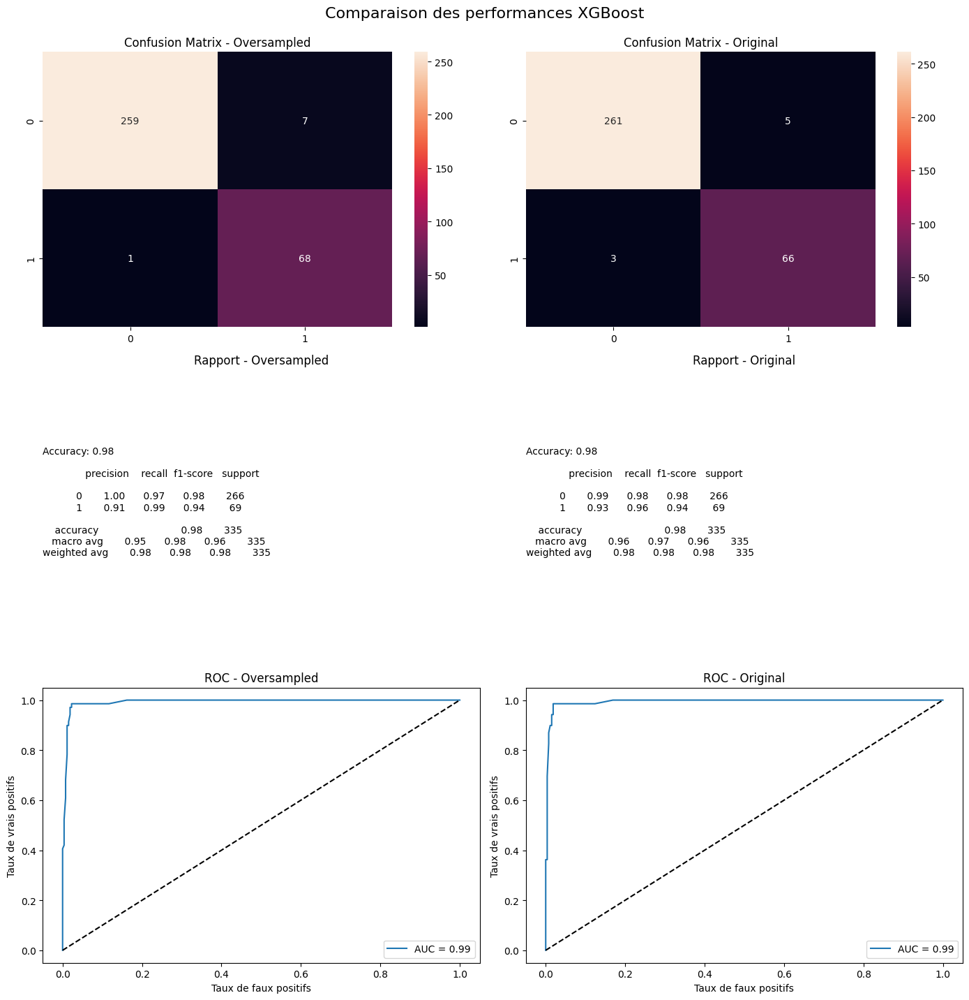

Méthode d'over-sampling :  adasyn


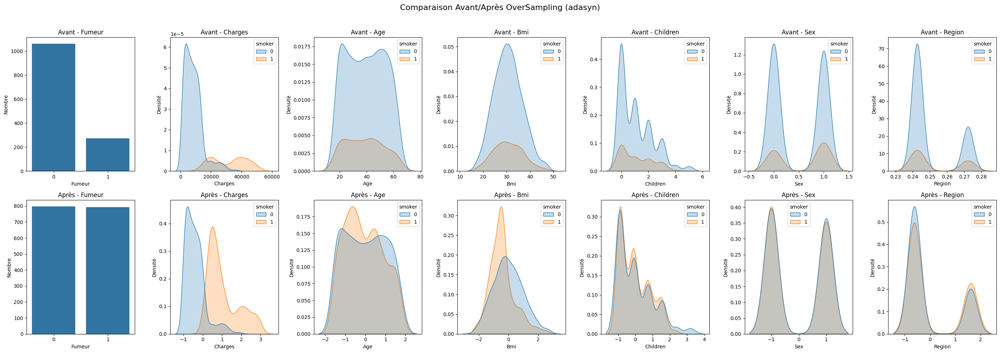

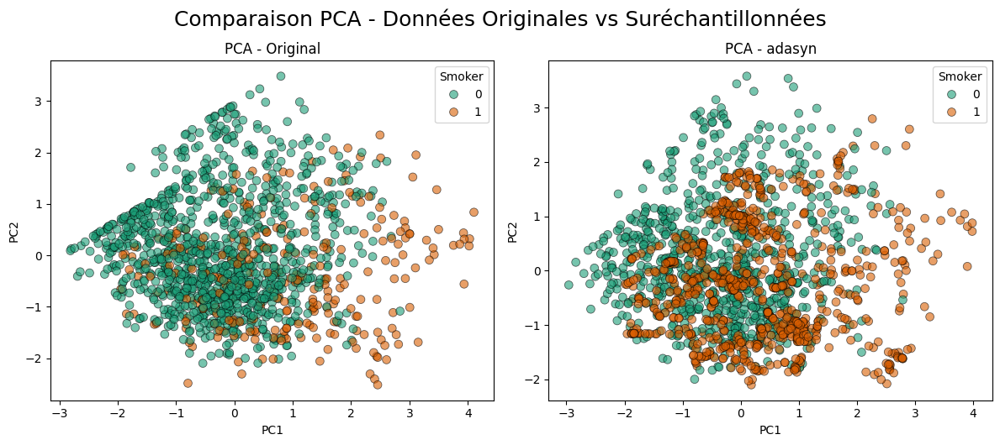


####### COMPARAISON PERFORMANCE - MÉTHODE : ADASYN #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9748427672955975


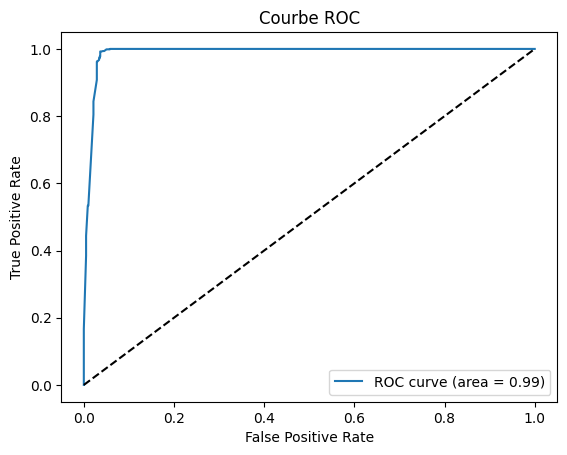

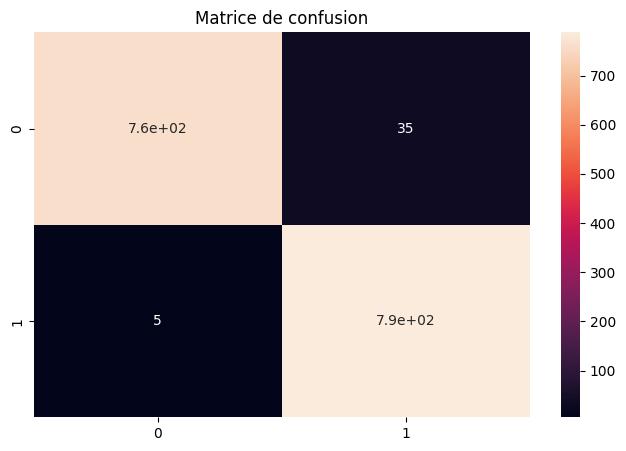

              precision    recall  f1-score   support

           0       0.99      0.96      0.97       797
           1       0.96      0.99      0.98       793

    accuracy                           0.97      1590
   macro avg       0.98      0.97      0.97      1590
weighted avg       0.98      0.97      0.97      1590


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


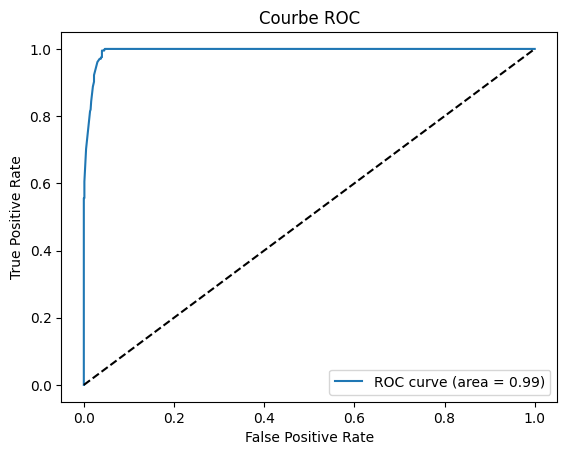

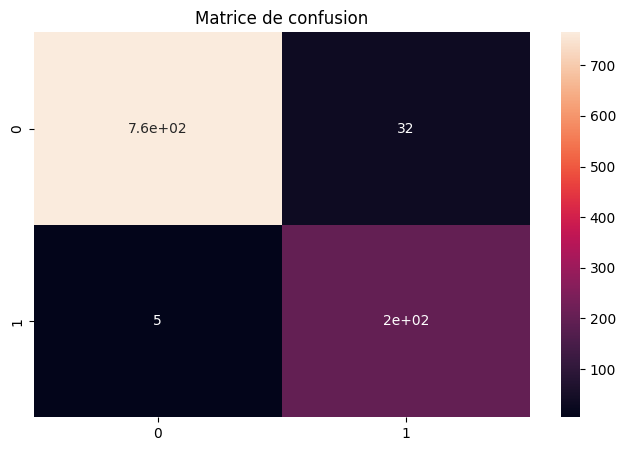

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



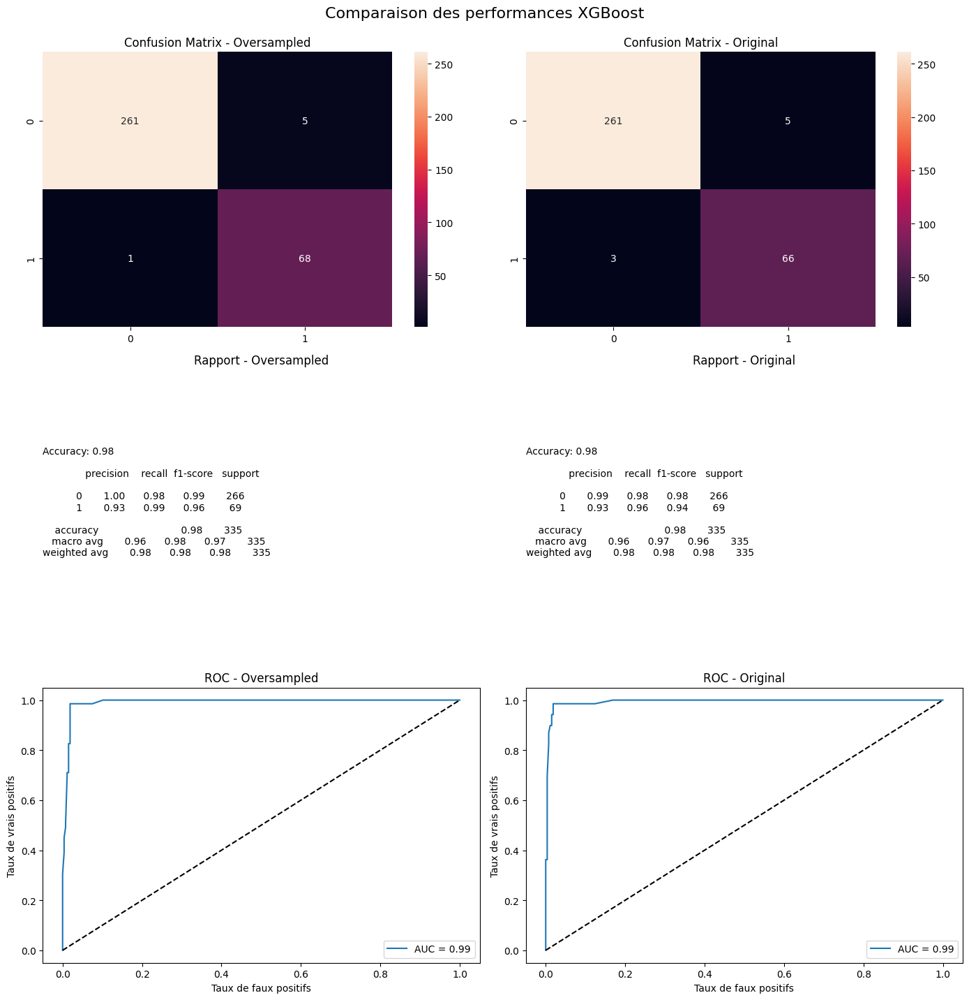

Méthode d'over-sampling :  border1


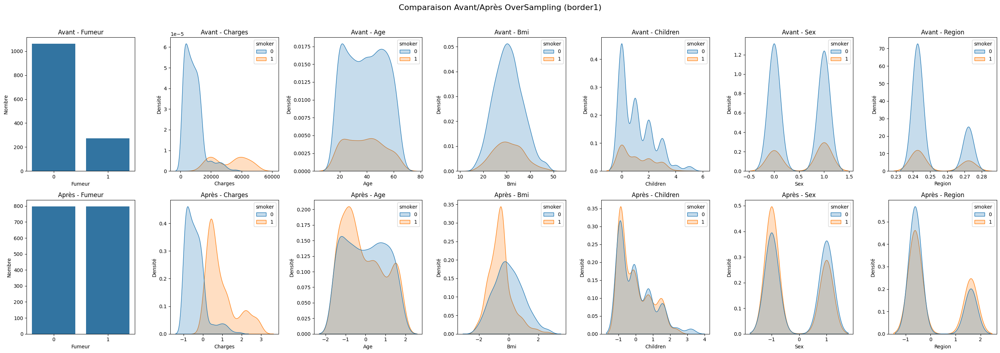

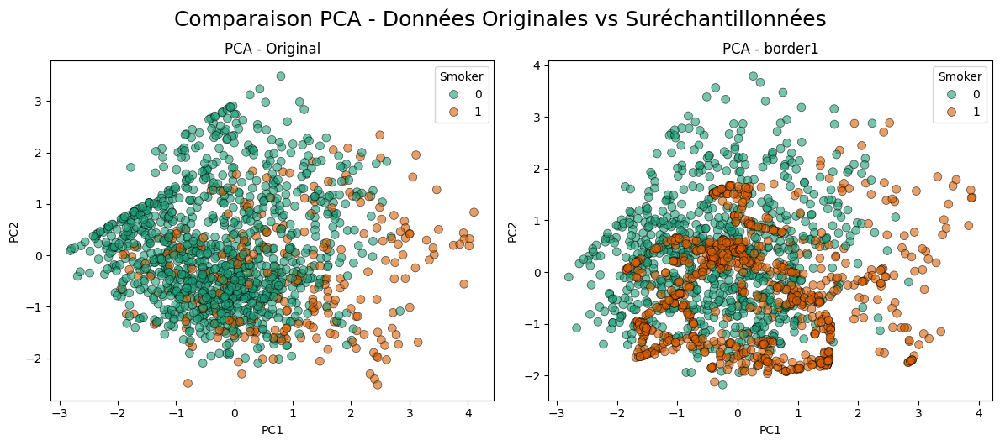


####### COMPARAISON PERFORMANCE - MÉTHODE : BORDER1 #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9767879548306148


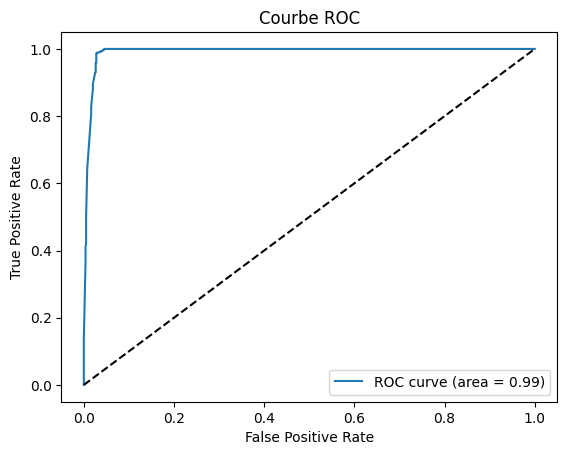

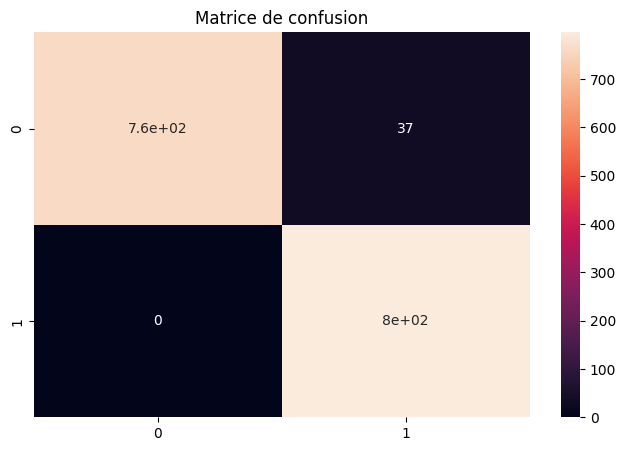

              precision    recall  f1-score   support

           0       1.00      0.95      0.98       797
           1       0.96      1.00      0.98       797

    accuracy                           0.98      1594
   macro avg       0.98      0.98      0.98      1594
weighted avg       0.98      0.98      0.98      1594


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


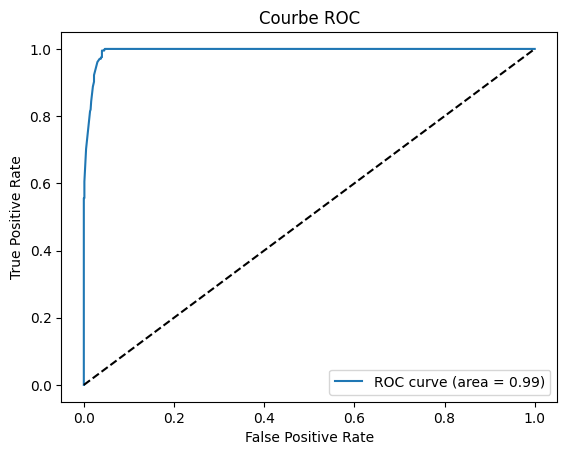

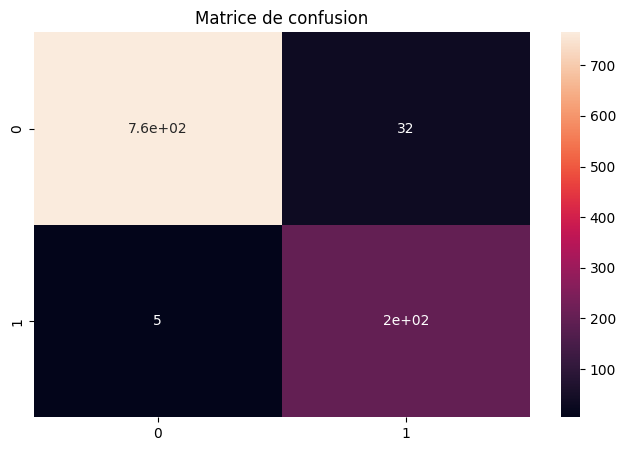

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



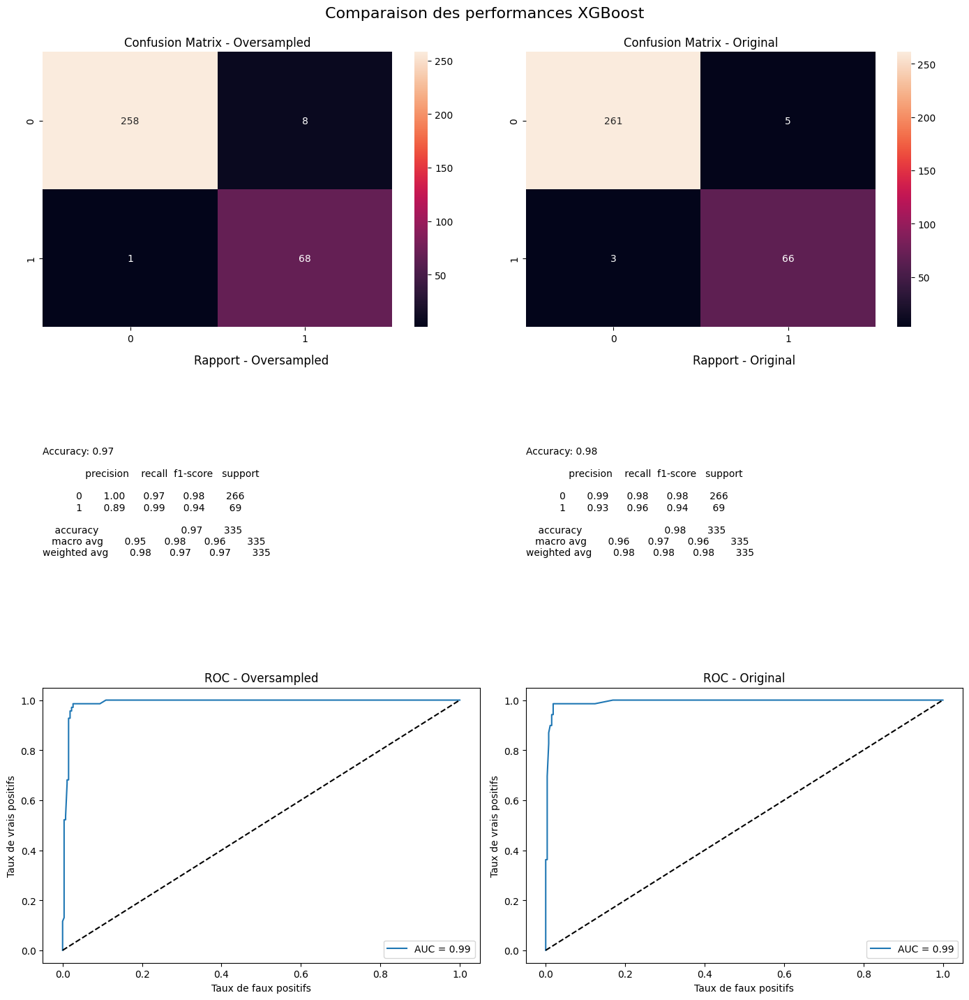

Méthode d'over-sampling :  border2


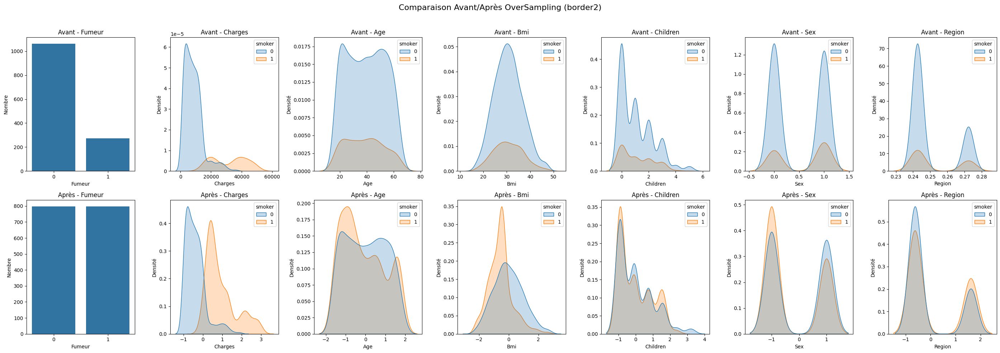

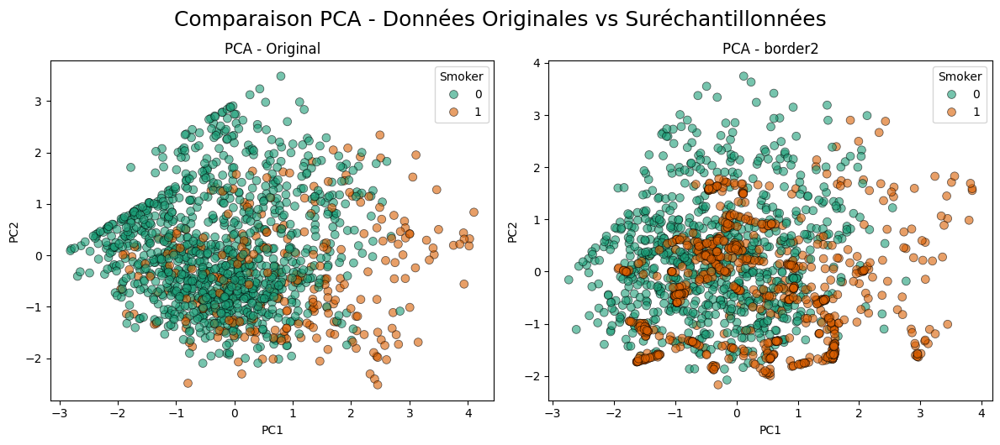


####### COMPARAISON PERFORMANCE - MÉTHODE : BORDER2 #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9698870765370138


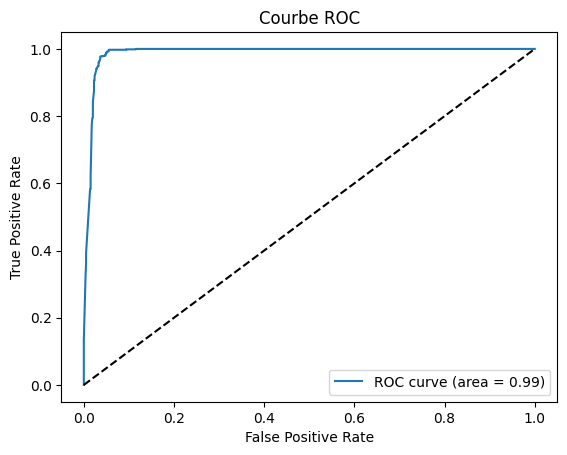

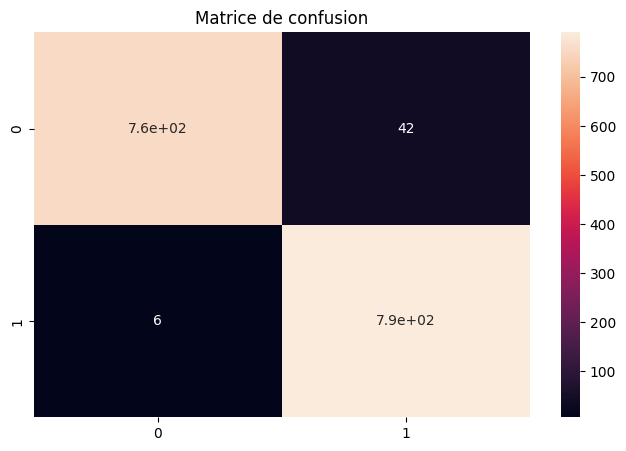

              precision    recall  f1-score   support

           0       0.99      0.95      0.97       797
           1       0.95      0.99      0.97       797

    accuracy                           0.97      1594
   macro avg       0.97      0.97      0.97      1594
weighted avg       0.97      0.97      0.97      1594


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


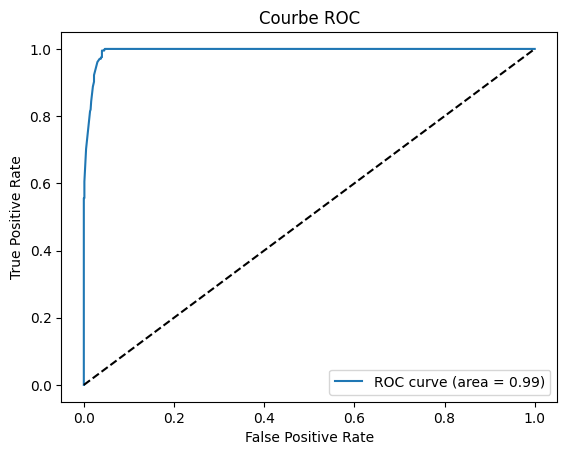

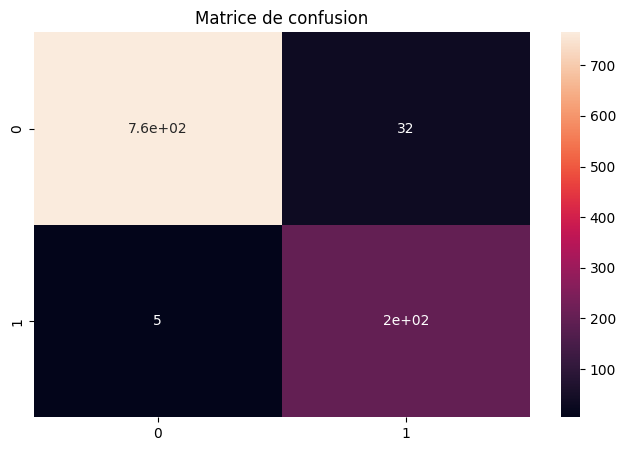

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



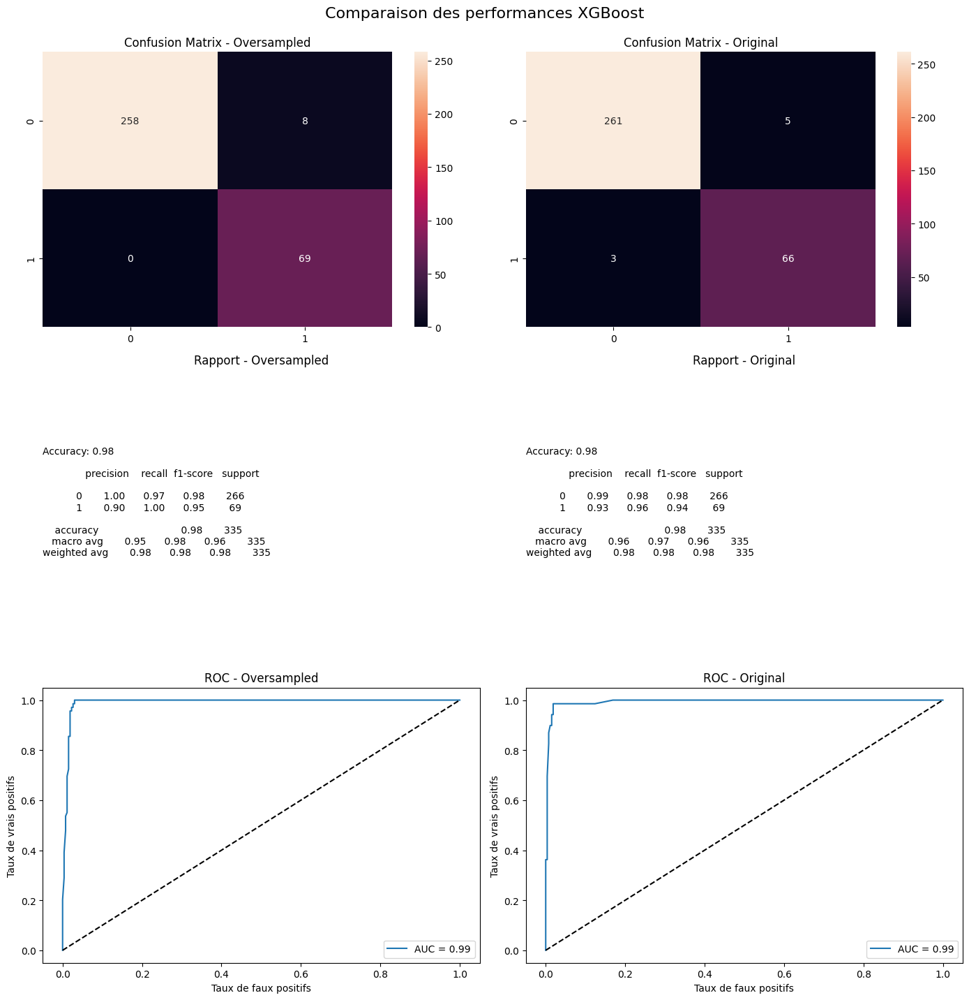

Méthode d'over-sampling :  svm


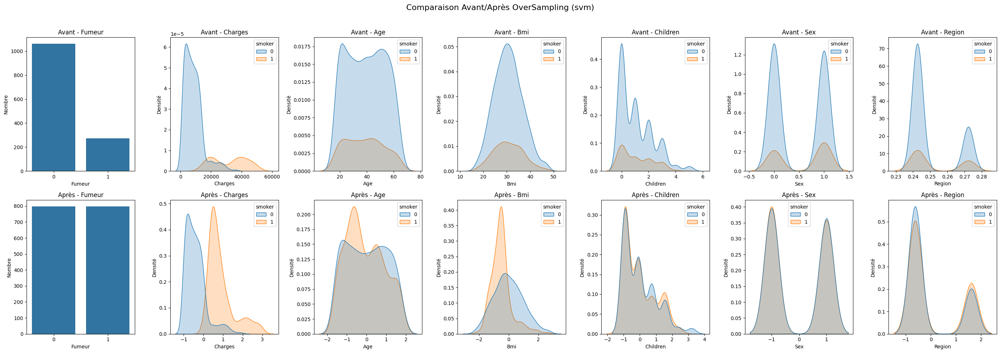

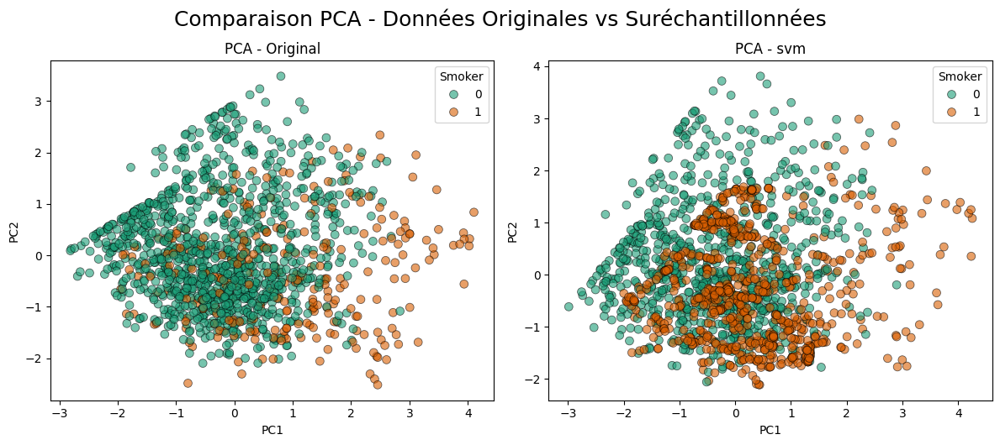


####### COMPARAISON PERFORMANCE - MÉTHODE : SVM #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.972396486825596


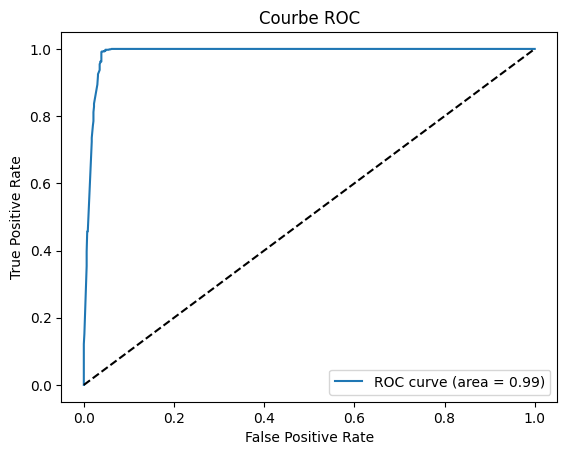

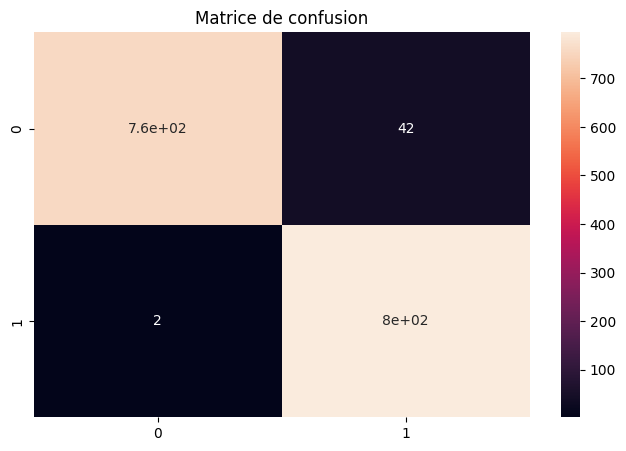

              precision    recall  f1-score   support

           0       1.00      0.95      0.97       797
           1       0.95      1.00      0.97       797

    accuracy                           0.97      1594
   macro avg       0.97      0.97      0.97      1594
weighted avg       0.97      0.97      0.97      1594


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


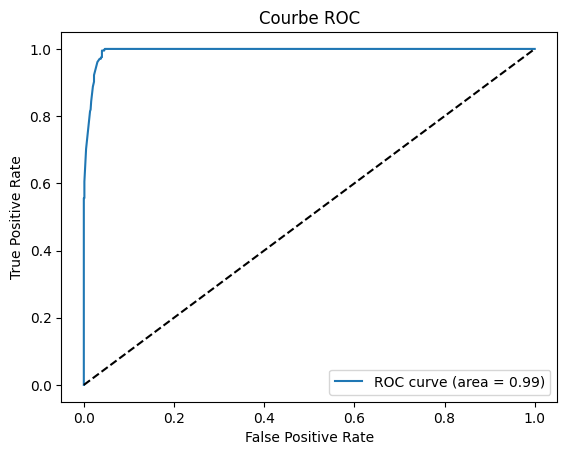

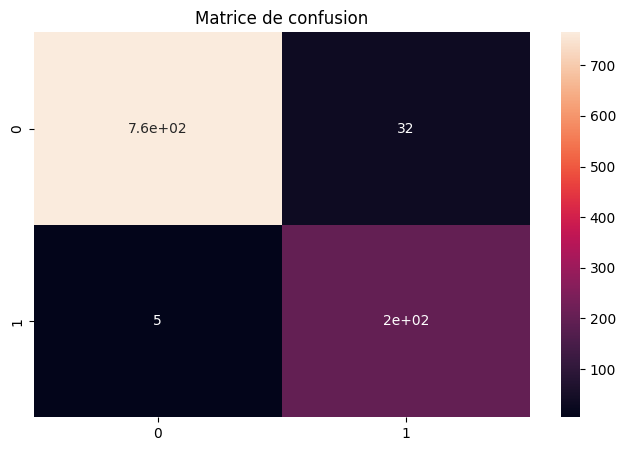

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



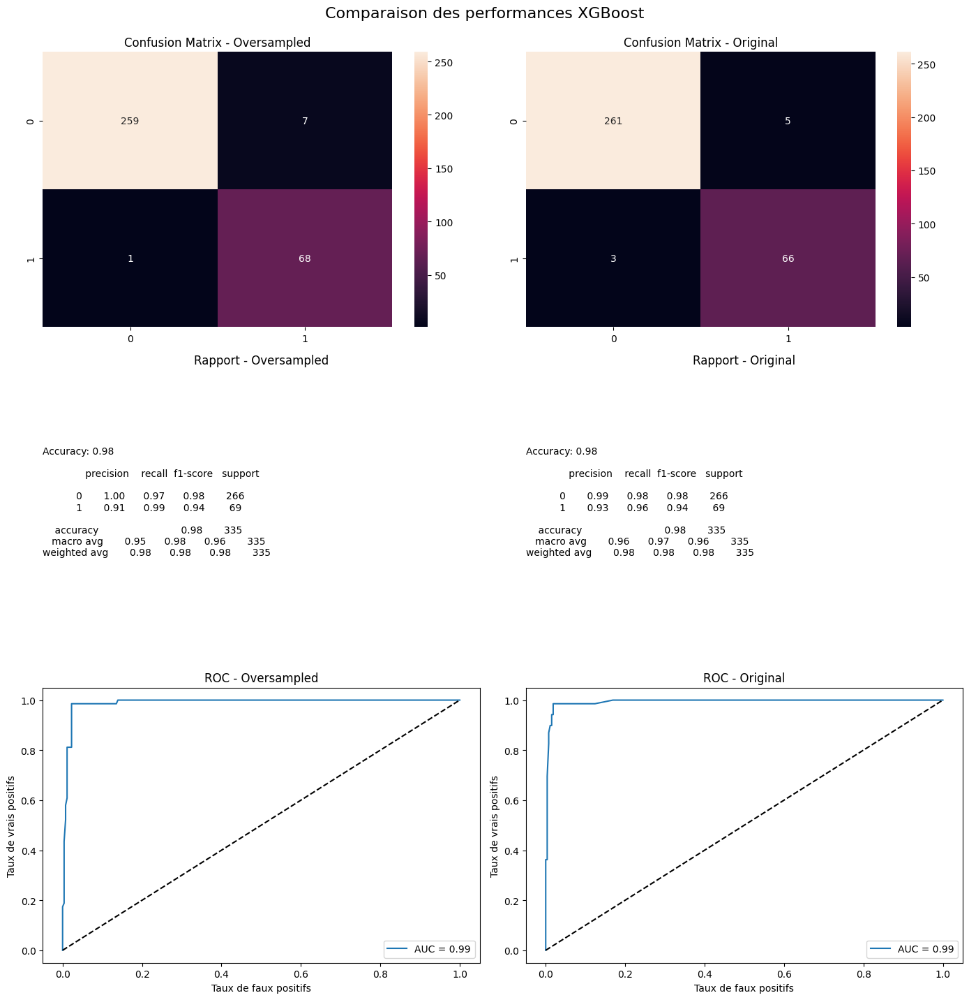

In [370]:
resampled_data_dict = {}

for oversampler in oversampler_dict.keys():
    print("Méthode d'over-sampling : ", oversampler)
    
    # Resampling des données
    X_resampled, y_resampled = oversampler_dict[oversampler].fit_resample(X_train, y_train)

    # Conversion en DataFrame si nécessaire
    if not isinstance(X_resampled, pd.DataFrame):
        X_resampled = pd.DataFrame(X_resampled, columns=X.columns)

    if isinstance(y_resampled, pd.DataFrame):
        y_resampled = y_resampled.iloc[:, 0]
    else:
        y_resampled = pd.Series(y_resampled, name='smoker')
    
    data_resampled = pd.concat([X_resampled, y_resampled], axis=1)

    # Sauvegarde pour éventuelle réutilisation
    resampled_data_dict[oversampler] = data_resampled
    
    # Visualisation comparative
    compare_smoker_distribution(data, data_resampled, title_suffix=f"({oversampler})")
    compare_pca_oversampling(data, {oversampler: data_resampled})

    # Comparaison de performance tout de suite après la visualisation
    print(f"\n####### COMPARAISON PERFORMANCE - MÉTHODE : {oversampler.upper()} #######")
    X_train_resampled = data_resampled.drop(columns='smoker')
    y_train_resampled = data_resampled['smoker']

    compare_xgboost_performance(
        X_train_orig=X_train, y_train_orig=y_train,
        X_train_res=X_train_resampled, y_train_res=y_train_resampled,
        X_test=X_test, y_test=y_test
    )


### Under sampling

In [371]:
from imblearn.under_sampling import (
    RandomUnderSampler,
    CondensedNearestNeighbour,
    TomekLinks
)

undersampler_dict = {
    'random': RandomUnderSampler(
        sampling_strategy='auto',
        random_state=0,
        replacement=False),

    'cnn': CondensedNearestNeighbour(
        sampling_strategy='auto',
        random_state=0,
        n_neighbors=1,
        n_jobs=4),

    'tl' : TomekLinks(
        sampling_strategy='auto',
        n_jobs=4)
}

#### Random forest

Méthode d'under-sampling :  random


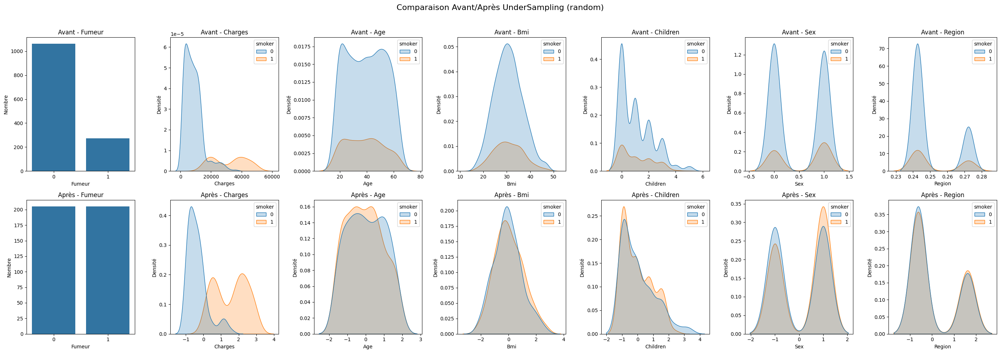

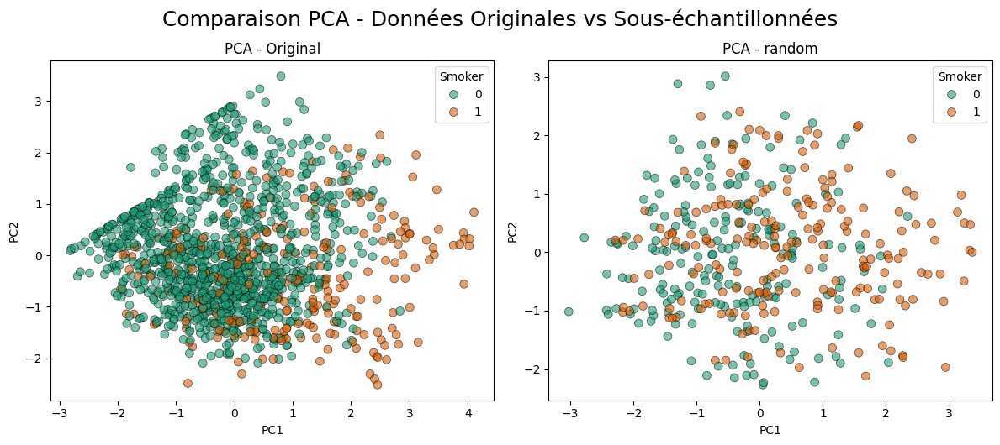


####### COMPARAISON PERFORMANCE - MÉTHODE : RANDOM #######
=== Entraînement sur données sous-échantillonnées ===
Accuracy :  0.9365853658536586


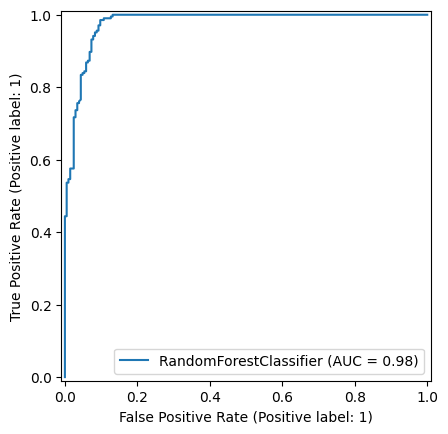

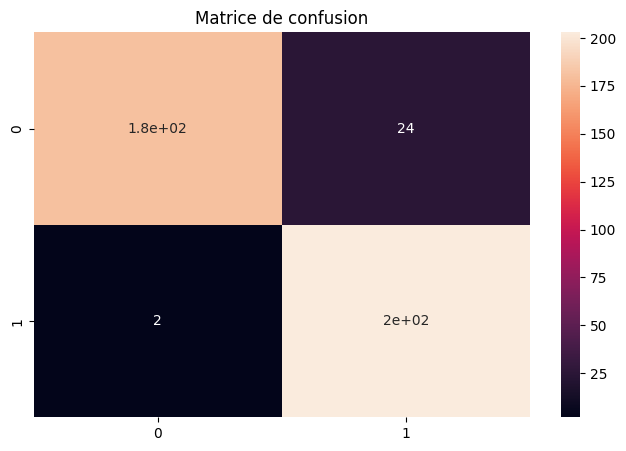

              precision    recall  f1-score   support

           0       0.99      0.88      0.93       205
           1       0.89      0.99      0.94       205

    accuracy                           0.94       410
   macro avg       0.94      0.94      0.94       410
weighted avg       0.94      0.94      0.94       410


=== Entraînement sur données originales ===
Accuracy :  0.8832335329341318


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


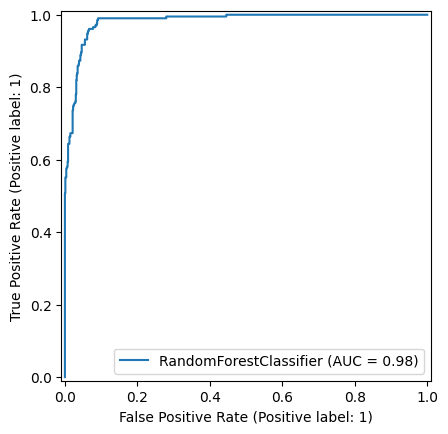

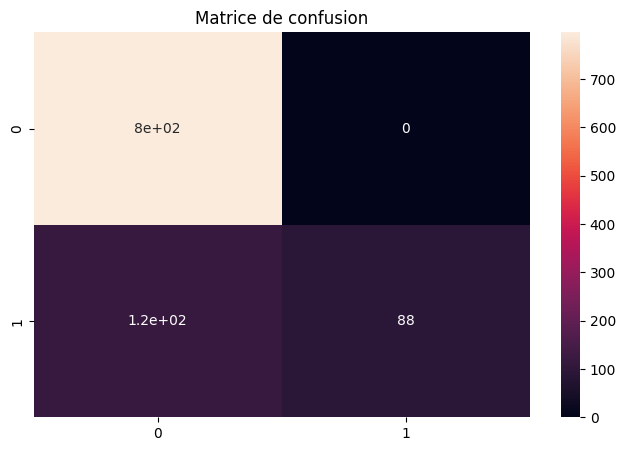

              precision    recall  f1-score   support

           0       0.87      1.00      0.93       797
           1       1.00      0.43      0.60       205

    accuracy                           0.88      1002
   macro avg       0.94      0.71      0.77      1002
weighted avg       0.90      0.88      0.86      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


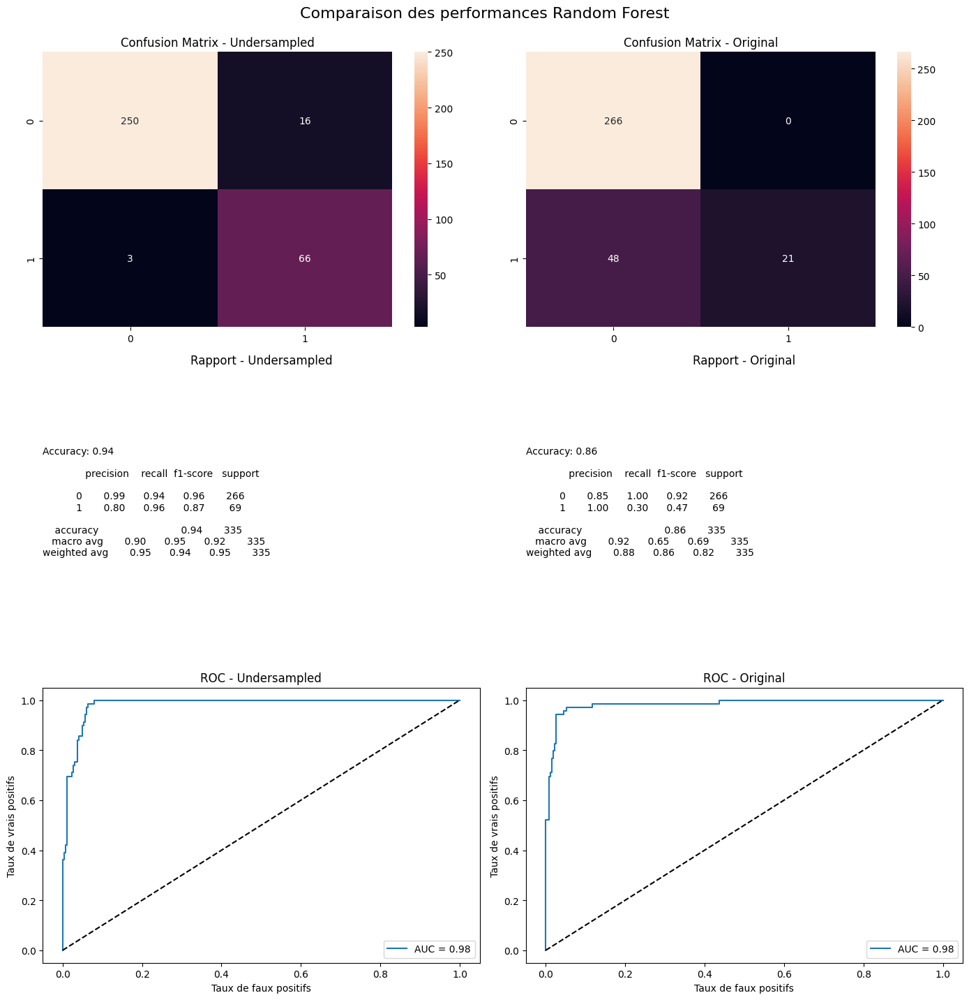

Méthode d'under-sampling :  cnn


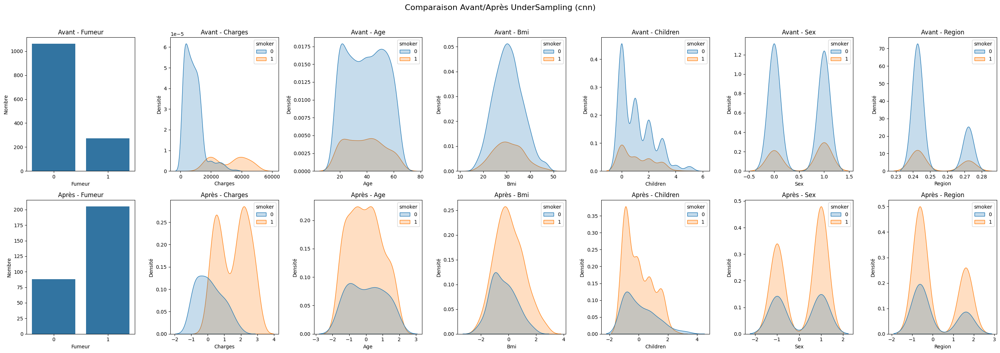

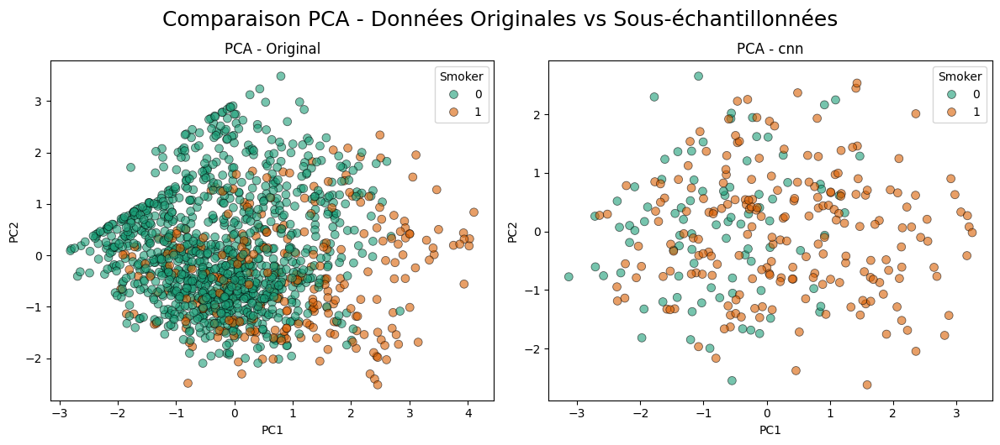


####### COMPARAISON PERFORMANCE - MÉTHODE : CNN #######
=== Entraînement sur données sous-échantillonnées ===
Accuracy :  0.863481228668942


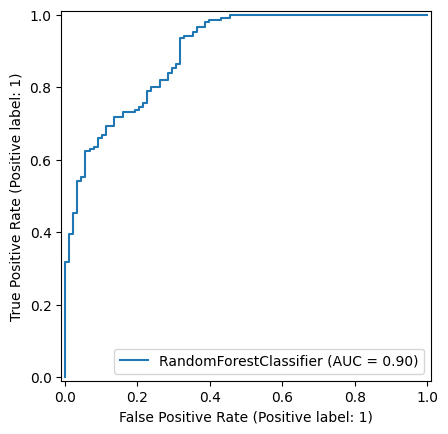

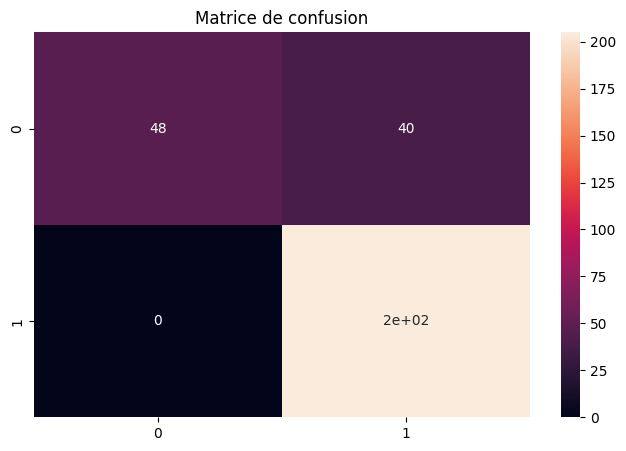

              precision    recall  f1-score   support

           0       1.00      0.55      0.71        88
           1       0.84      1.00      0.91       205

    accuracy                           0.86       293
   macro avg       0.92      0.77      0.81       293
weighted avg       0.89      0.86      0.85       293


=== Entraînement sur données originales ===
Accuracy :  0.8762475049900199


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


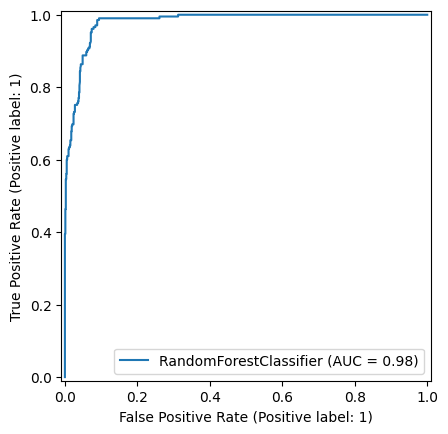

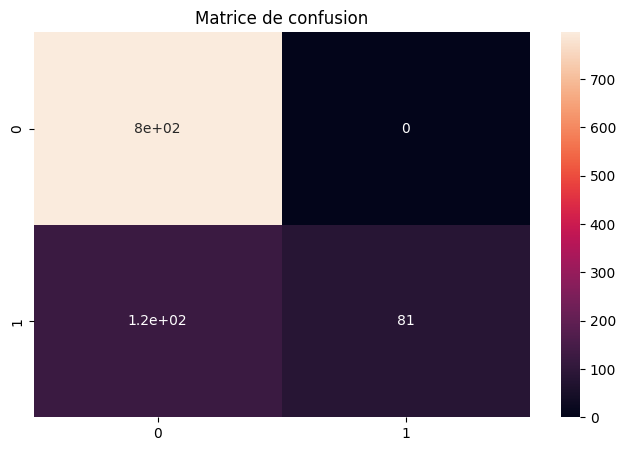

              precision    recall  f1-score   support

           0       0.87      1.00      0.93       797
           1       1.00      0.40      0.57       205

    accuracy                           0.88      1002
   macro avg       0.93      0.70      0.75      1002
weighted avg       0.89      0.88      0.85      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


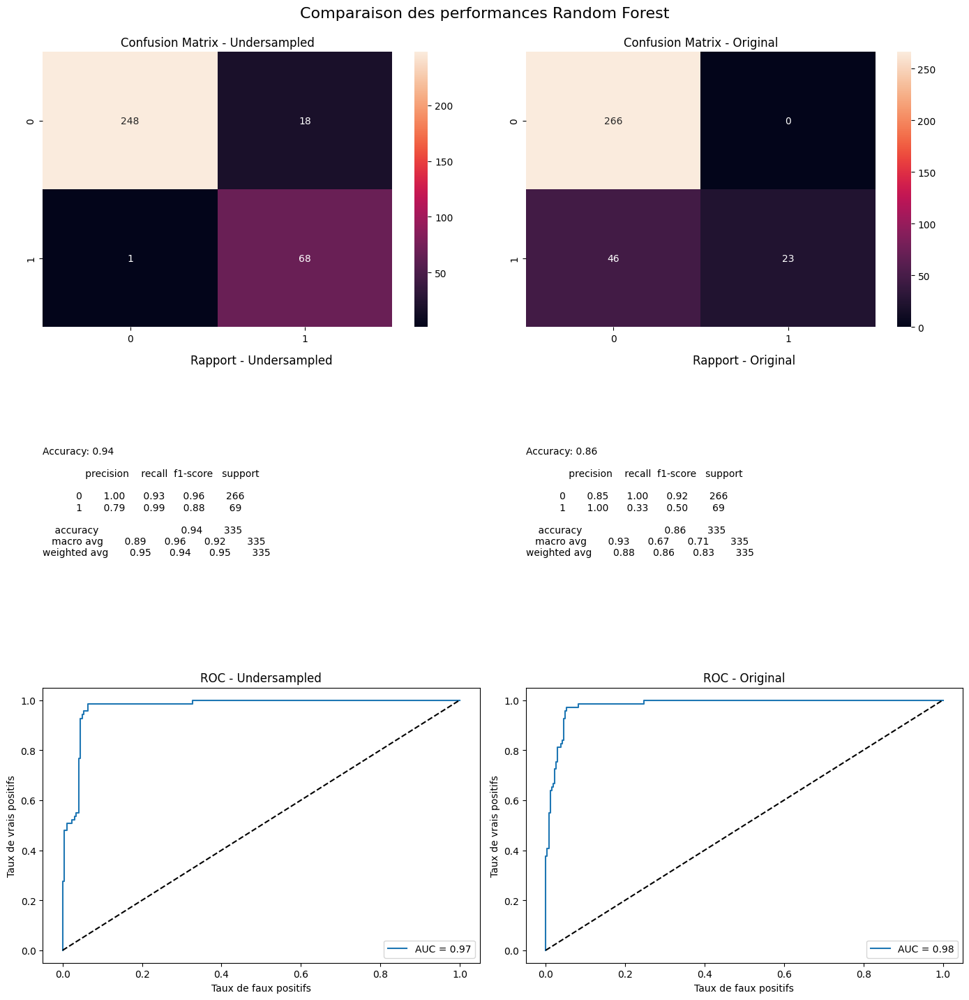

Méthode d'under-sampling :  tl


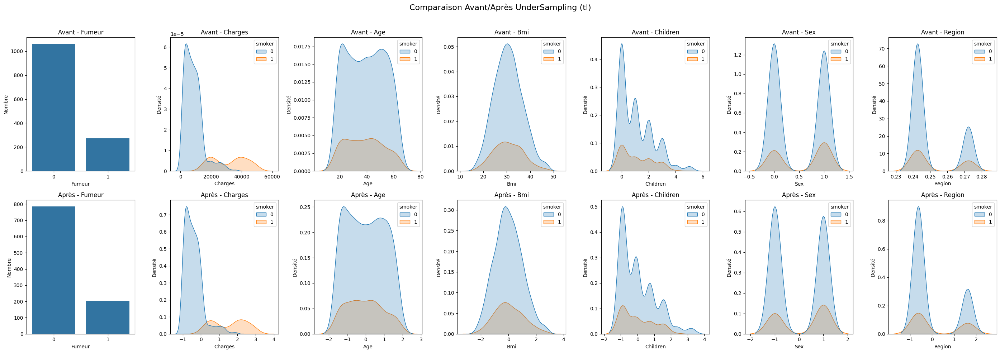

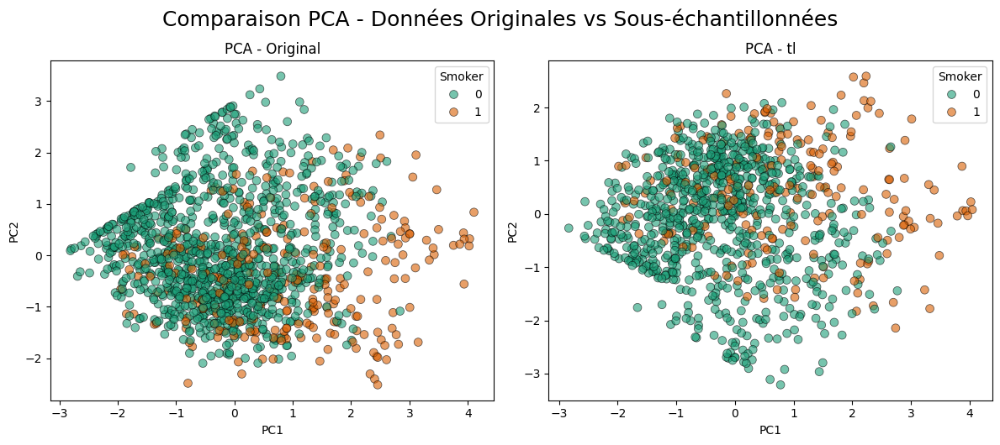


####### COMPARAISON PERFORMANCE - MÉTHODE : TL #######
=== Entraînement sur données sous-échantillonnées ===
Accuracy :  0.9333333333333333


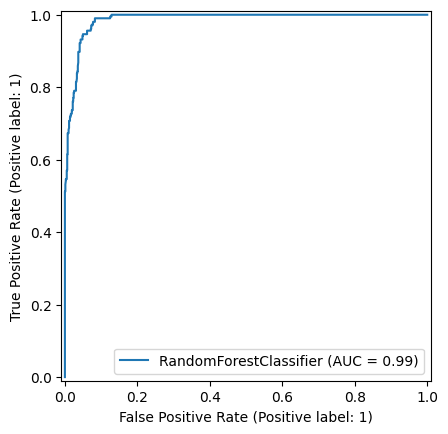

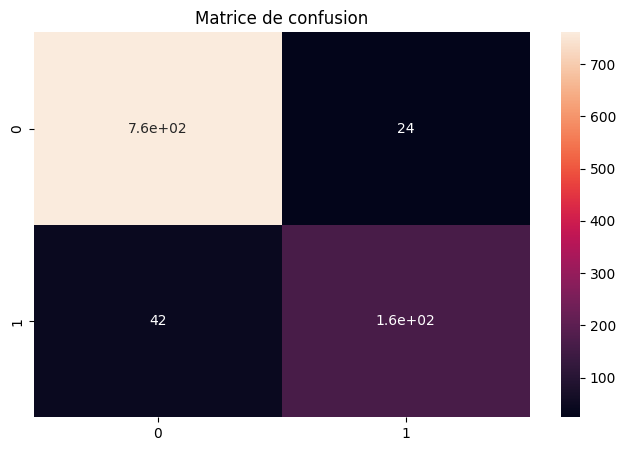

              precision    recall  f1-score   support

           0       0.95      0.97      0.96       785
           1       0.87      0.80      0.83       205

    accuracy                           0.93       990
   macro avg       0.91      0.88      0.90       990
weighted avg       0.93      0.93      0.93       990


=== Entraînement sur données originales ===
Accuracy :  0.8772455089820359


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


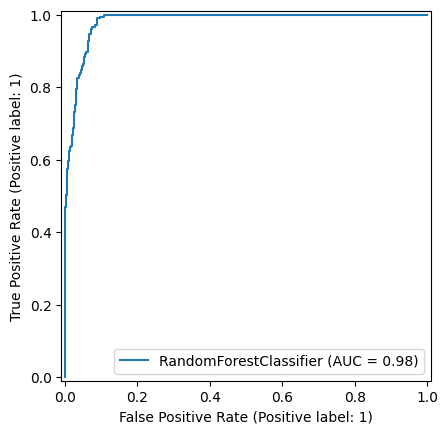

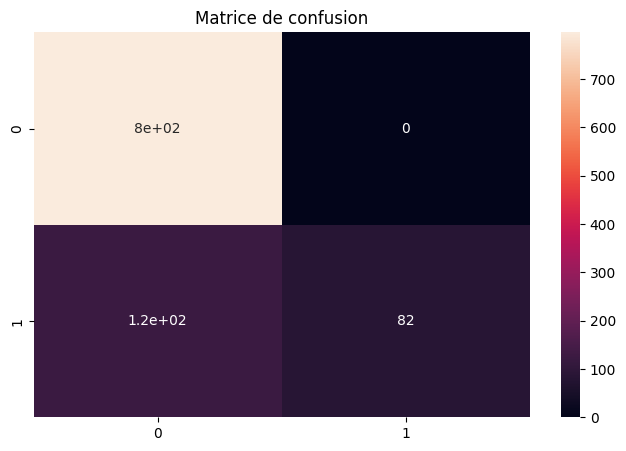

              precision    recall  f1-score   support

           0       0.87      1.00      0.93       797
           1       1.00      0.40      0.57       205

    accuracy                           0.88      1002
   macro avg       0.93      0.70      0.75      1002
weighted avg       0.89      0.88      0.86      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


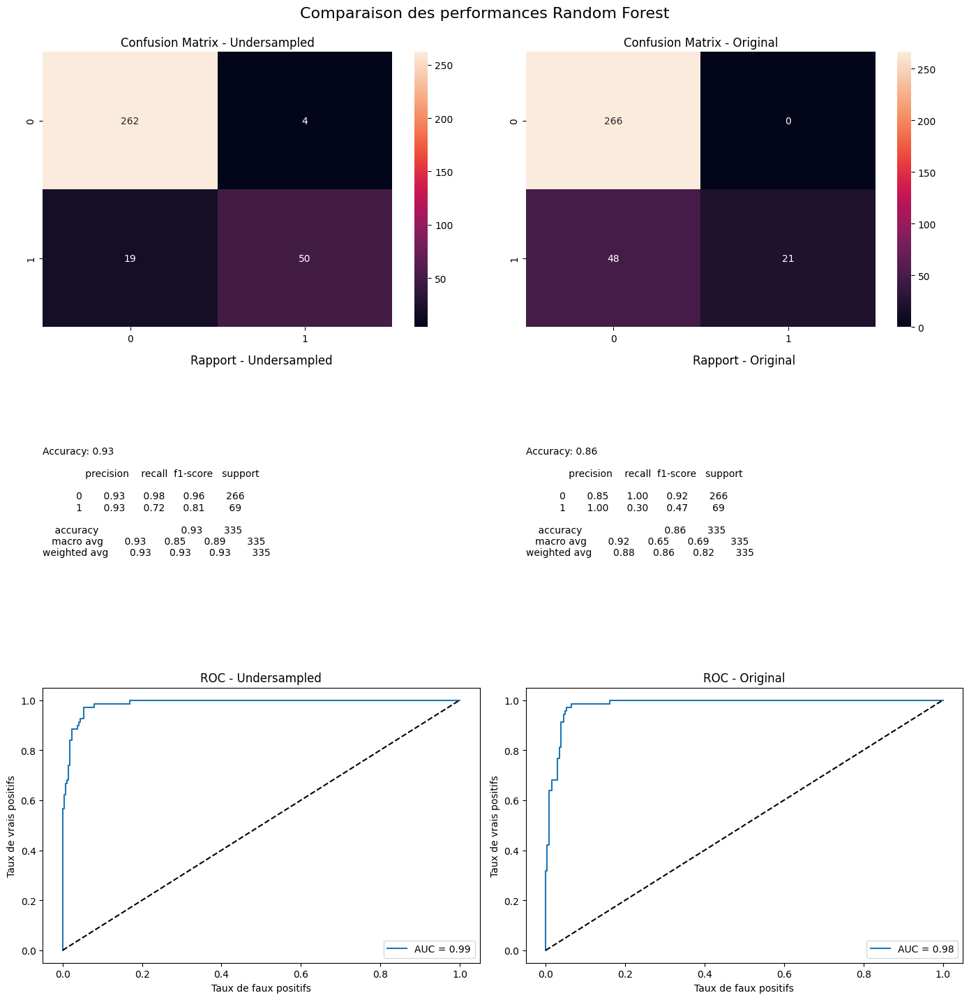

In [372]:
resampled_data_dict = {}

for undersampler in undersampler_dict.keys():
    print("Méthode d'under-sampling : ", undersampler)
    
    # Resampling des données
    X_resampled, y_resampled = undersampler_dict[undersampler].fit_resample(X_train, y_train)

    # Conversion en DataFrame si nécessaire
    if not isinstance(X_resampled, pd.DataFrame):
        X_resampled = pd.DataFrame(X_resampled, columns=X.columns)

    if isinstance(y_resampled, pd.DataFrame):
        y_resampled = y_resampled.iloc[:, 0]
    else:
        y_resampled = pd.Series(y_resampled, name='smoker')
    
    data_resampled = pd.concat([X_resampled, y_resampled], axis=1)

    # Sauvegarde pour éventuelle réutilisation
    resampled_data_dict[undersampler] = data_resampled
    
    # Visualisation comparative
    compare_smoker_distribution(data, data_resampled, title_suffix=f"({undersampler})", p=1)
    compare_pca_oversampling(data, {undersampler: data_resampled}, p=1)

    # Comparaison de performance tout de suite après la visualisation
    print(f"\n####### COMPARAISON PERFORMANCE - MÉTHODE : {undersampler.upper()} #######")
    X_train_resampled = data_resampled.drop(columns='smoker')
    y_train_resampled = data_resampled['smoker']

    compare_random_forest_performance(
        X_train_orig=X_train, y_train_orig=y_train,
        X_train_res=X_train_resampled, y_train_res=y_train_resampled,
        X_test=X_test, y_test=y_test, p=1
    )


#### Naives bayes

Méthode d'under-sampling :  random


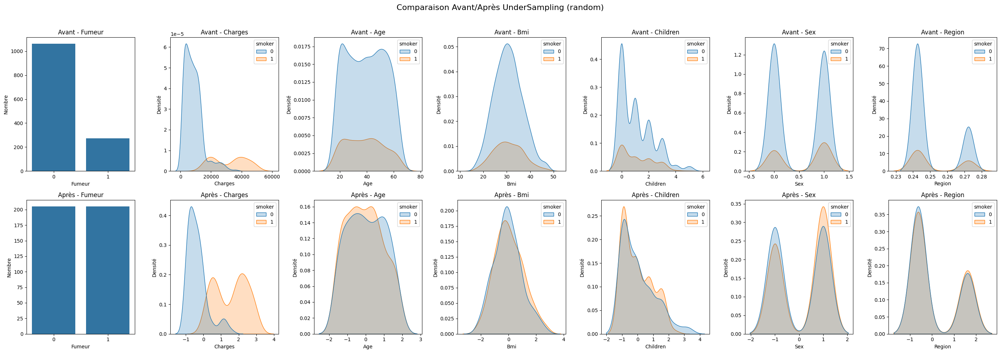

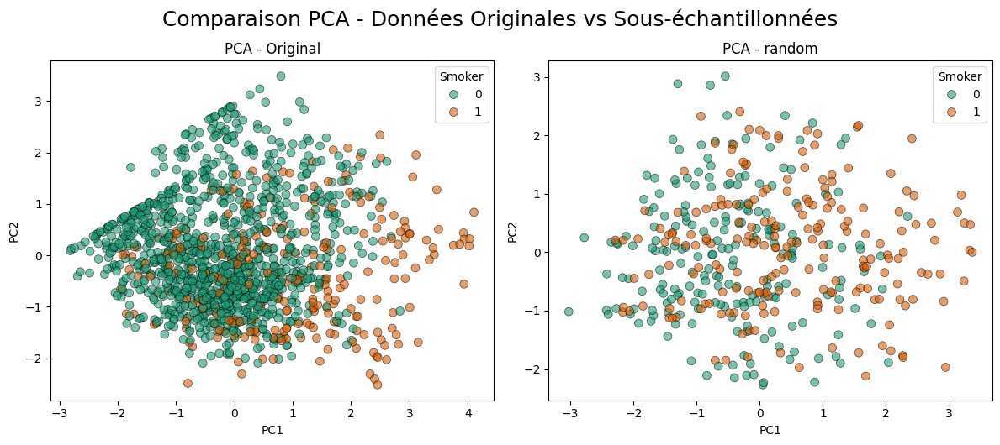


####### COMPARAISON PERFORMANCE - MÉTHODE : RANDOM #######
=== Entraînement sur données sous-échantillonnées ===
Accuracy :  0.8658536585365854


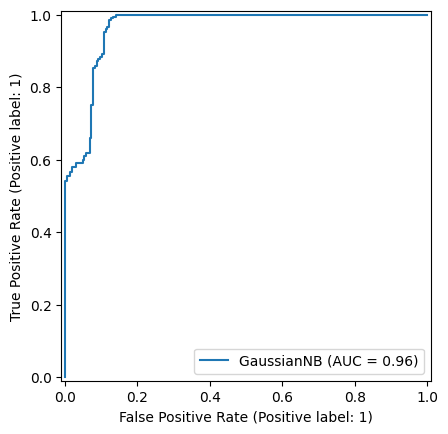

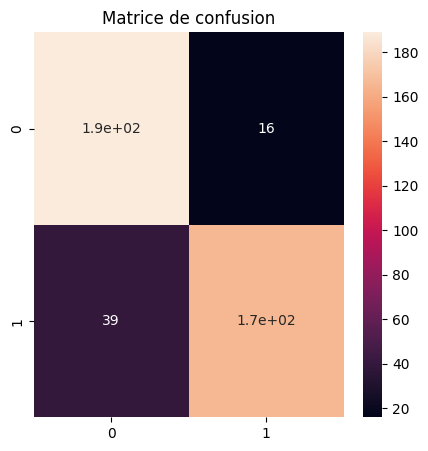

              precision    recall  f1-score   support

           0       0.83      0.92      0.87       205
           1       0.91      0.81      0.86       205

    accuracy                           0.87       410
   macro avg       0.87      0.87      0.87       410
weighted avg       0.87      0.87      0.87       410


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


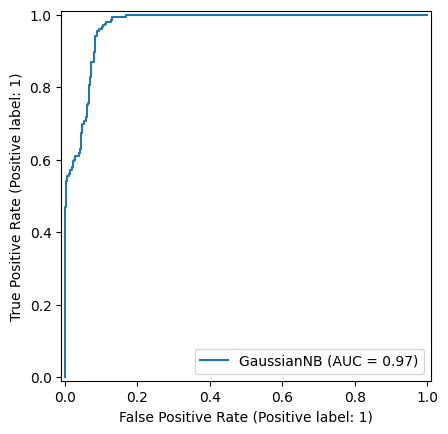

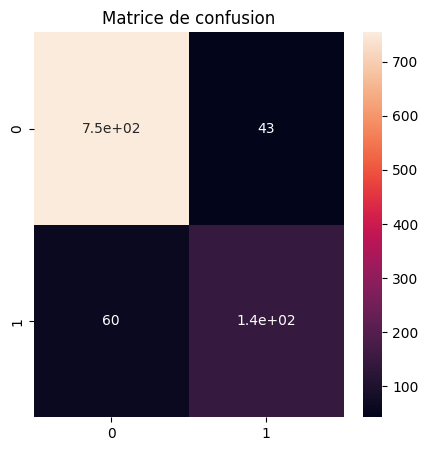

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


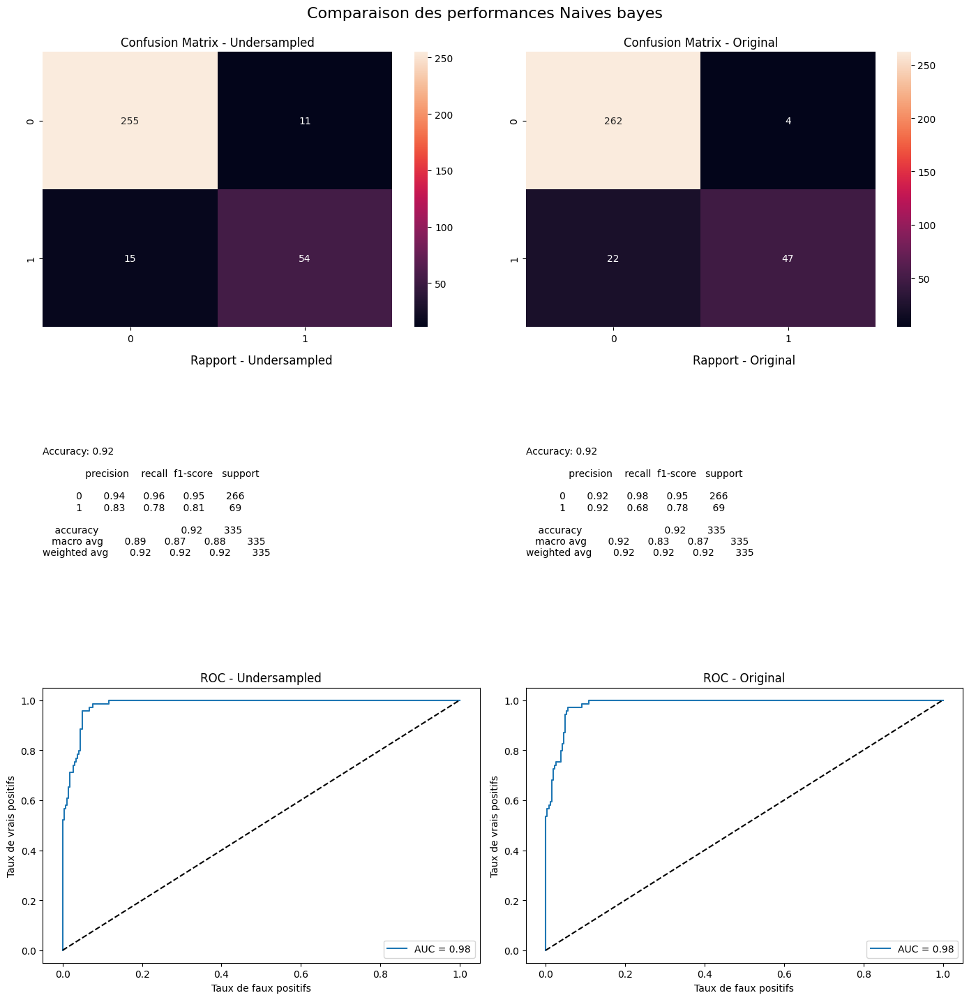

Méthode d'under-sampling :  cnn


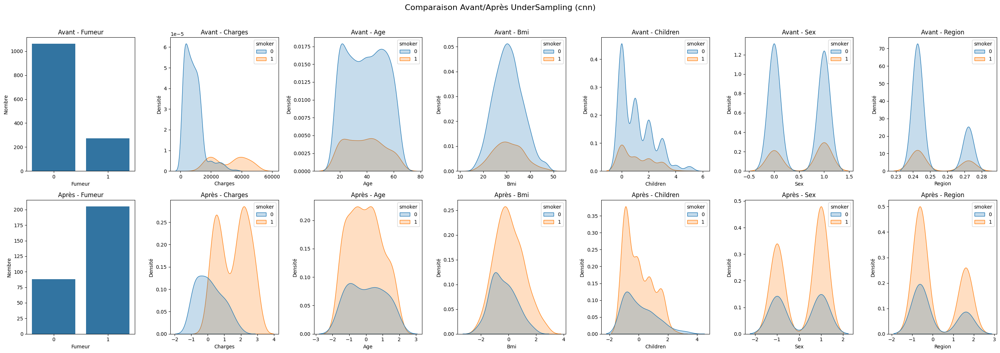

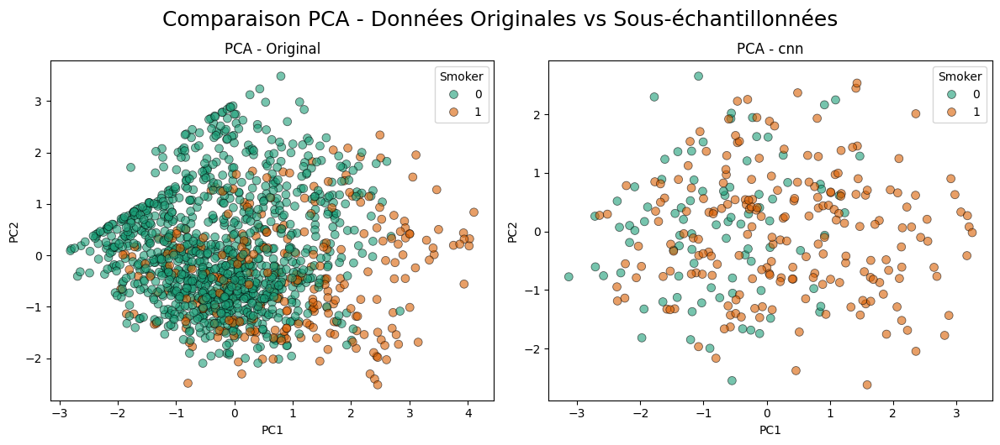


####### COMPARAISON PERFORMANCE - MÉTHODE : CNN #######
=== Entraînement sur données sous-échantillonnées ===
Accuracy :  0.7372013651877133


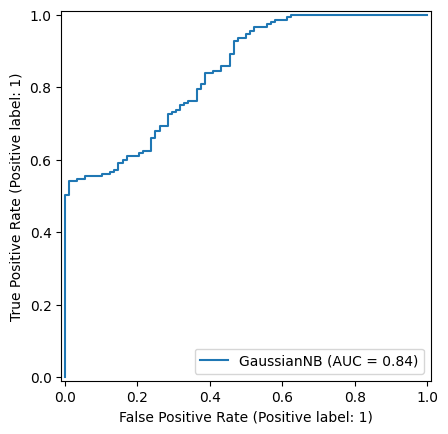

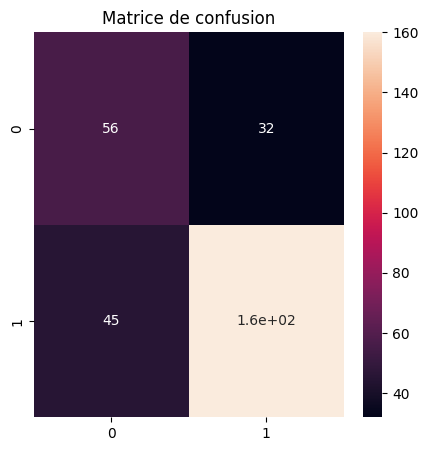

              precision    recall  f1-score   support

           0       0.55      0.64      0.59        88
           1       0.83      0.78      0.81       205

    accuracy                           0.74       293
   macro avg       0.69      0.71      0.70       293
weighted avg       0.75      0.74      0.74       293


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


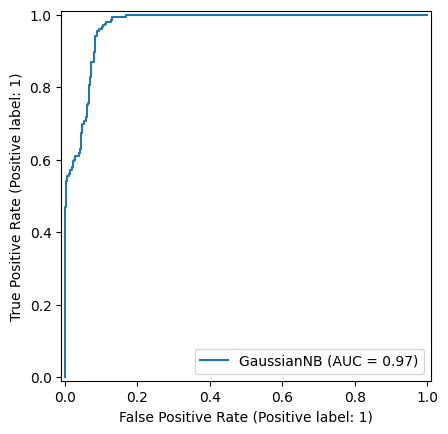

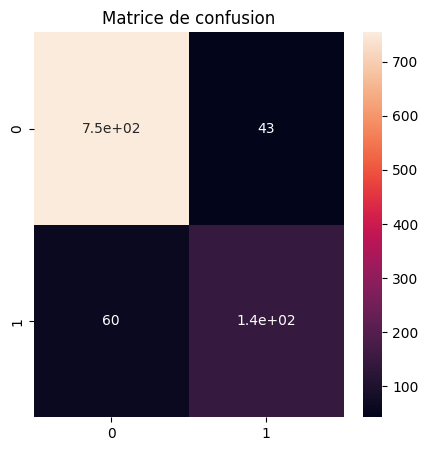

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


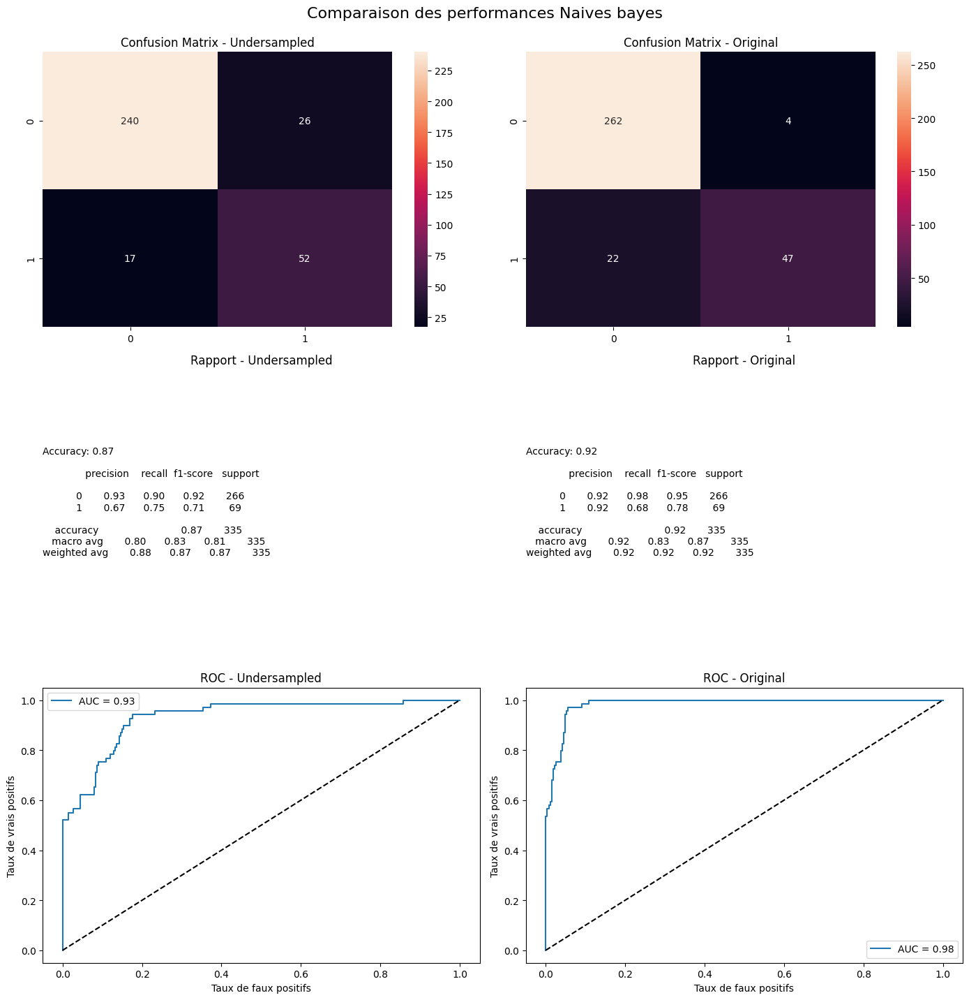

Méthode d'under-sampling :  tl


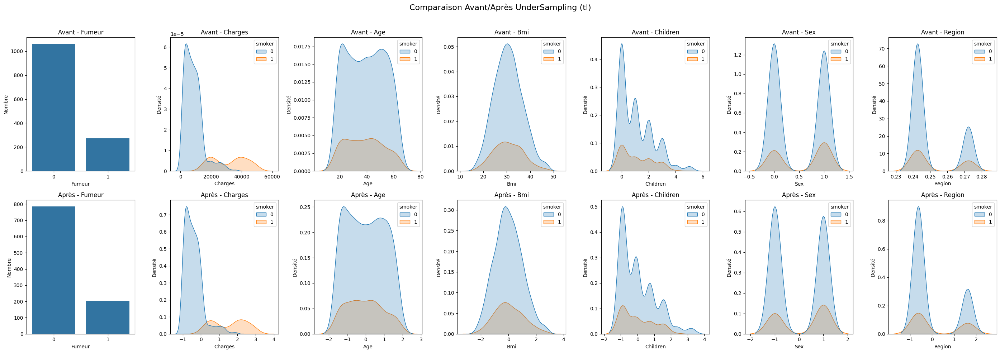

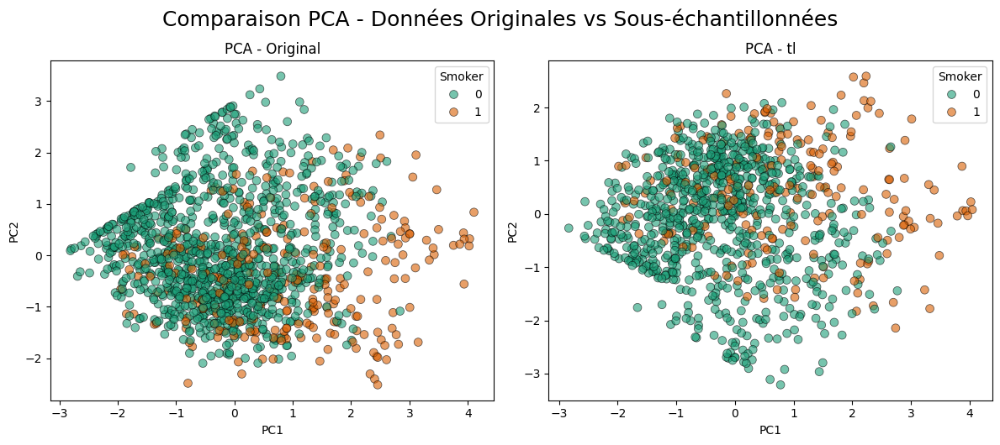


####### COMPARAISON PERFORMANCE - MÉTHODE : TL #######
=== Entraînement sur données sous-échantillonnées ===
Accuracy :  0.901010101010101


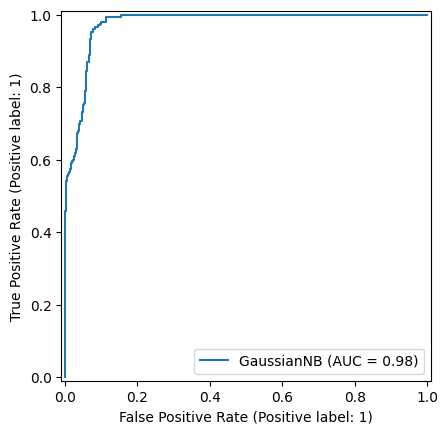

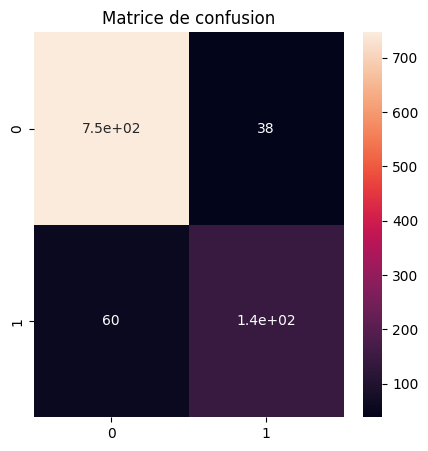

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       785
           1       0.79      0.71      0.75       205

    accuracy                           0.90       990
   macro avg       0.86      0.83      0.84       990
weighted avg       0.90      0.90      0.90       990


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


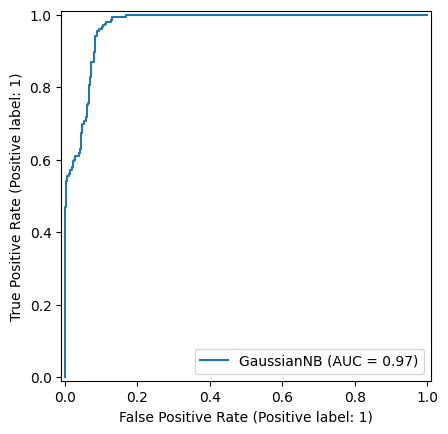

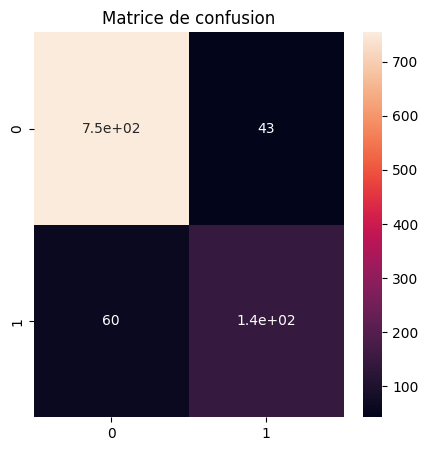

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


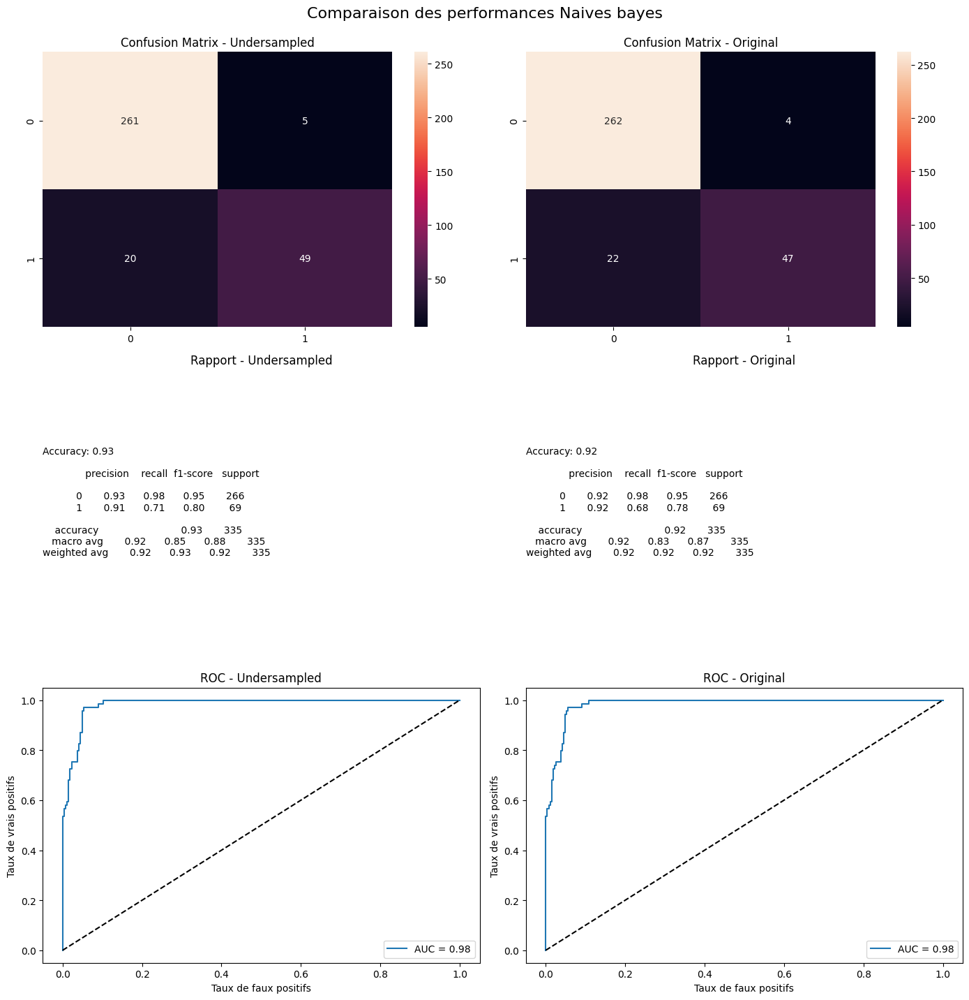

In [373]:
resampled_data_dict = {}

for undersampler in undersampler_dict.keys():
    print("Méthode d'under-sampling : ", undersampler)
    
    # Resampling des données
    X_resampled, y_resampled = undersampler_dict[undersampler].fit_resample(X_train, y_train)

    # Conversion en DataFrame si nécessaire
    if not isinstance(X_resampled, pd.DataFrame):
        X_resampled = pd.DataFrame(X_resampled, columns=X.columns)

    if isinstance(y_resampled, pd.DataFrame):
        y_resampled = y_resampled.iloc[:, 0]
    else:
        y_resampled = pd.Series(y_resampled, name='smoker')
    
    data_resampled = pd.concat([X_resampled, y_resampled], axis=1)

    # Sauvegarde pour éventuelle réutilisation
    resampled_data_dict[undersampler] = data_resampled
    
    # Visualisation comparative
    compare_smoker_distribution(data, data_resampled, title_suffix=f"({undersampler})", p=1)
    compare_pca_oversampling(data, {undersampler: data_resampled}, p=1)

    # Comparaison de performance tout de suite après la visualisation
    print(f"\n####### COMPARAISON PERFORMANCE - MÉTHODE : {undersampler.upper()} #######")
    X_train_resampled = data_resampled.drop(columns='smoker')
    y_train_resampled = data_resampled['smoker']

    compare_Naives_bayes_performance(
        X_train_orig=X_train, y_train_orig=y_train,
        X_train_res=X_train_resampled, y_train_res=y_train_resampled,
        X_test=X_test, y_test=y_test, p=1
    )


### Xgboost

Méthode d'under-sampling :  random


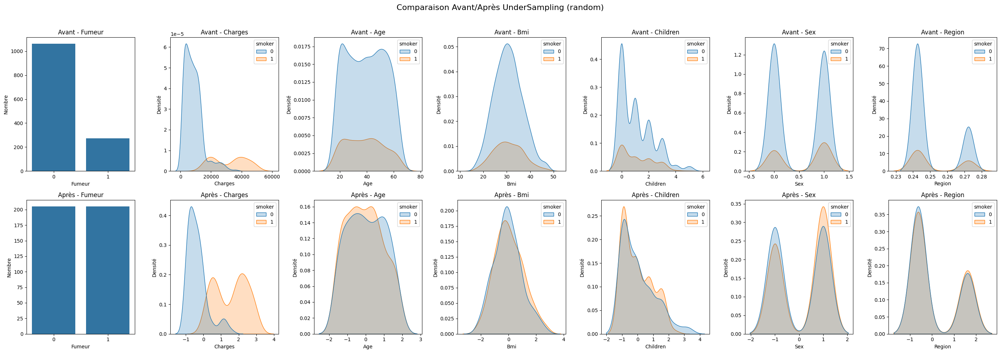

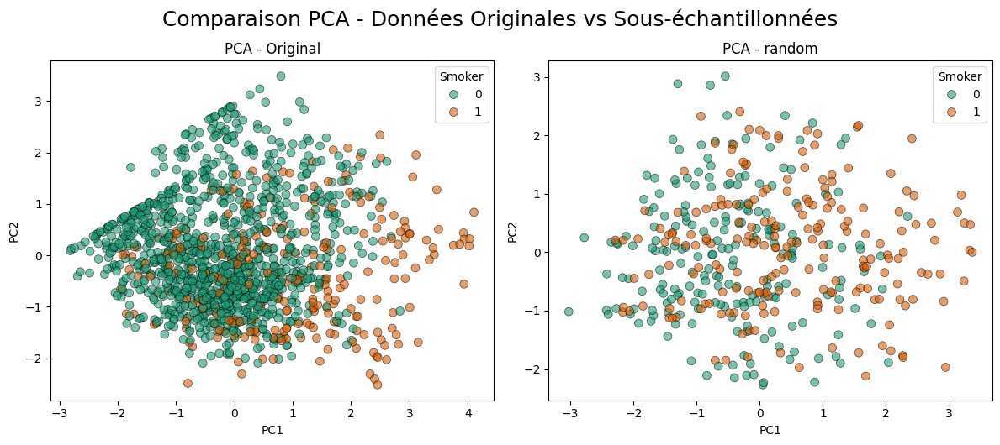


####### COMPARAISON PERFORMANCE - MÉTHODE : RANDOM #######
=== Entraînement sur données sous-échantillonnées ===
Accuracy :  0.9804878048780488


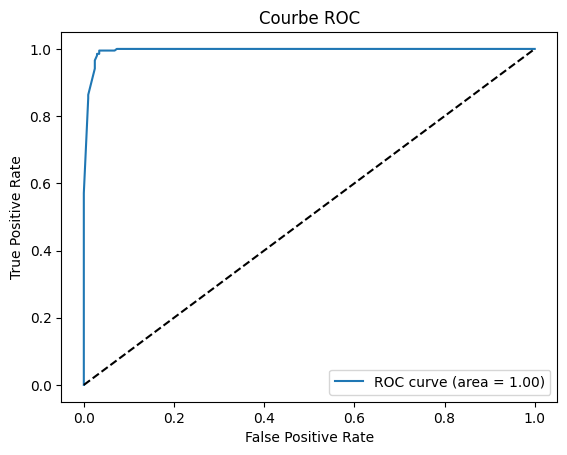

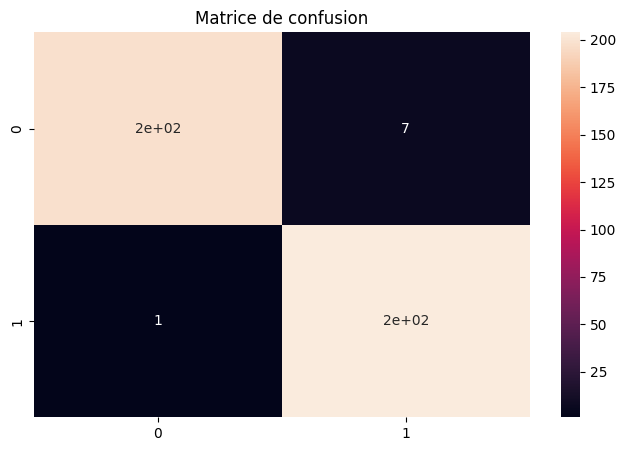

              precision    recall  f1-score   support

           0       0.99      0.97      0.98       205
           1       0.97      1.00      0.98       205

    accuracy                           0.98       410
   macro avg       0.98      0.98      0.98       410
weighted avg       0.98      0.98      0.98       410


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


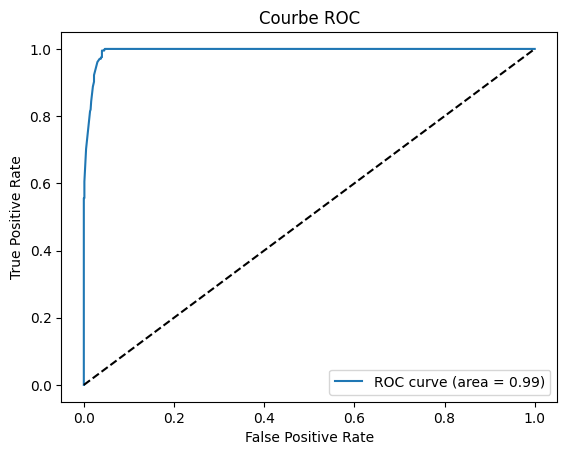

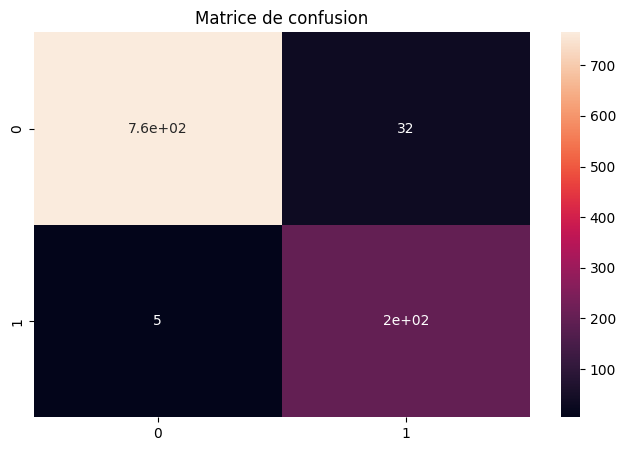

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



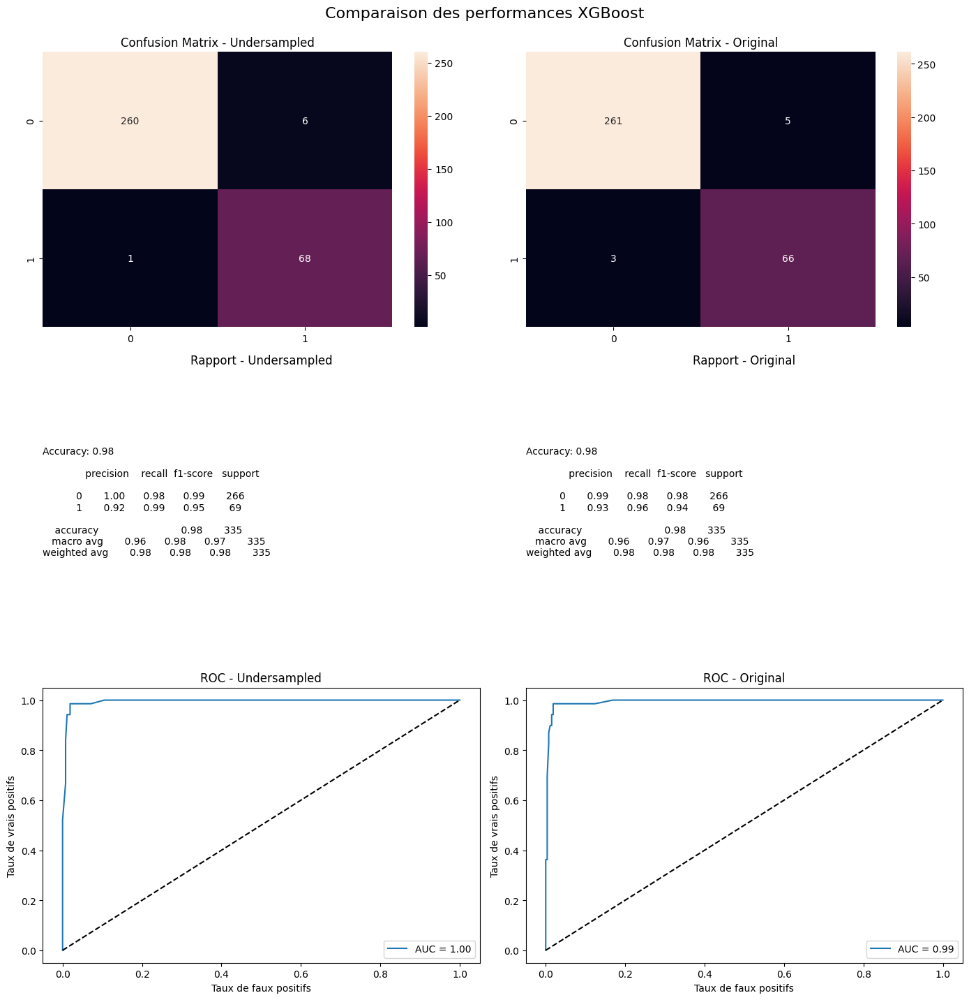

Méthode d'under-sampling :  cnn


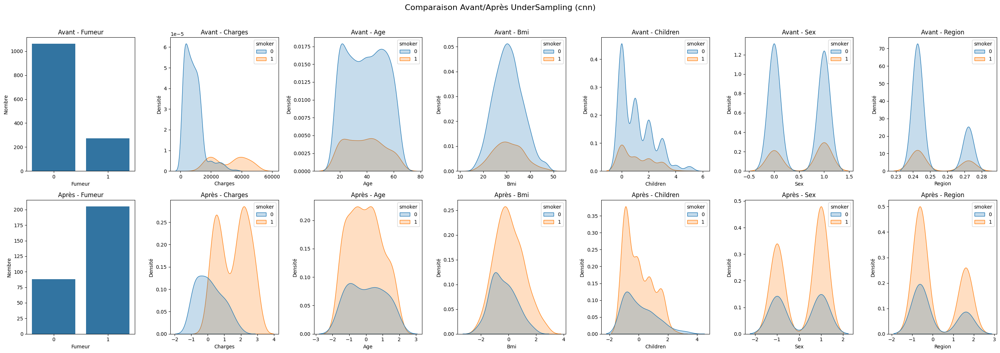

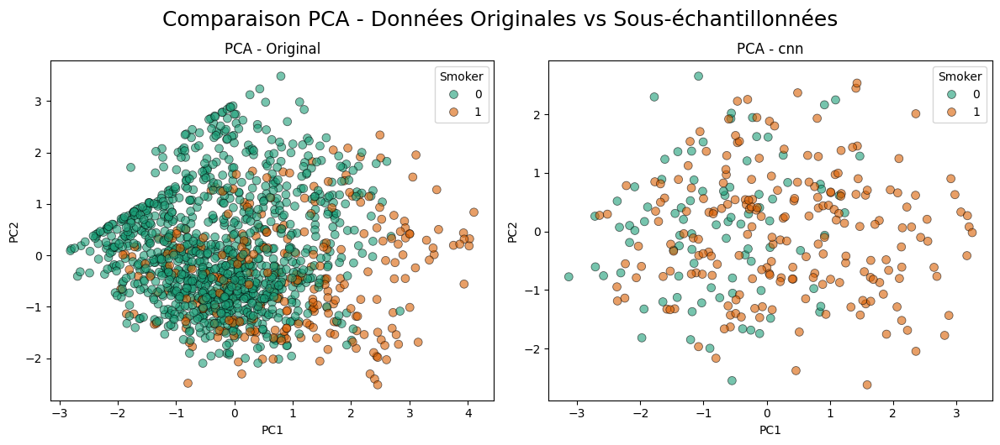


####### COMPARAISON PERFORMANCE - MÉTHODE : CNN #######
=== Entraînement sur données sous-échantillonnées ===
Accuracy :  0.9180887372013652


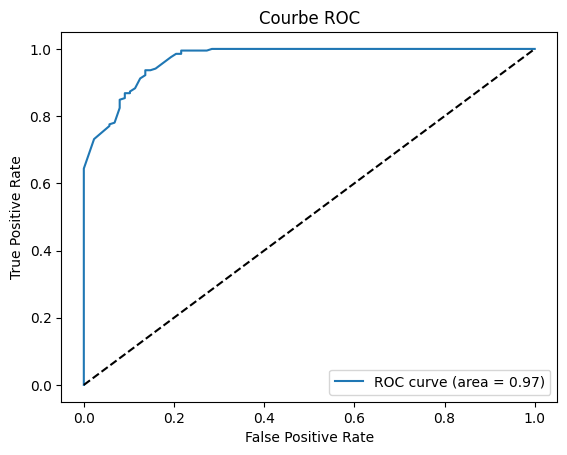

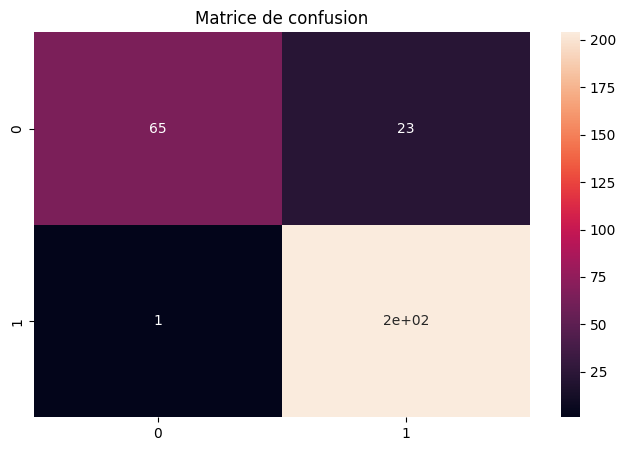

              precision    recall  f1-score   support

           0       0.98      0.74      0.84        88
           1       0.90      1.00      0.94       205

    accuracy                           0.92       293
   macro avg       0.94      0.87      0.89       293
weighted avg       0.92      0.92      0.91       293


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


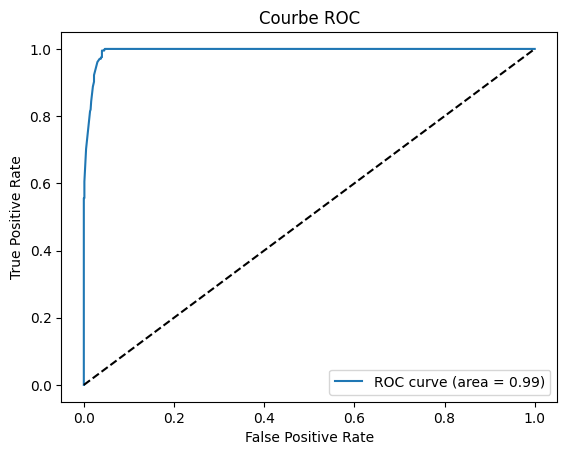

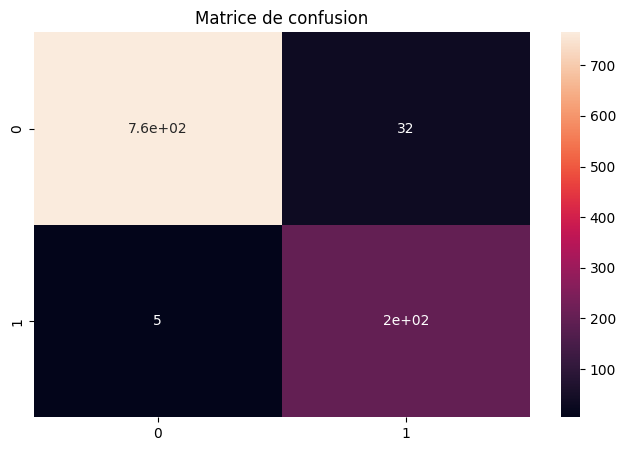

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



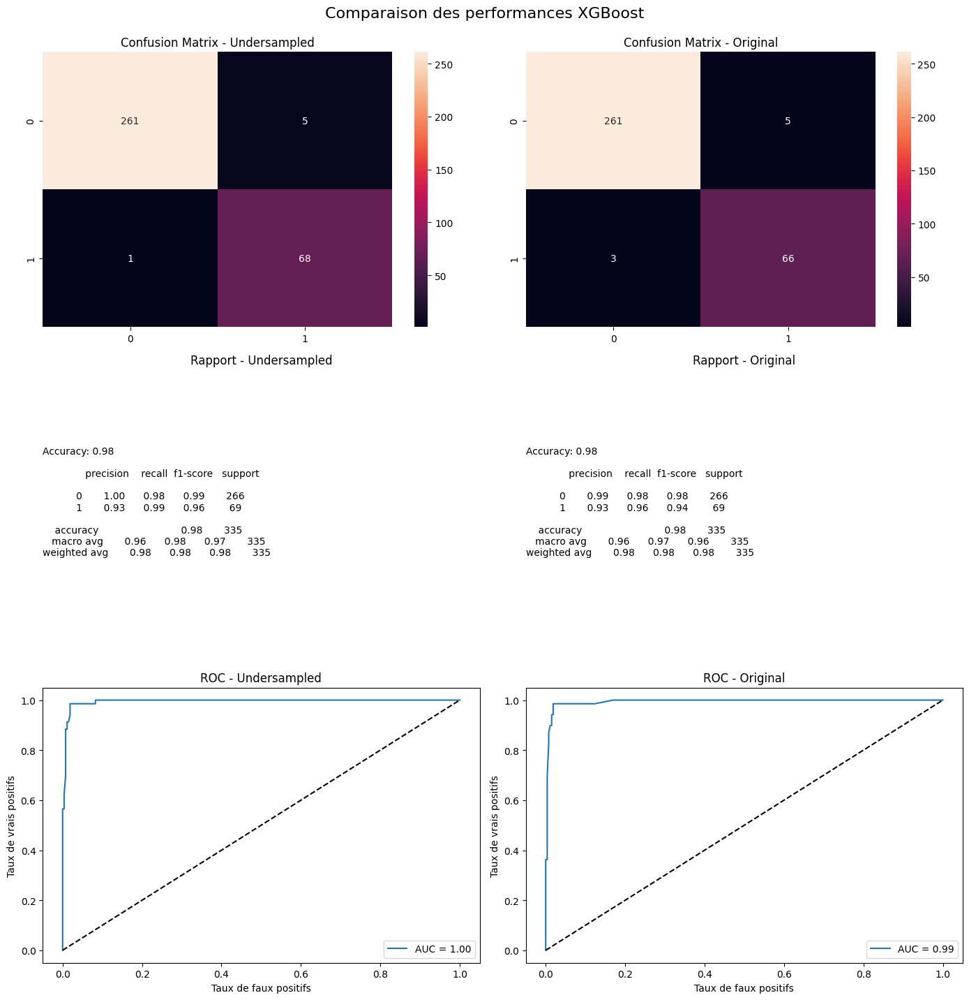

Méthode d'under-sampling :  tl


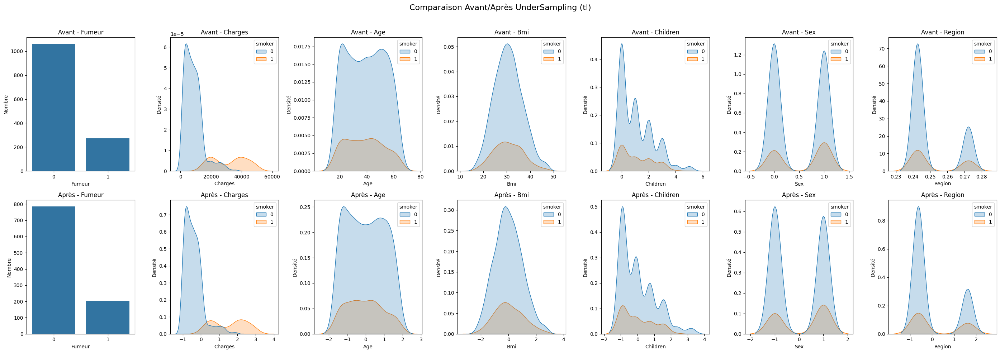

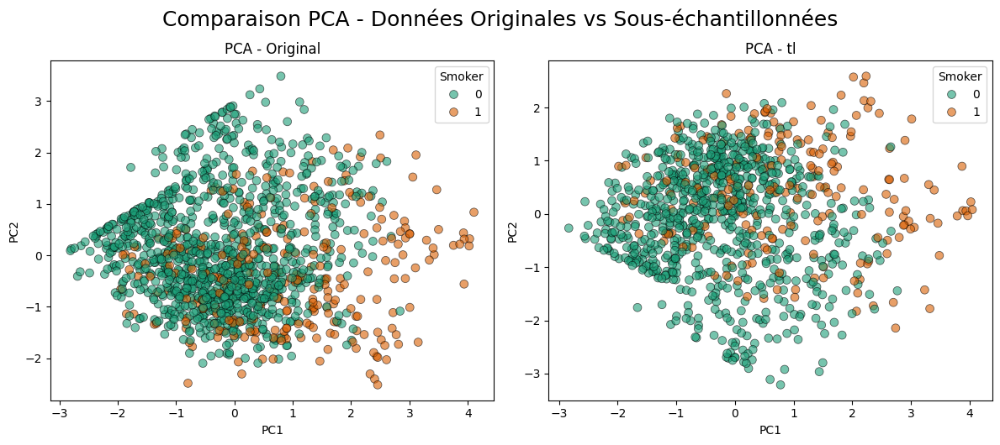


####### COMPARAISON PERFORMANCE - MÉTHODE : TL #######
=== Entraînement sur données sous-échantillonnées ===
Accuracy :  0.9777777777777777


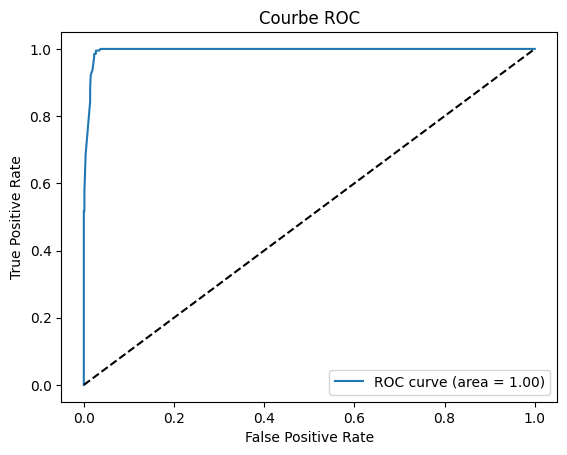

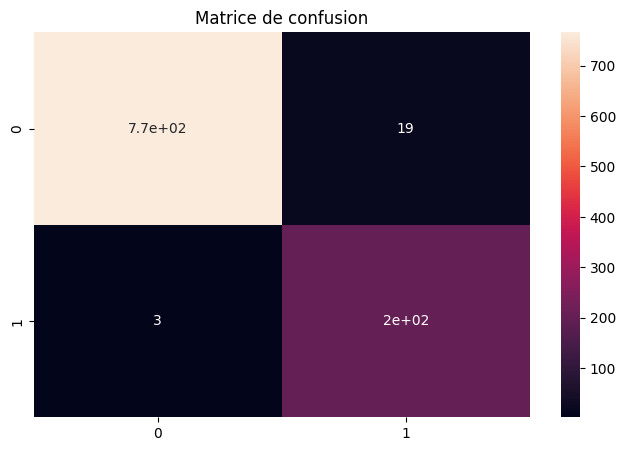

              precision    recall  f1-score   support

           0       1.00      0.98      0.99       785
           1       0.91      0.99      0.95       205

    accuracy                           0.98       990
   macro avg       0.96      0.98      0.97       990
weighted avg       0.98      0.98      0.98       990


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


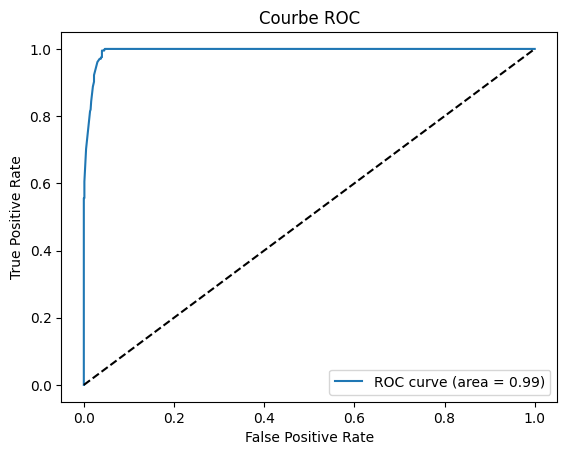

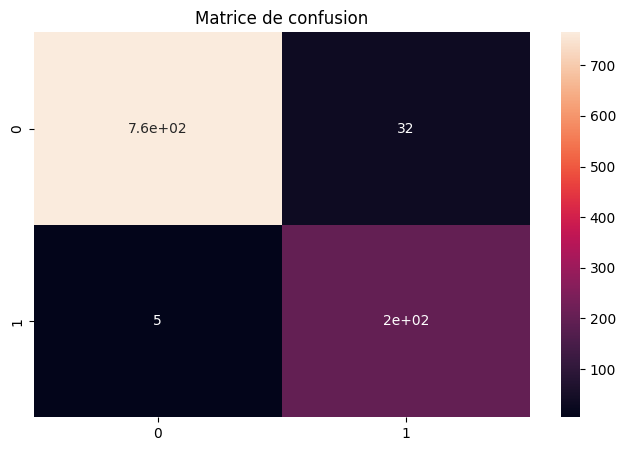

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



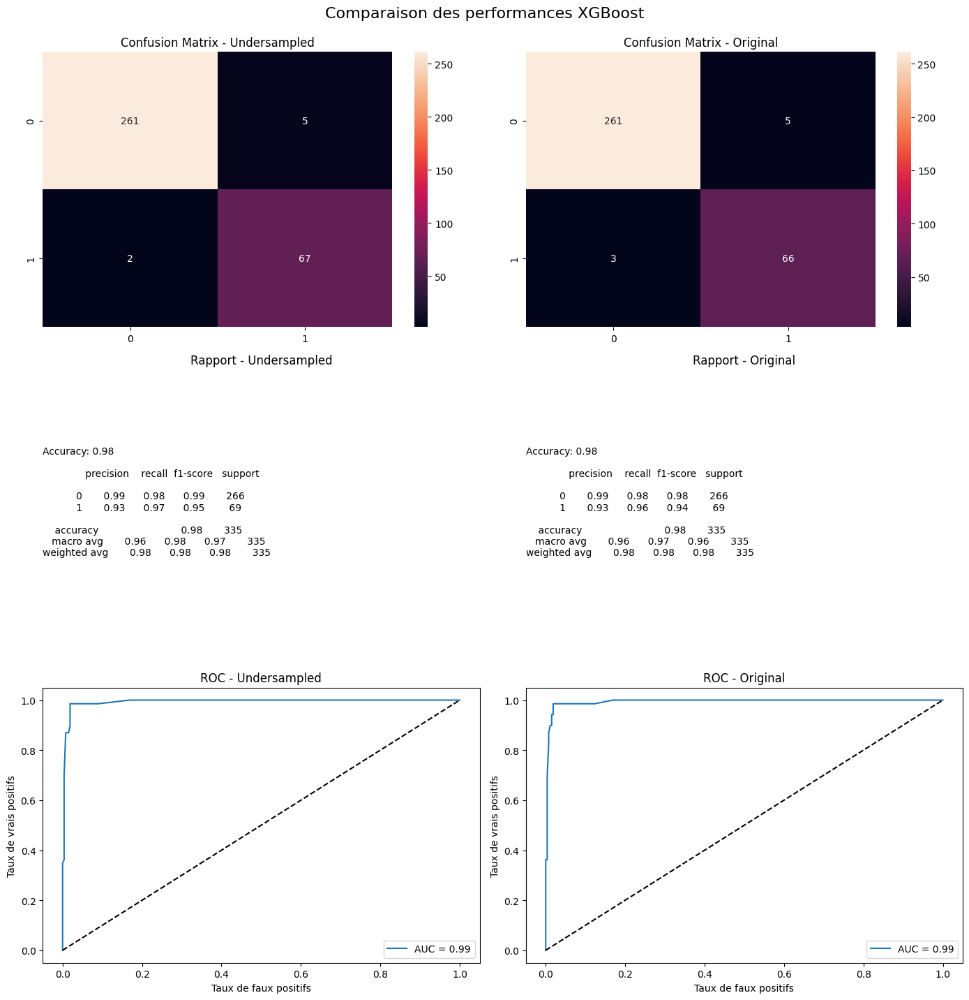

In [374]:
resampled_data_dict = {}

for undersampler in undersampler_dict.keys():
    print("Méthode d'under-sampling : ", undersampler)
    
    # Resampling des données
    X_resampled, y_resampled = undersampler_dict[undersampler].fit_resample(X_train, y_train)

    # Conversion en DataFrame si nécessaire
    if not isinstance(X_resampled, pd.DataFrame):
        X_resampled = pd.DataFrame(X_resampled, columns=X.columns)

    if isinstance(y_resampled, pd.DataFrame):
        y_resampled = y_resampled.iloc[:, 0]
    else:
        y_resampled = pd.Series(y_resampled, name='smoker')
    
    data_resampled = pd.concat([X_resampled, y_resampled], axis=1)

    # Sauvegarde pour éventuelle réutilisation
    resampled_data_dict[undersampler] = data_resampled
    
    # Visualisation comparative
    compare_smoker_distribution(data, data_resampled, title_suffix=f"({undersampler})", p=1)
    compare_pca_oversampling(data, {undersampler: data_resampled}, p=1)

    # Comparaison de performance tout de suite après la visualisation
    print(f"\n####### COMPARAISON PERFORMANCE - MÉTHODE : {undersampler.upper()} #######")
    X_train_resampled = data_resampled.drop(columns='smoker')
    y_train_resampled = data_resampled['smoker']

    compare_xgboost_performance(
        X_train_orig=X_train, y_train_orig=y_train,
        X_train_res=X_train_resampled, y_train_res=y_train_resampled,
        X_test=X_test, y_test=y_test, p=1
    )


# Optimisation

## le meilleur modele est le Naives bayes avec le ADAsync

Accuracy :  0.9327044025157233


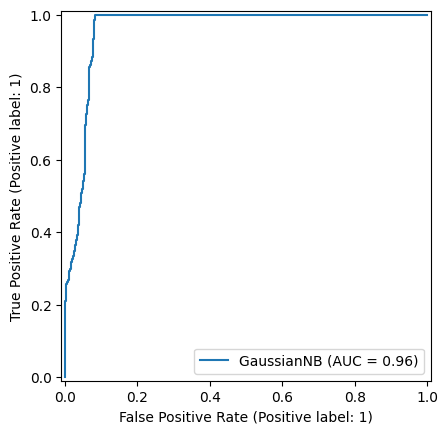

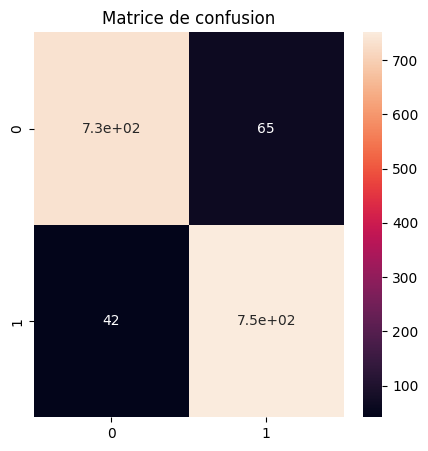

              precision    recall  f1-score   support

           0       0.95      0.92      0.93       797
           1       0.92      0.95      0.93       793

    accuracy                           0.93      1590
   macro avg       0.93      0.93      0.93      1590
weighted avg       0.93      0.93      0.93      1590



In [375]:
# ressortie du modele
# Resampling des données
X_resampled, y_resampled = oversampler_dict["adasyn"].fit_resample(X_train, y_train)

# Conversion en DataFrame si nécessaire
if not isinstance(X_resampled, pd.DataFrame):
    X_resampled = pd.DataFrame(X_resampled, columns=X.columns)
if isinstance(y_resampled, pd.DataFrame):
    y_resampled = y_resampled.iloc[:, 0]
else:
    y_resampled = pd.Series(y_resampled, name='smoker')

data_resampled = pd.concat([X_resampled, y_resampled], axis=1)
# Sauvegarde pour éventuelle réutilisation
resampled_data_dict[undersampler] = data_resampled

X_train_resampled = data_resampled.drop(columns='smoker')
y_train_resampled = data_resampled['smoker']

# Entrainement du modele
naives_bayes_model = naives_bayes_train(X_train=X_train_resampled, y_train=y_train_resampled)

=== Évaluation sur le jeu de test ===
Accuracy : 0.96

=== Rapport de classification ===
              precision    recall  f1-score   support

           0       0.99      0.95      0.97       266
           1       0.85      0.96      0.90        69

    accuracy                           0.96       335
   macro avg       0.92      0.96      0.93       335
weighted avg       0.96      0.96      0.96       335



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


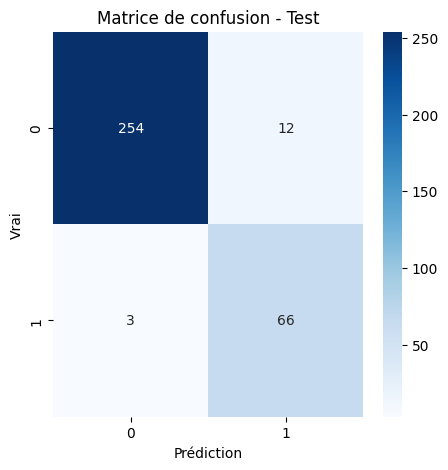

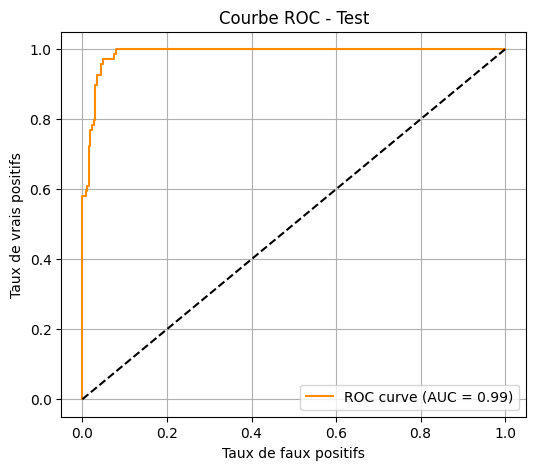

In [376]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_curve, auc
import matplotlib.pyplot as plt
import seaborn as sns

# Prédictions
ypredict_test = naives_bayes_model.predict(X_test)

# courbe ROC
yproba_test = naives_bayes_model.predict_proba(X_test)[:, 1]

#  Métriques 
acc = accuracy_score(y_test, ypredict_test)
conf = confusion_matrix(y_test, ypredict_test)
fpr, tpr, _ = roc_curve(y_test, yproba_test)
roc_auc = auc(fpr, tpr)

print("=== Évaluation sur le jeu de test ===")
print(f"Accuracy : {acc:.2f}\n")
print("=== Rapport de classification ===")
print(classification_report(y_test, ypredict_test))

# Matrice de confusion
plt.figure(figsize=(5, 5))
sns.heatmap(conf, annot=True, fmt='d', cmap="Blues")
plt.title("Matrice de confusion - Test")
plt.xlabel("Prédiction")
plt.ylabel("Vrai")
plt.show()

# Courbe ROC
plt.figure(figsize=(6, 5))
plt.plot(fpr, tpr, label=f"ROC curve (AUC = {roc_auc:.2f})", color='darkorange')
plt.plot([0, 1], [0, 1], 'k--')
plt.title("Courbe ROC - Test")
plt.xlabel("Taux de faux positifs")
plt.ylabel("Taux de vrais positifs")
plt.legend(loc="lower right")
plt.grid(True)
plt.show()


Fold :  1
Accuracy :  0.933288409703504


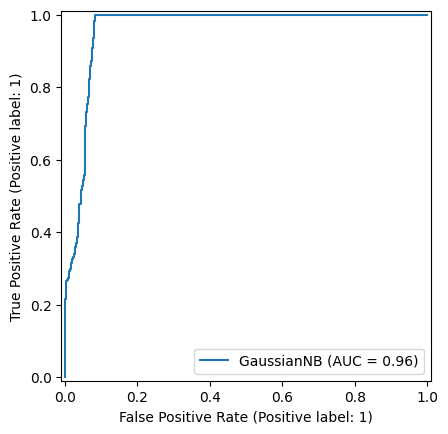

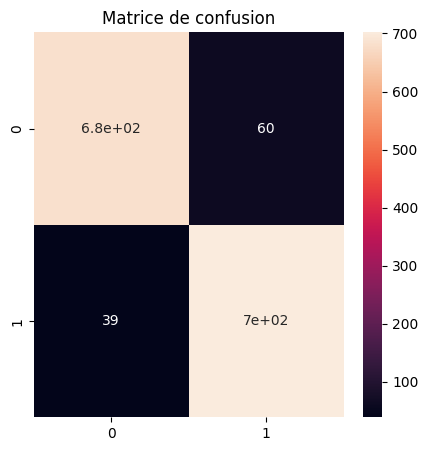

              precision    recall  f1-score   support

           0       0.95      0.92      0.93       743
           1       0.92      0.95      0.93       741

    accuracy                           0.93      1484
   macro avg       0.93      0.93      0.93      1484
weighted avg       0.93      0.93      0.93      1484

Fold 01 - Accuracy : 92.45%

Fold :  2
Accuracy :  0.9319407008086253


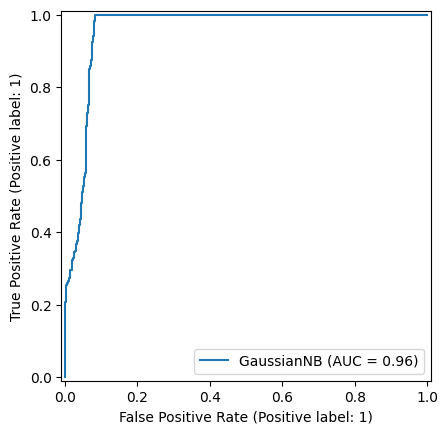

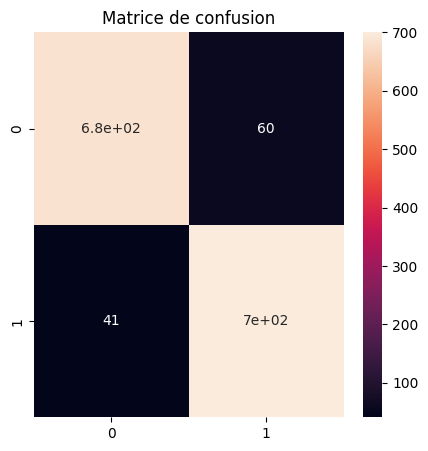

              precision    recall  f1-score   support

           0       0.94      0.92      0.93       743
           1       0.92      0.94      0.93       741

    accuracy                           0.93      1484
   macro avg       0.93      0.93      0.93      1484
weighted avg       0.93      0.93      0.93      1484

Fold 02 - Accuracy : 94.34%

Fold :  3
Accuracy :  0.9319407008086253


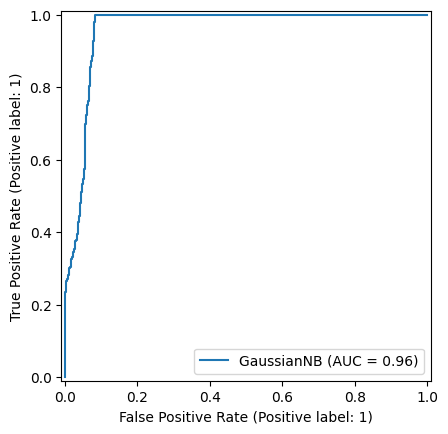

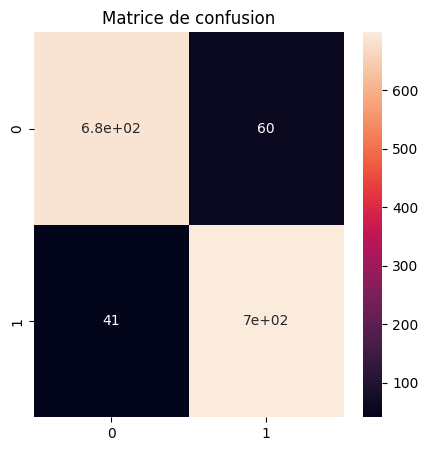

              precision    recall  f1-score   support

           0       0.94      0.92      0.93       744
           1       0.92      0.94      0.93       740

    accuracy                           0.93      1484
   macro avg       0.93      0.93      0.93      1484
weighted avg       0.93      0.93      0.93      1484

Fold 03 - Accuracy : 93.40%

Fold :  4
Accuracy :  0.9305929919137467


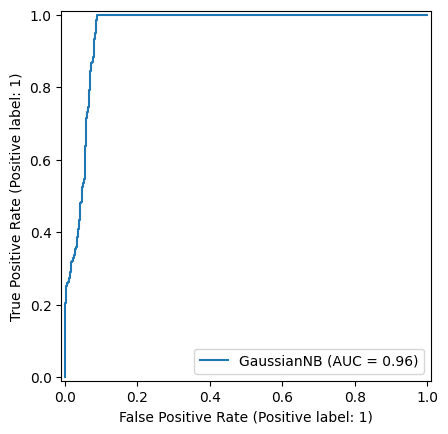

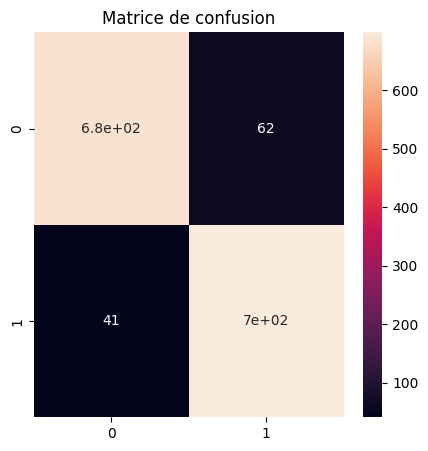

              precision    recall  f1-score   support

           0       0.94      0.92      0.93       744
           1       0.92      0.94      0.93       740

    accuracy                           0.93      1484
   macro avg       0.93      0.93      0.93      1484
weighted avg       0.93      0.93      0.93      1484

Fold 04 - Accuracy : 97.17%

Fold :  5
Accuracy :  0.9359838274932615


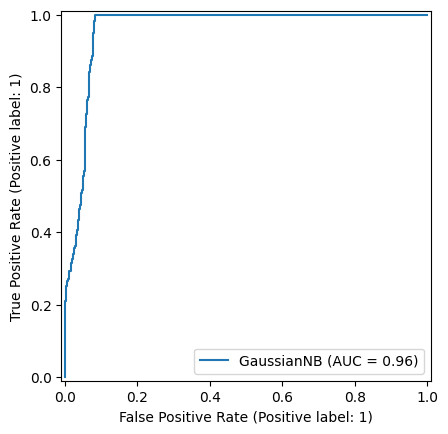

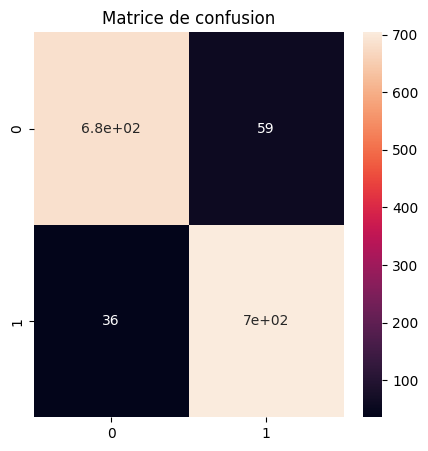

              precision    recall  f1-score   support

           0       0.95      0.92      0.94       744
           1       0.92      0.95      0.94       740

    accuracy                           0.94      1484
   macro avg       0.94      0.94      0.94      1484
weighted avg       0.94      0.94      0.94      1484

Fold 05 - Accuracy : 92.45%

Fold :  6
Accuracy :  0.9319407008086253


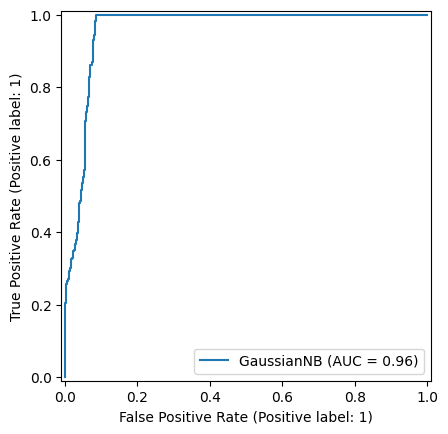

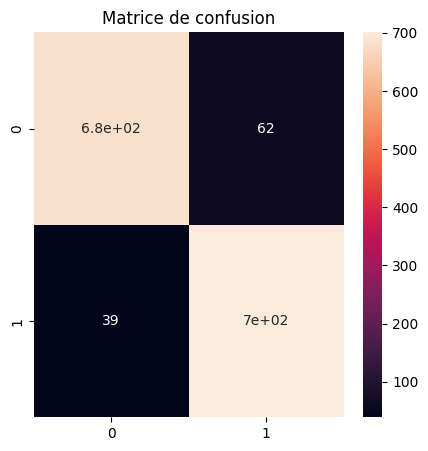

              precision    recall  f1-score   support

           0       0.95      0.92      0.93       744
           1       0.92      0.95      0.93       740

    accuracy                           0.93      1484
   macro avg       0.93      0.93      0.93      1484
weighted avg       0.93      0.93      0.93      1484

Fold 06 - Accuracy : 94.34%

Fold :  7
Accuracy :  0.9346361185983828


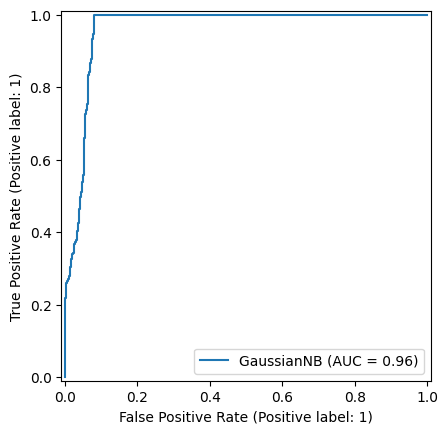

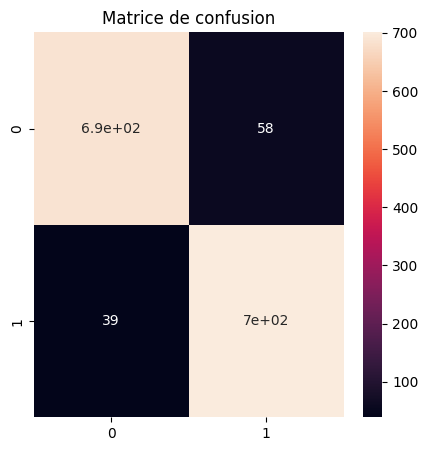

              precision    recall  f1-score   support

           0       0.95      0.92      0.93       744
           1       0.92      0.95      0.94       740

    accuracy                           0.93      1484
   macro avg       0.93      0.93      0.93      1484
weighted avg       0.93      0.93      0.93      1484

Fold 07 - Accuracy : 92.45%

Fold :  8
Accuracy :  0.9346361185983828


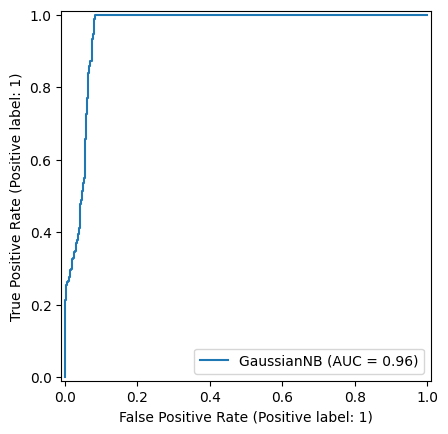

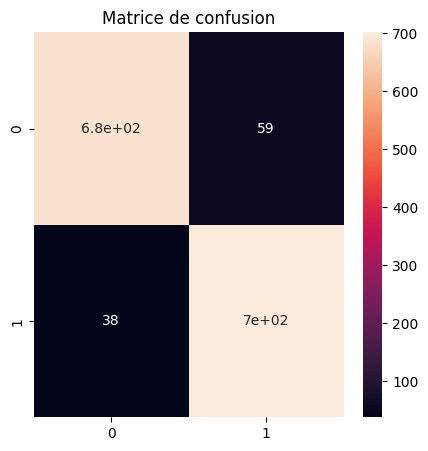

              precision    recall  f1-score   support

           0       0.95      0.92      0.93       744
           1       0.92      0.95      0.94       740

    accuracy                           0.93      1484
   macro avg       0.93      0.93      0.93      1484
weighted avg       0.93      0.93      0.93      1484

Fold 08 - Accuracy : 90.57%

Fold :  9
Accuracy :  0.933288409703504


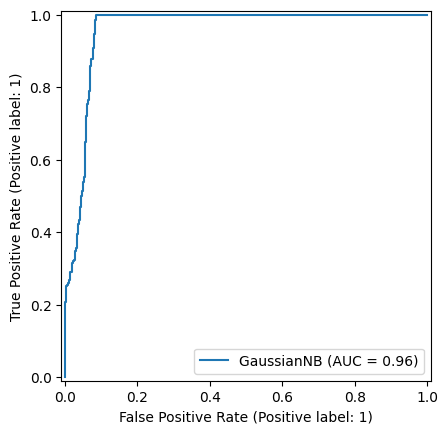

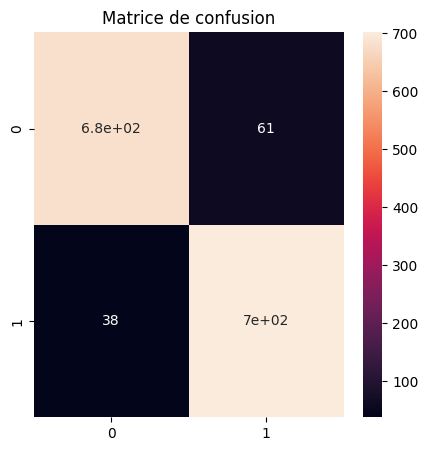

              precision    recall  f1-score   support

           0       0.95      0.92      0.93       744
           1       0.92      0.95      0.93       740

    accuracy                           0.93      1484
   macro avg       0.93      0.93      0.93      1484
weighted avg       0.93      0.93      0.93      1484

Fold 09 - Accuracy : 94.34%

Fold :  10
Accuracy :  0.9319407008086253


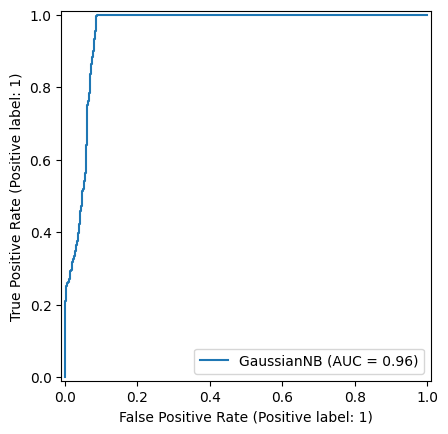

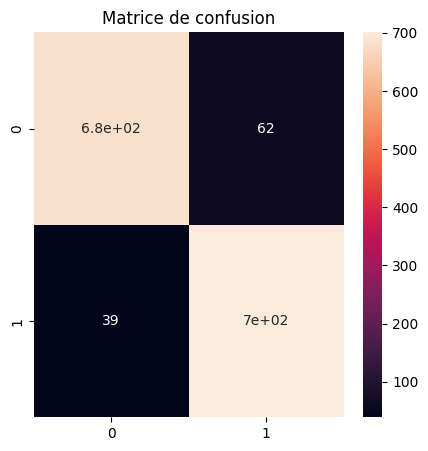

              precision    recall  f1-score   support

           0       0.95      0.92      0.93       744
           1       0.92      0.95      0.93       740

    accuracy                           0.93      1484
   macro avg       0.93      0.93      0.93      1484
weighted avg       0.93      0.93      0.93      1484

Fold 10 - Accuracy : 95.28%

Fold :  11
Accuracy :  0.9346361185983828


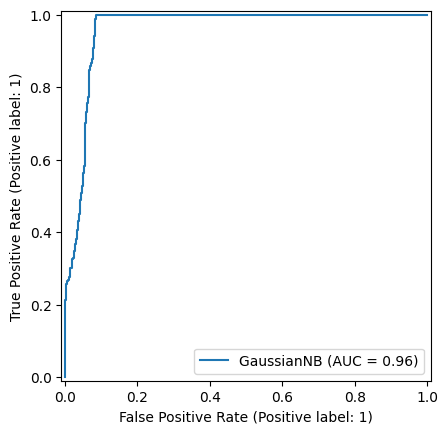

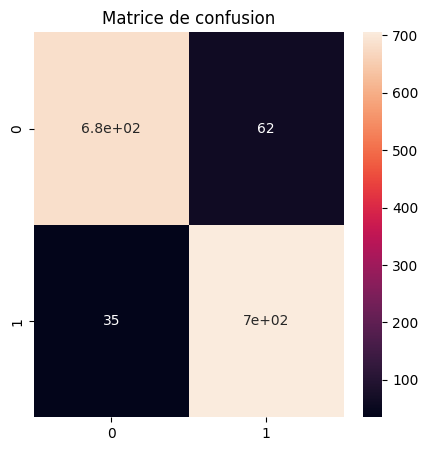

              precision    recall  f1-score   support

           0       0.95      0.92      0.93       744
           1       0.92      0.95      0.94       740

    accuracy                           0.93      1484
   macro avg       0.94      0.93      0.93      1484
weighted avg       0.94      0.93      0.93      1484

Fold 11 - Accuracy : 89.62%

Fold :  12
Accuracy :  0.933288409703504


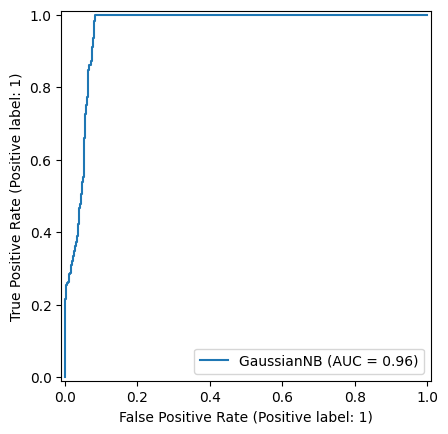

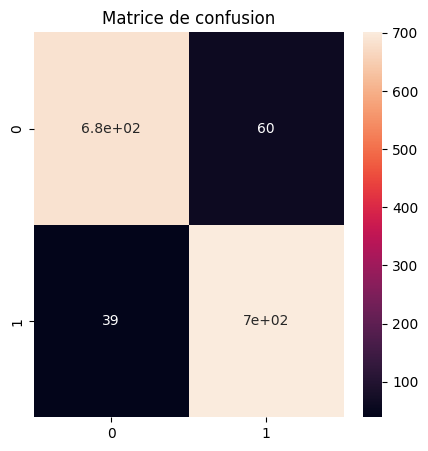

              precision    recall  f1-score   support

           0       0.95      0.92      0.93       744
           1       0.92      0.95      0.93       740

    accuracy                           0.93      1484
   macro avg       0.93      0.93      0.93      1484
weighted avg       0.93      0.93      0.93      1484

Fold 12 - Accuracy : 93.40%

Fold :  13
Accuracy :  0.9326145552560647


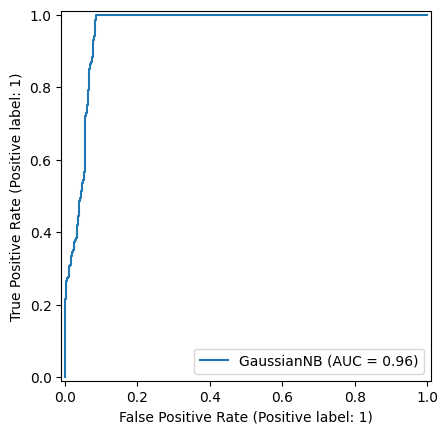

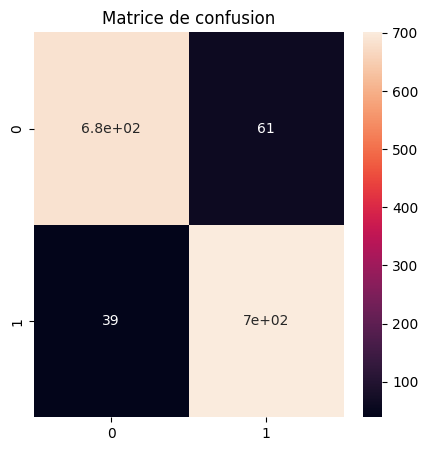

              precision    recall  f1-score   support

           0       0.95      0.92      0.93       744
           1       0.92      0.95      0.93       740

    accuracy                           0.93      1484
   macro avg       0.93      0.93      0.93      1484
weighted avg       0.93      0.93      0.93      1484

Fold 13 - Accuracy : 95.28%

Fold :  14
Accuracy :  0.9353099730458221


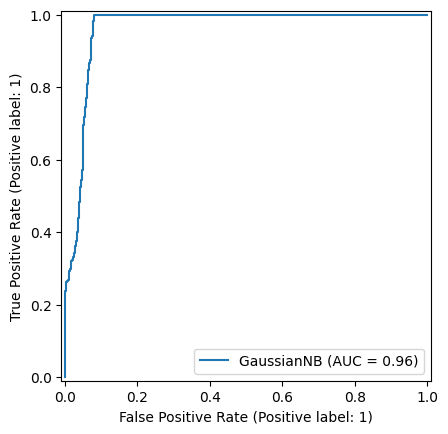

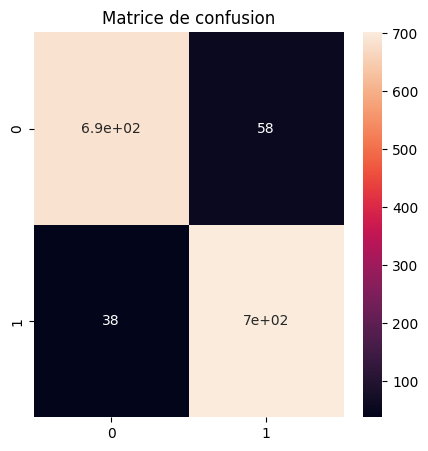

              precision    recall  f1-score   support

           0       0.95      0.92      0.93       744
           1       0.92      0.95      0.94       740

    accuracy                           0.94      1484
   macro avg       0.94      0.94      0.94      1484
weighted avg       0.94      0.94      0.94      1484

Fold 14 - Accuracy : 90.57%

Fold :  15
Accuracy :  0.9326145552560647


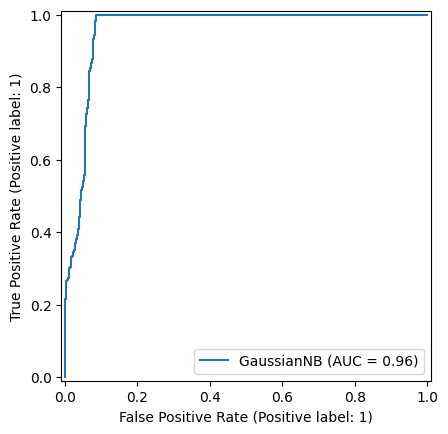

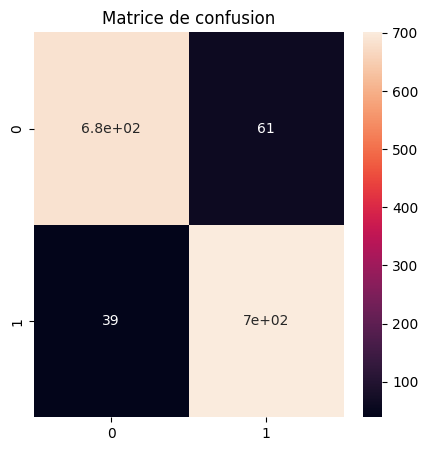

              precision    recall  f1-score   support

           0       0.95      0.92      0.93       744
           1       0.92      0.95      0.93       740

    accuracy                           0.93      1484
   macro avg       0.93      0.93      0.93      1484
weighted avg       0.93      0.93      0.93      1484

Fold 15 - Accuracy : 93.40%


Fold défectueux : fold_10


In [377]:
from sklearn.model_selection import StratifiedKFold

# Initialisation
skf = StratifiedKFold(n_splits=15, shuffle=True, random_state=42) # version alternative du cross validation pour gerer les cas de classe desequilibree (creation de fold avec une repartition adequates des targer )
low_accuracy_folds = []
problematic_folds_dict = {}

fold_accuracies = []
k = 1

# Boucle sur les folds
for fold_idx, (train_idx, val_idx) in enumerate(skf.split(X_train_resampled, y_train_resampled)):
    X_fold_train = X_train_resampled.iloc[train_idx]
    y_fold_train = y_train_resampled.iloc[train_idx]
    X_fold_val = X_train_resampled.iloc[val_idx]
    y_fold_val = y_train_resampled.iloc[val_idx]

    # Entraînement
    print('Fold : ', k)
    model = naives_bayes_train(X_fold_train, y_fold_train)
    y_pred = model.predict(X_fold_val)

    acc = accuracy_score(y_fold_val, y_pred)
    fold_accuracies.append(acc)
    
    print(f"Fold {fold_idx + 1:02d} - Accuracy : {acc:.2%}")

    # Si accuracy < 90%, stocker les infos
    if acc < 0.9:
        low_accuracy_folds.append({
            "fold_index": fold_idx,
            "accuracy": acc,
            "indices": val_idx.tolist()
        })

        problematic_folds_dict[f"fold_{fold_idx}"] = {
            "X": X_fold_val.copy(),
            "y": y_fold_val.copy()
        }
    k += 1
    print("=" * 10)
    print()

# Extraction des folds défectueux sous forme de DataFrame
def extraire_folds_defectueux(problematic_folds_dict, X_train_resampled, y_train_resampled):
    # Dictionnaire pour stocker les DataFrames des folds défectueux
    defective_folds_df = {}

    for fold_name, data in problematic_folds_dict.items():
        indices = data["X"].index  # Les indices du fold défectueux
        X_defective = X_train_resampled.iloc[indices]
        y_defective = y_train_resampled.iloc[indices]

        # On crée un DataFrame combiné
        df_defective = pd.concat([X_defective, y_defective], axis=1)
        defective_folds_df[fold_name] = df_defective

    return defective_folds_df

# Appel de la fonction pour obtenir les folds défectueux sous forme de DataFrame
defective_folds_df = extraire_folds_defectueux(problematic_folds_dict, X_train_resampled, y_train_resampled)

# Exemple d'affichage d'un des DataFrame extraits
for fold_name, df in defective_folds_df.items():
    print(f"\nFold défectueux : {fold_name}")

In [384]:
# Fonction pour charger les folds défectueux
def load_defective_folds(folds_dict, fold_indices):
    # Si fold_indices est une seule valeur, on le transforme en liste pour uniformité
    if not isinstance(fold_indices, list):
        fold_indices = [fold_indices]

    # Liste pour stocker les DataFrames des folds défectueux
    defective_folds = []

    for idx in fold_indices:
        fold_name = f"fold_{idx}"  # Nom du fold
        df_fold = folds_dict.get(fold_name)
        
        if df_fold is not None:
            print(f"Le fold {fold_name} a été chargé avec succès.")
            defective_folds.append(df_fold)
        else:
            print(f"Aucun fold trouvé avec le nom {fold_name}.")
    
    # Retourner un seul DataFrame si un seul fold est chargé, sinon une liste de DataFrames
    return defective_folds[0] if len(defective_folds) == 1 else defective_folds

In [385]:
# Charger un seul fold défectueux
fold_10 = load_defective_folds(defective_folds_df, 10)

Le fold fold_10 a été chargé avec succès.


In [386]:
fold_10.head()

,age,sex,bmi,children,region,charges,smoker
2,-0.734786,-1.001998,-1.474072,-0.909006,-0.637615,0.224123,1
4,-0.806651,0.998006,-0.237121,0.735080,-0.637615,-0.744925,0
22,0.055728,-1.001998,0.349638,0.735080,-0.637615,2.206531,1
35,0.774377,0.998006,0.270346,0.735080,-0.581340,-0.314043,0
39,0.846241,-1.001998,-2.108406,-0.909006,-0.637615,-0.312893,0


In [387]:
fold_10.age.value_counts()

age
-1.453435    6
-1.525300    6
 0.558782    4
-0.734786    4
-0.950381    3
            ..
-0.335364    1
-0.506282    1
-0.812633    1
 0.644482    1
 0.918106    1
Name: count, Length: 71, dtype: int64

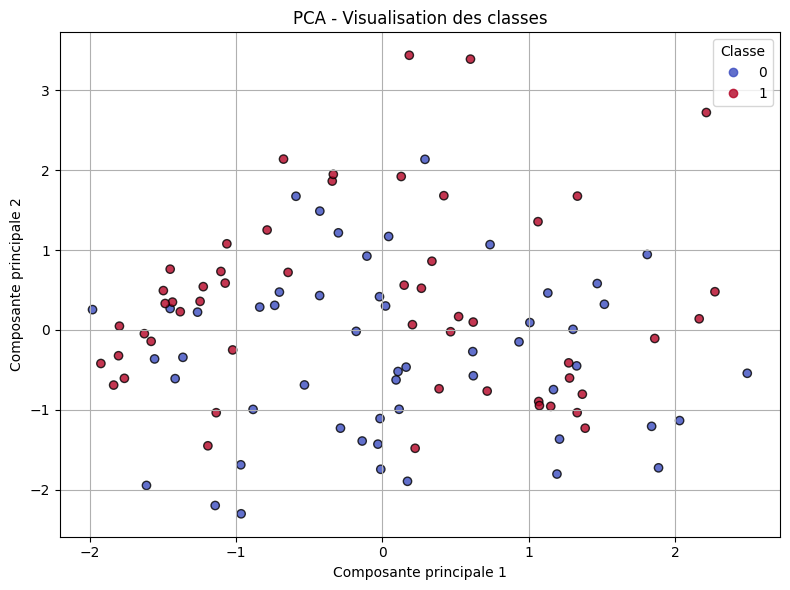

In [381]:
# visualisation des classes dans le fold
from sklearn.decomposition import PCA
# Séparation des caractéristiques (X) et de la cible (y)
X_new = df.drop(columns=["smoker"])
y_new = df["smoker"]

# Réduction de dimension avec PCA (2 composantes principales)
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_new)

# Visualisation avec scatter plot
plt.figure(figsize=(8, 6))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y_new, cmap="coolwarm", alpha=0.8, edgecolor='k')
plt.title("PCA - Visualisation des classes")
plt.xlabel("Composante principale 1")
plt.ylabel("Composante principale 2")
plt.grid(True)
plt.legend(*scatter.legend_elements(), title="Classe")
plt.tight_layout()
plt.show()